<a href="https://colab.research.google.com/github/Slautin/2023_Colabs_RT_data_sharing/blob/main/1_pureVAE_card_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#VAE model: card dataset

February 2025

Supporting codes for the manuscript: **Integrating Predictive and Generative Capabilities by Latent Space Design via the DKL-VAE model**

*Notebook 1 of 3*

This Notebook presents an analysis of the latent space structure learned by a Variational Autoencoder (VAE) trained on both the complete card suit dataset and a subset of it.

* Author [Boris Slautin](https://scholar.google.com/citations?hl=ru&view_op=list_works&gmla=AH70aAU_JtxEIQgg_RTLPnUSZHKp1J1iDrJUxTZ7Dzw5p5jEtCEug5zMWLCh4A-pe5ekW_9a_aXHOSIjEp-2UT_kypL9DfD7GcD76qEpeOzSkAibBjmm_7RL&user=Y2AXABsAAAAJ)

* [Pyroved](https://pyroved.readthedocs.io/en/latest/) package by [Maxim Ziatdinov](https://scholar.google.com/citations?user=YnSdOoUAAAAJ&hl=en)

* Project lead and supervision by [Sergei V. Kalinin](https://scholar.google.com/citations?hl=en&user=-cuxoSQAAAAJ&view_op=list_works&sortby=pubdate)


In [1]:
!pip install git+https://github.com/ziatdinovmax/pyroved.git;
!pip install -q kornia;

  Cloning https://github.com/ziatdinovmax/pyroved.git to /tmp/pip-req-build-4ihk1qnp
  Running command git clone --filter=blob:none --quiet https://github.com/ziatdinovmax/pyroved.git /tmp/pip-req-build-4ihk1qnp
  Resolved https://github.com/ziatdinovmax/pyroved.git to commit 7807ffb1cb415b3cc76c1e02d52465a8ae0eeae4
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 36.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 109.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 37.3 MB/s eta 0:00:00
 

In [2]:
import math
import numpy as np

# from typing import Tuple, List, Union, Optional, Dict, Type, Callable

#import pyro
# import pyro.distributions as dist
# import pyro.optim as optim
# import pyro.infer as infer

import torch
import torch.nn as nn
import kornia as K


import cv2
# import h5py

import pyroved as pv

import matplotlib.pyplot as plt
# import matplotlib.patches as patches
# from matplotlib.gridspec import GridSpec
# import matplotlib.colors as mcolors


tt = torch.tensor

In [3]:
#arbitrary functions
resize = lambda x: cv2.resize(x, (64, 64), cv2.INTER_CUBIC)

def get_data():
    card1 = resize(cv2.imread("cards/card1.JPG", cv2.IMREAD_GRAYSCALE))
    card2 = resize(cv2.imread("cards/card2.JPG", cv2.IMREAD_GRAYSCALE))
    card3 = resize(cv2.imread("cards/card3.JPG", cv2.IMREAD_GRAYSCALE))
    card4 = resize(cv2.imread("cards/card4.JPG", cv2.IMREAD_GRAYSCALE))
    card1 = tt(1 - card1 / card1.max())
    card2 = tt(1 - card2 / card2.max())
    card3 = tt(1 - card3 / card3.max())
    card4 = tt(1 - card4 / card4.max())
    return card1, card2, card3, card4

def transform_imgs(cards, **kwargs):
    np.random.seed(0)
    torch.manual_seed(0)

    a = kwargs.get("angle")
    t = kwargs.get("translation")
    s = (kwargs.get("shear"))
    if s is not None:
        s = math.radians(s)


    n_samples = kwargs.get("samples", 3000)
    n_samples_total = n_samples*4

    card1, card2, card3, card4 = cards[0], cards[1], cards[2], cards[3]

    card1 = card1[None, None].repeat_interleave(n_samples, dim = 0)
    card2 = card2[None, None].repeat_interleave(n_samples, dim = 0)
    card3 = card3[None, None].repeat_interleave(n_samples, dim = 0)
    card4 = card4[None, None].repeat_interleave(n_samples, dim = 0)

    cards_all = torch.cat((card1, card2, card3, card4), dim = 0)

    angles = tt(np.random.uniform(low = -a, high = a, size = [n_samples_total]))
    translations = tt(np.random.uniform(low = -t, high = t, size = [n_samples_total,1])).repeat_interleave(2, dim = 1)
    shears = tt(np.random.uniform(low = -s, high = s, size = [n_samples_total, 1])).repeat_interleave(2, dim = 1)

    transform = nn.Sequential(
        K.augmentation.CenterCrop((48, 48)),
        K.geometry.Affine(angle = angles, translation = translations,
                          shear = shears)
    )

    cards = transform(cards_all).squeeze().float()
    labels = torch.cat([torch.zeros(len(card1)), torch.ones(len(card2)),
                           2*torch.ones(len(card3)), 3*torch.ones(len(card4))])
    return cards, labels, angles, translations, shears

# Step 1: Import and Preprocess the Card Suit Dataset

In [4]:
# Download the cards dataset
!gdown -q https://drive.google.com/uc?id=1AyGHVflbIjzinkKBURHNVDx1wWg9JixB
!unzip -o -qq cards.zip

In [5]:
#@title Helper functions that apply afffine transformations to the dataset
rs = lambda x: cv2.resize(x, (64, 64), cv2.INTER_CUBIC)

def get_data():
    card1 = rs(cv2.imread("cards/card1.JPG", cv2.IMREAD_GRAYSCALE))
    card2 = rs(cv2.imread("cards/card2.JPG", cv2.IMREAD_GRAYSCALE))
    card3 = rs(cv2.imread("cards/card3.JPG", cv2.IMREAD_GRAYSCALE))
    card4 = rs(cv2.imread("cards/card4.JPG", cv2.IMREAD_GRAYSCALE))
    card1 = tt(1 - card1 / card1.max())
    card2 = tt(1 - card2 / card2.max())
    card3 = tt(1 - card3 / card3.max())
    card4 = tt(1 - card4 / card4.max())
    return card1, card2, card3, card4


import math
def transform_imgs(cards, **kwargs):
    np.random.seed(0)
    torch.manual_seed(0)

    a = kwargs.get("angle")
    t = kwargs.get("translation")
    s = (kwargs.get("shear"))
    if s is not None:
        s = math.radians(s)


    n_samples = kwargs.get("samples", 3000)
    n_samples_total = n_samples*4

    card1, card2, card3, card4 = cards[0], cards[1], cards[2], cards[3]

    card1 = card1[None, None].repeat_interleave(n_samples, dim = 0)
    card2 = card2[None, None].repeat_interleave(n_samples, dim = 0)
    card3 = card3[None, None].repeat_interleave(n_samples, dim = 0)
    card4 = card4[None, None].repeat_interleave(n_samples, dim = 0)

    cards_all = torch.cat((card1, card2, card3, card4), dim = 0)

    angles = tt(np.random.uniform(low = -a, high = a, size = [n_samples_total]))
    translations = tt(np.random.uniform(low = -t, high = t, size = [n_samples_total,1])).repeat_interleave(2, dim = 1)
    shears = tt(np.random.uniform(low = -s, high = s, size = [n_samples_total, 1])).repeat_interleave(2, dim = 1)

    transform = nn.Sequential(
        K.augmentation.CenterCrop((48, 48)),
        K.geometry.Affine(angle = angles, translation = translations,
                          shear = shears)
    )

    cards = transform(cards_all).squeeze().float()
    labels = torch.cat([torch.zeros(len(card1)), torch.ones(len(card2)),
                           2*torch.ones(len(card3)), 3*torch.ones(len(card4))])
    return cards, labels, angles, translations, shears


def plot_manifolds(model):
    fig, axes = plt.subplots(2, 2, figsize=(12, 12),
                            subplot_kw={'xticks':[], 'yticks':[]},
                            gridspec_kw=dict(hspace=0.1, wspace=0.05))
    for i, ax in enumerate(axes.flat):
        manifold = model.manifold2d(d=9, label=i, plot=False)
        grid = make_grid(manifold[:, None], nrow=9, pad_value=.5)
        ax.imshow(grid[0], cmap='viridis')
    plt.show()


def rearrange_manifold(dat):
  grid_size = int(np.sqrt(dat.shape[0]))  # 10 x 10 grid for 100 slices
  rows = grid_size * dat.shape[1]  # 10 * 48 = 480
  cols = grid_size * dat.shape[2]  # 10 * 48 = 480

  # Rearrange into 2D grid
  rearranged = (dat.reshape(grid_size, grid_size, dat.shape[1], dat.shape[2])
                .permute(0, 2, 1, 3)  # Rearrange axes for proper stacking
                .reshape(rows, cols))  # Combine into 2D array

  # Convert to NumPy array
  rearranged_np = rearranged.numpy()
  return rearranged_np

In [6]:
#@title functions for saving data

def convert_to_supported_dtype(arr):
    # Check if array has an object dtype
    if arr.dtype == np.dtype('O'):
        # Attempt conversion to a compatible type (if possible)
        try:
            return arr.astype(np.float64)  # Change to a compatible type (e.g., float)
        except ValueError:
            raise ValueError(f"Cannot convert array '{arr}' to a supported dtype.")
    return arr

def save_dict_to_hdf5(file_path, data_dict):
    def save_data(group, data):
        for key, value in data.items():
            if isinstance(value, dict):
                subgroup = group.create_group(key)
                save_data(subgroup, value)
            elif isinstance(value, np.ndarray):
                # Check and convert object dtype arrays if needed
                value = convert_to_supported_dtype(value)
                group.create_dataset(key, data=value)
            else:
                group.create_dataset(key, data=value)
    with h5py.File(file_path, 'w') as f:
        save_data(f, data_dict)

def load_hdf5_to_dict(file_path):
    def load_data(group):
        data = {}
        for key, item in group.items():
            if isinstance(item, h5py.Group):
                data[key] = load_data(item)
            else:
                data[key] = np.array(item)
        return data

    with h5py.File(file_path, 'r') as f:
        data_dict = load_data(f)

    return data_dict

In [7]:
cards = get_data()
cards_all, labels_all, angles_all, translations_all, shears_all = transform_imgs(cards, angle = 30, translation = 0.1, shear = 10, samples = 750)

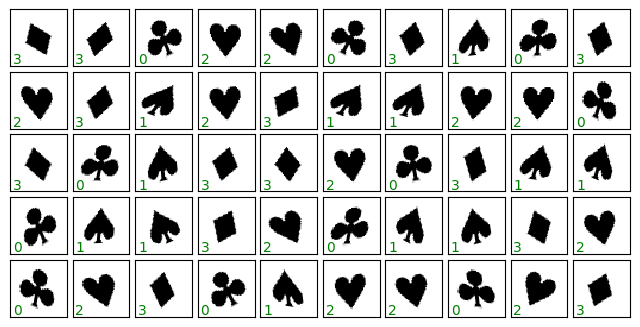

In [8]:
#examples of the card suits
fig, axes = plt.subplots(5, 10, figsize=(8, 4),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

indd = np.random.choice(np.arange(len(cards_all)), size=150, replace=False)

for ax, im, lbv in zip(axes.flat, cards_all[indd], labels_all[indd]):
    ax.imshow(im.squeeze(), cmap='binary', interpolation='nearest')
    ax.text(0.05, 0.05, str(int(lbv)),
            transform=ax.transAxes, color='green')

#2. Train the VAE model on the full dataset

In [9]:
ws = 48
data_dim = (ws, ws)

model = pv.models.iVAE(data_dim, 2)
trainer = pv.trainers.SVItrainer(model)
dataloader = pv.utils.init_dataloader(cards_all.reshape(-1, ws* ws), batch_size=100)

Epoch: 1 Training loss: 943.4479
Epoch: 2 Training loss: 413.2000
Epoch: 3 Training loss: 394.2762
Epoch: 4 Training loss: 387.9524
Epoch: 5 Training loss: 382.4384
Epoch: 6 Training loss: 375.0119
Epoch: 7 Training loss: 360.2709
Epoch: 8 Training loss: 343.9494
Epoch: 9 Training loss: 335.2963
Epoch: 10 Training loss: 330.2037
Epoch: 11 Training loss: 326.0945
Epoch: 12 Training loss: 320.1950
Epoch: 13 Training loss: 310.3888
Epoch: 14 Training loss: 296.4157
Epoch: 15 Training loss: 286.9546
Epoch: 16 Training loss: 280.8943
Epoch: 17 Training loss: 276.0515
Epoch: 18 Training loss: 272.3756
Epoch: 19 Training loss: 267.9978
Epoch: 20 Training loss: 262.9330
Epoch: 21 Training loss: 255.4838
Epoch: 22 Training loss: 246.2793
Epoch: 23 Training loss: 237.3503
Epoch: 24 Training loss: 229.3412
Epoch: 25 Training loss: 222.7722
Epoch: 26 Training loss: 217.1199
Epoch: 27 Training loss: 212.3205
Epoch: 28 Training loss: 208.2237
Epoch: 29 Training loss: 204.2622
Epoch: 30 Training loss

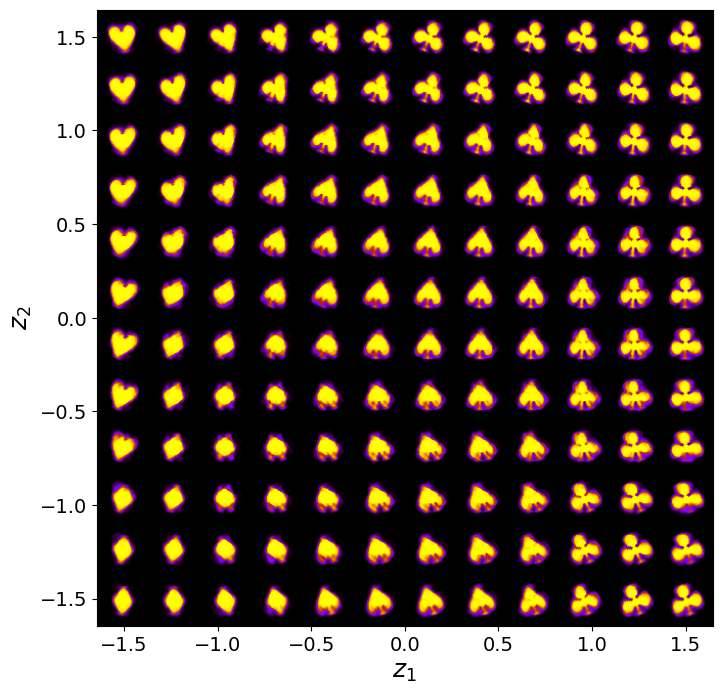

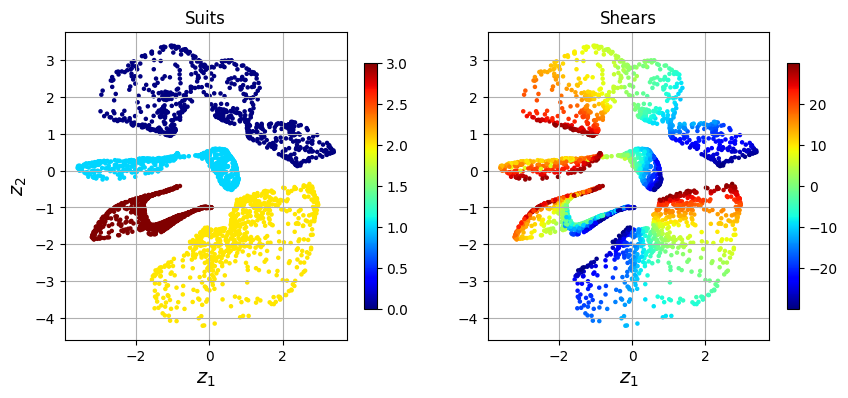

Epoch: 51 Training loss: 157.3728
Epoch: 52 Training loss: 156.0378
Epoch: 53 Training loss: 154.9263
Epoch: 54 Training loss: 153.5344
Epoch: 55 Training loss: 151.8272
Epoch: 56 Training loss: 150.6810
Epoch: 57 Training loss: 149.1497
Epoch: 58 Training loss: 147.6183
Epoch: 59 Training loss: 146.4311
Epoch: 60 Training loss: 145.2438
Epoch: 61 Training loss: 143.8738
Epoch: 62 Training loss: 142.6455
Epoch: 63 Training loss: 141.6561
Epoch: 64 Training loss: 140.5570
Epoch: 65 Training loss: 139.8377
Epoch: 66 Training loss: 138.6160
Epoch: 67 Training loss: 137.4728
Epoch: 68 Training loss: 136.3541
Epoch: 69 Training loss: 135.3658
Epoch: 70 Training loss: 134.7497
Epoch: 71 Training loss: 134.2173
Epoch: 72 Training loss: 133.3824
Epoch: 73 Training loss: 132.9377
Epoch: 74 Training loss: 131.9382
Epoch: 75 Training loss: 131.1416
Epoch: 76 Training loss: 130.2267
Epoch: 77 Training loss: 129.6074
Epoch: 78 Training loss: 129.0834
Epoch: 79 Training loss: 128.0359
Epoch: 80 Trai

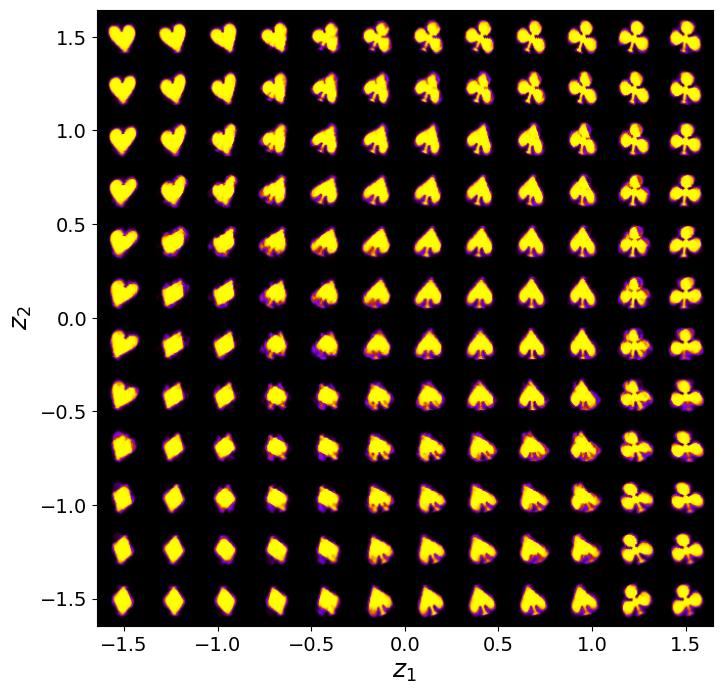

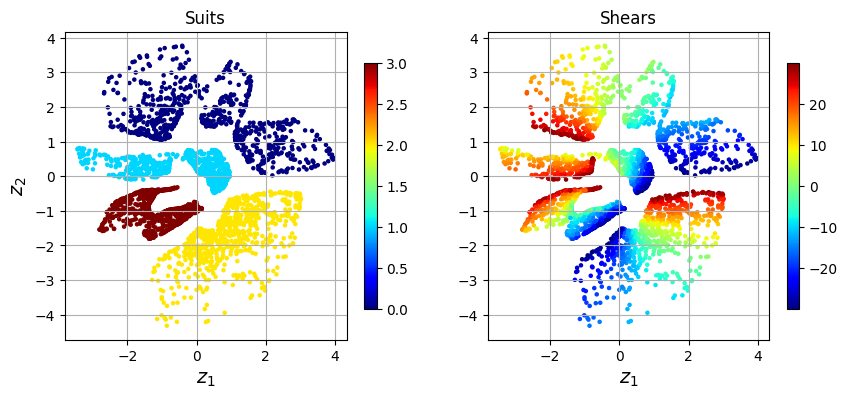

Epoch: 101 Training loss: 116.5237
Epoch: 102 Training loss: 115.8864
Epoch: 103 Training loss: 115.0775
Epoch: 104 Training loss: 114.7057
Epoch: 105 Training loss: 114.8344
Epoch: 106 Training loss: 114.1739
Epoch: 107 Training loss: 113.6724
Epoch: 108 Training loss: 113.2553
Epoch: 109 Training loss: 112.9345
Epoch: 110 Training loss: 112.5232
Epoch: 111 Training loss: 112.0643
Epoch: 112 Training loss: 111.5644
Epoch: 113 Training loss: 111.2991
Epoch: 114 Training loss: 110.9984
Epoch: 115 Training loss: 111.0262
Epoch: 116 Training loss: 111.1987
Epoch: 117 Training loss: 110.3345
Epoch: 118 Training loss: 109.7000
Epoch: 119 Training loss: 109.9073
Epoch: 120 Training loss: 109.9239
Epoch: 121 Training loss: 108.8639
Epoch: 122 Training loss: 108.6491
Epoch: 123 Training loss: 108.3475
Epoch: 124 Training loss: 107.7802
Epoch: 125 Training loss: 107.6846
Epoch: 126 Training loss: 107.7043
Epoch: 127 Training loss: 106.8164
Epoch: 128 Training loss: 106.8308
Epoch: 129 Training 

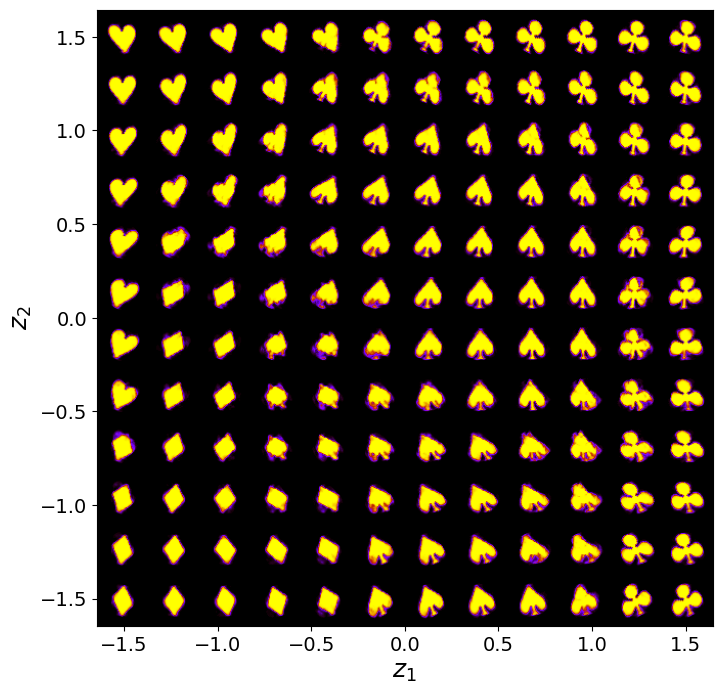

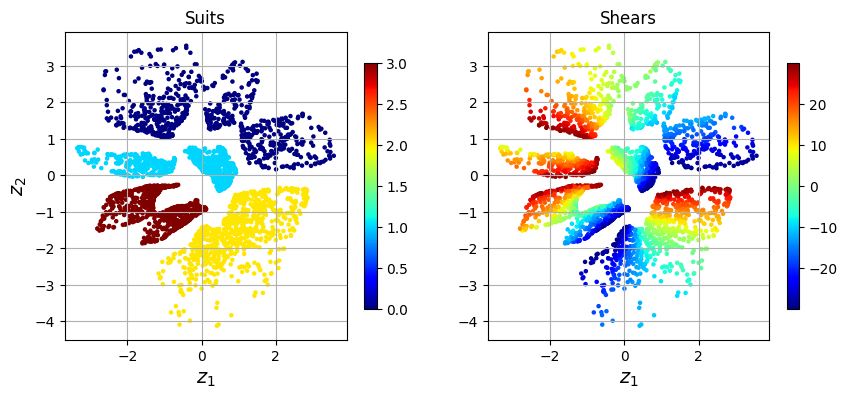

Epoch: 151 Training loss: 101.9628
Epoch: 152 Training loss: 101.5340
Epoch: 153 Training loss: 101.7022
Epoch: 154 Training loss: 101.3370
Epoch: 155 Training loss: 101.1861
Epoch: 156 Training loss: 101.1592
Epoch: 157 Training loss: 101.3045
Epoch: 158 Training loss: 100.7907
Epoch: 159 Training loss: 100.5195
Epoch: 160 Training loss: 100.4728
Epoch: 161 Training loss: 101.3872
Epoch: 162 Training loss: 100.1714
Epoch: 163 Training loss: 99.9949
Epoch: 164 Training loss: 100.1415
Epoch: 165 Training loss: 99.8778
Epoch: 166 Training loss: 99.7040
Epoch: 167 Training loss: 99.6386
Epoch: 168 Training loss: 99.1911
Epoch: 169 Training loss: 99.0938
Epoch: 170 Training loss: 98.9181
Epoch: 171 Training loss: 99.0155
Epoch: 172 Training loss: 98.6623
Epoch: 173 Training loss: 98.4433
Epoch: 174 Training loss: 98.5569
Epoch: 175 Training loss: 98.2975
Epoch: 176 Training loss: 98.0752
Epoch: 177 Training loss: 97.8269
Epoch: 178 Training loss: 97.9150
Epoch: 179 Training loss: 98.4261
E

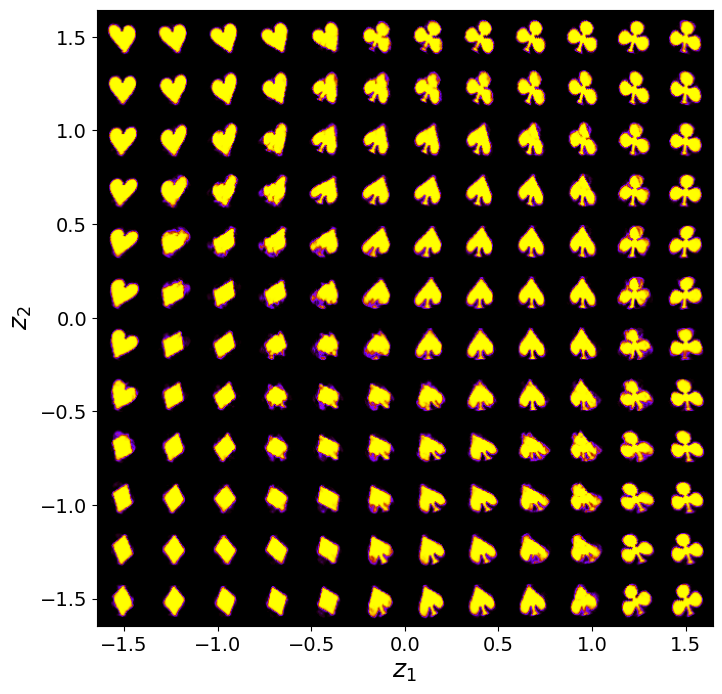

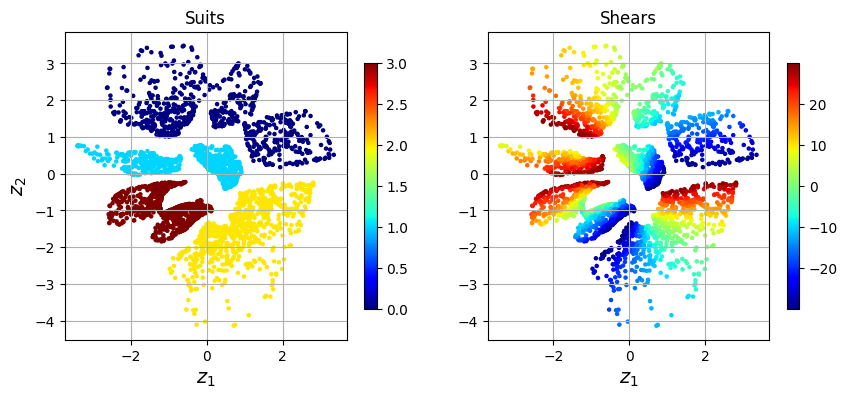

Epoch: 201 Training loss: 95.3867
Epoch: 202 Training loss: 95.3794
Epoch: 203 Training loss: 95.3622
Epoch: 204 Training loss: 95.3561
Epoch: 205 Training loss: 95.0560
Epoch: 206 Training loss: 95.5806
Epoch: 207 Training loss: 95.0467
Epoch: 208 Training loss: 95.9181
Epoch: 209 Training loss: 95.0697
Epoch: 210 Training loss: 94.6239
Epoch: 211 Training loss: 95.2580
Epoch: 212 Training loss: 94.6941
Epoch: 213 Training loss: 94.5374
Epoch: 214 Training loss: 94.5403
Epoch: 215 Training loss: 94.4156
Epoch: 216 Training loss: 94.1911
Epoch: 217 Training loss: 94.1303
Epoch: 218 Training loss: 93.9260
Epoch: 219 Training loss: 94.2668
Epoch: 220 Training loss: 93.9470
Epoch: 221 Training loss: 94.0692
Epoch: 222 Training loss: 93.8610
Epoch: 223 Training loss: 93.8323
Epoch: 224 Training loss: 93.7097
Epoch: 225 Training loss: 93.5724
Epoch: 226 Training loss: 93.3631
Epoch: 227 Training loss: 93.4755
Epoch: 228 Training loss: 93.6229
Epoch: 229 Training loss: 93.3515
Epoch: 230 Tra

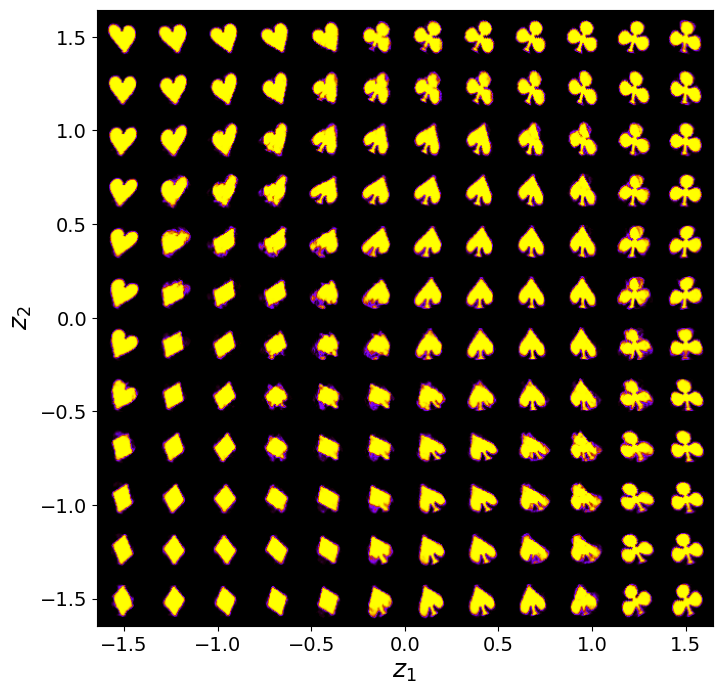

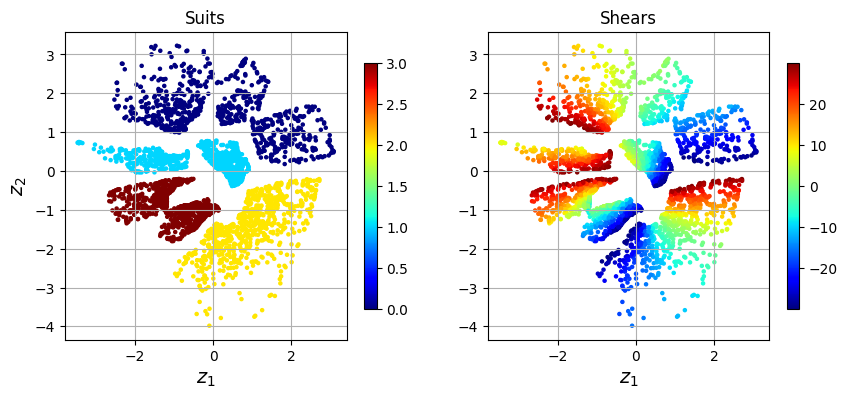

Epoch: 251 Training loss: 92.0520
Epoch: 252 Training loss: 91.8428
Epoch: 253 Training loss: 91.8125
Epoch: 254 Training loss: 91.7486
Epoch: 255 Training loss: 92.2049
Epoch: 256 Training loss: 92.2218
Epoch: 257 Training loss: 91.8878
Epoch: 258 Training loss: 91.9586
Epoch: 259 Training loss: 91.5294
Epoch: 260 Training loss: 91.4222
Epoch: 261 Training loss: 91.3930
Epoch: 262 Training loss: 91.3896
Epoch: 263 Training loss: 91.6455
Epoch: 264 Training loss: 91.4819
Epoch: 265 Training loss: 91.3127
Epoch: 266 Training loss: 91.0809
Epoch: 267 Training loss: 91.1920
Epoch: 268 Training loss: 91.0389
Epoch: 269 Training loss: 90.9041
Epoch: 270 Training loss: 90.9881
Epoch: 271 Training loss: 90.7444
Epoch: 272 Training loss: 90.9283
Epoch: 273 Training loss: 90.8114
Epoch: 274 Training loss: 90.7166
Epoch: 275 Training loss: 90.5653
Epoch: 276 Training loss: 90.5632
Epoch: 277 Training loss: 90.9108
Epoch: 278 Training loss: 90.7776
Epoch: 279 Training loss: 90.5442
Epoch: 280 Tra

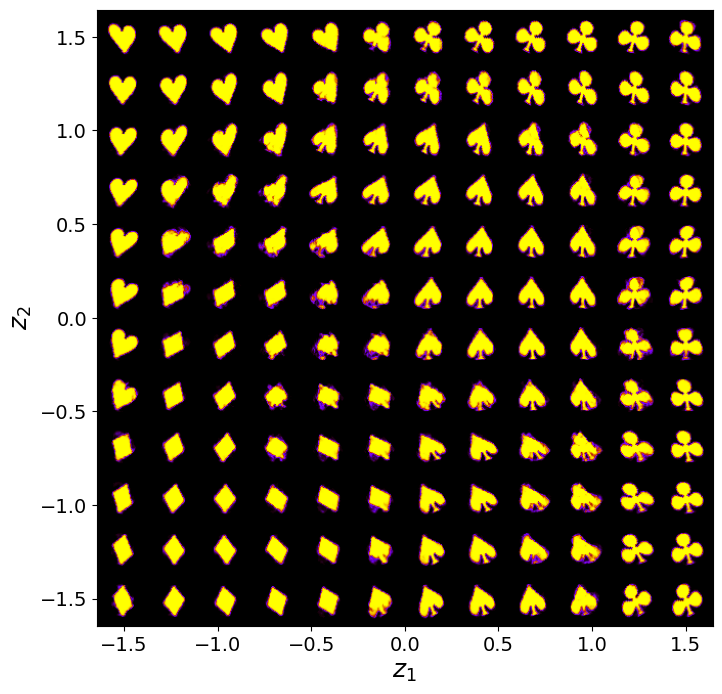

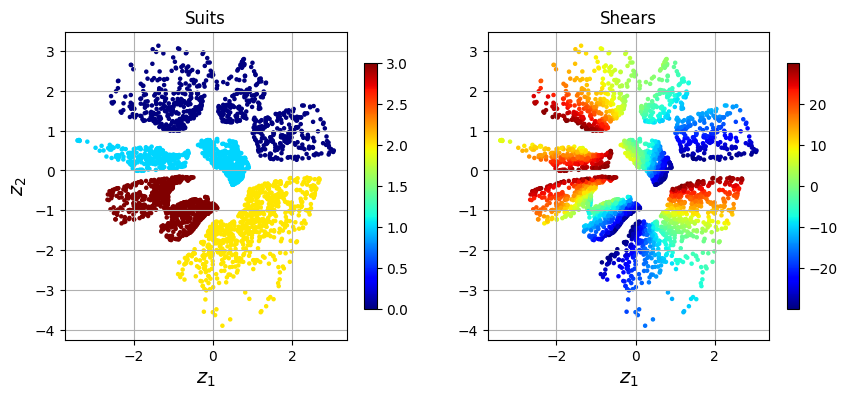

Epoch: 301 Training loss: 89.6210
Epoch: 302 Training loss: 89.6759
Epoch: 303 Training loss: 89.5709
Epoch: 304 Training loss: 89.8713
Epoch: 305 Training loss: 89.7339
Epoch: 306 Training loss: 89.5343
Epoch: 307 Training loss: 89.5473
Epoch: 308 Training loss: 89.3451
Epoch: 309 Training loss: 89.4606
Epoch: 310 Training loss: 89.3424
Epoch: 311 Training loss: 89.2253
Epoch: 312 Training loss: 89.7642
Epoch: 313 Training loss: 89.4805
Epoch: 314 Training loss: 89.2848
Epoch: 315 Training loss: 89.2660
Epoch: 316 Training loss: 89.4627
Epoch: 317 Training loss: 89.2096
Epoch: 318 Training loss: 88.9457
Epoch: 319 Training loss: 88.9332
Epoch: 320 Training loss: 89.7784
Epoch: 321 Training loss: 89.5559
Epoch: 322 Training loss: 89.0829
Epoch: 323 Training loss: 89.0075
Epoch: 324 Training loss: 89.0147
Epoch: 325 Training loss: 88.9232
Epoch: 326 Training loss: 89.0161
Epoch: 327 Training loss: 89.0391
Epoch: 328 Training loss: 89.0152
Epoch: 329 Training loss: 88.7500
Epoch: 330 Tra

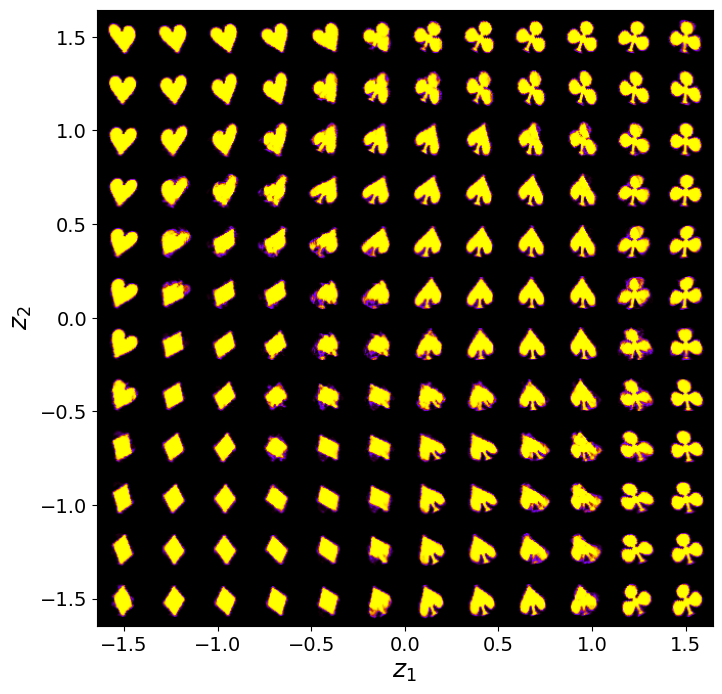

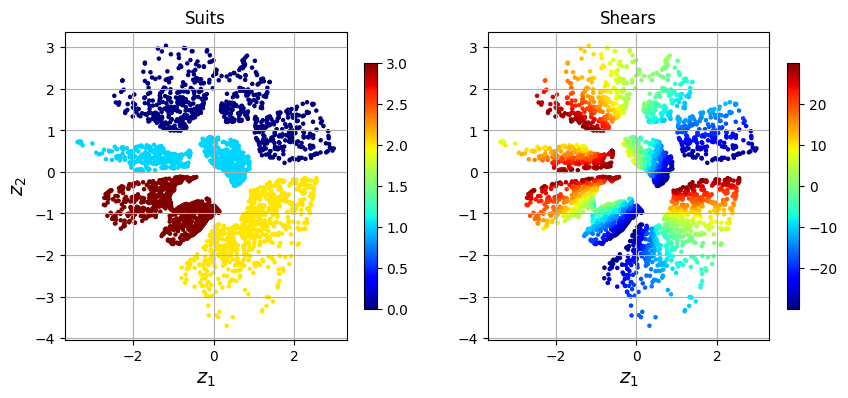

Epoch: 351 Training loss: 88.2039
Epoch: 352 Training loss: 88.2913
Epoch: 353 Training loss: 88.2814
Epoch: 354 Training loss: 88.0785
Epoch: 355 Training loss: 88.3670
Epoch: 356 Training loss: 88.4697
Epoch: 357 Training loss: 88.5124
Epoch: 358 Training loss: 88.7539
Epoch: 359 Training loss: 88.0784
Epoch: 360 Training loss: 87.8215
Epoch: 361 Training loss: 87.9048
Epoch: 362 Training loss: 87.9274
Epoch: 363 Training loss: 88.0448
Epoch: 364 Training loss: 87.8615
Epoch: 365 Training loss: 88.0447
Epoch: 366 Training loss: 87.6268
Epoch: 367 Training loss: 87.7146
Epoch: 368 Training loss: 88.0292
Epoch: 369 Training loss: 87.9044
Epoch: 370 Training loss: 87.7992
Epoch: 371 Training loss: 87.6261
Epoch: 372 Training loss: 87.9063
Epoch: 373 Training loss: 87.6224
Epoch: 374 Training loss: 87.6397
Epoch: 375 Training loss: 87.9326
Epoch: 376 Training loss: 87.8033
Epoch: 377 Training loss: 87.5722
Epoch: 378 Training loss: 87.6423
Epoch: 379 Training loss: 87.8993
Epoch: 380 Tra

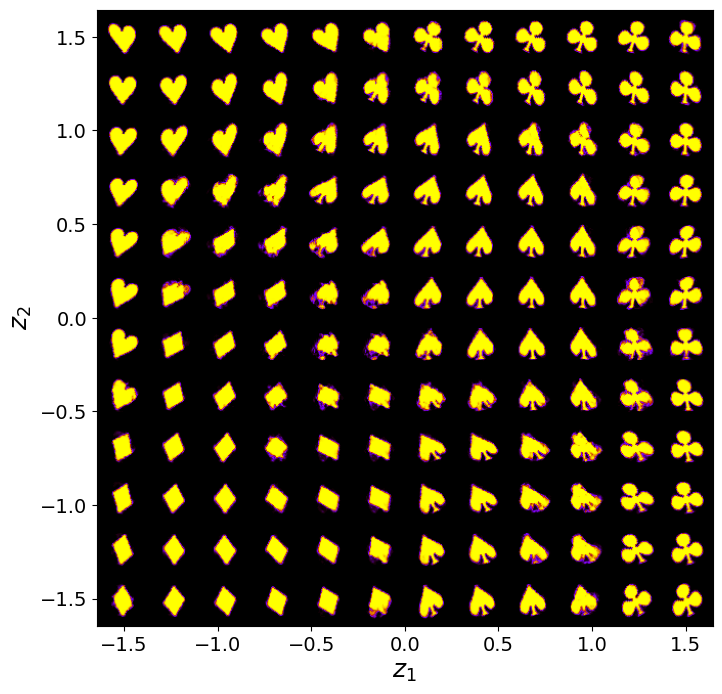

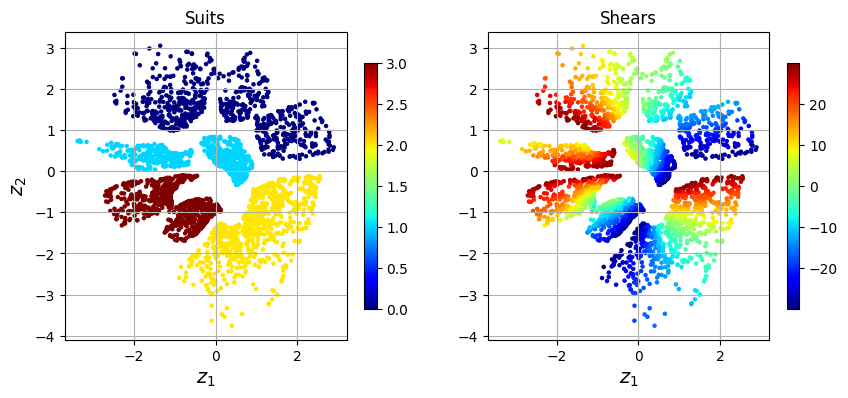

Epoch: 401 Training loss: 87.4627
Epoch: 402 Training loss: 87.1685
Epoch: 403 Training loss: 87.1561
Epoch: 404 Training loss: 87.4712
Epoch: 405 Training loss: 87.1679
Epoch: 406 Training loss: 87.0586
Epoch: 407 Training loss: 86.8839
Epoch: 408 Training loss: 86.8278
Epoch: 409 Training loss: 86.9232
Epoch: 410 Training loss: 86.9190
Epoch: 411 Training loss: 86.8300
Epoch: 412 Training loss: 87.0033
Epoch: 413 Training loss: 86.9699
Epoch: 414 Training loss: 86.8505
Epoch: 415 Training loss: 86.8015
Epoch: 416 Training loss: 86.7900
Epoch: 417 Training loss: 87.2574
Epoch: 418 Training loss: 87.1839
Epoch: 419 Training loss: 86.7845
Epoch: 420 Training loss: 86.8781
Epoch: 421 Training loss: 86.8535
Epoch: 422 Training loss: 86.6236
Epoch: 423 Training loss: 86.8144
Epoch: 424 Training loss: 86.7275
Epoch: 425 Training loss: 86.6694
Epoch: 426 Training loss: 86.6503
Epoch: 427 Training loss: 86.5858
Epoch: 428 Training loss: 86.9419
Epoch: 429 Training loss: 86.9410
Epoch: 430 Tra

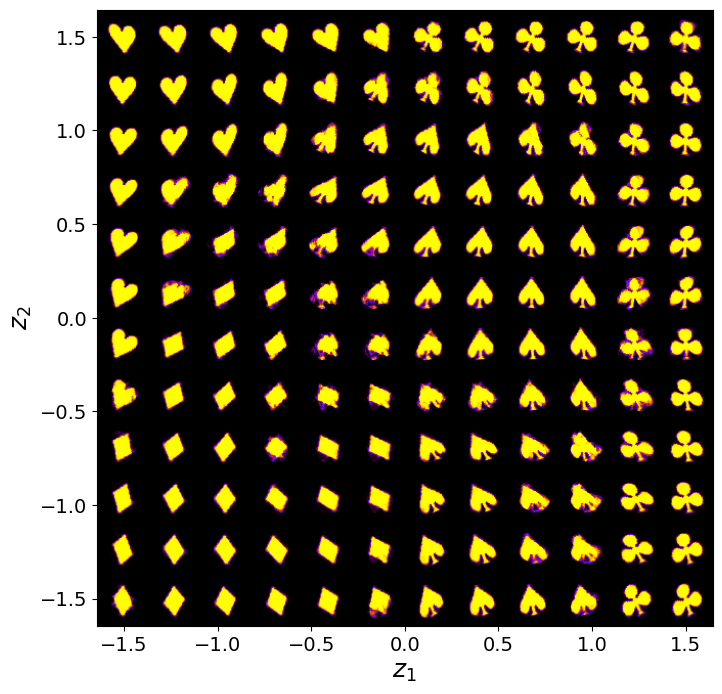

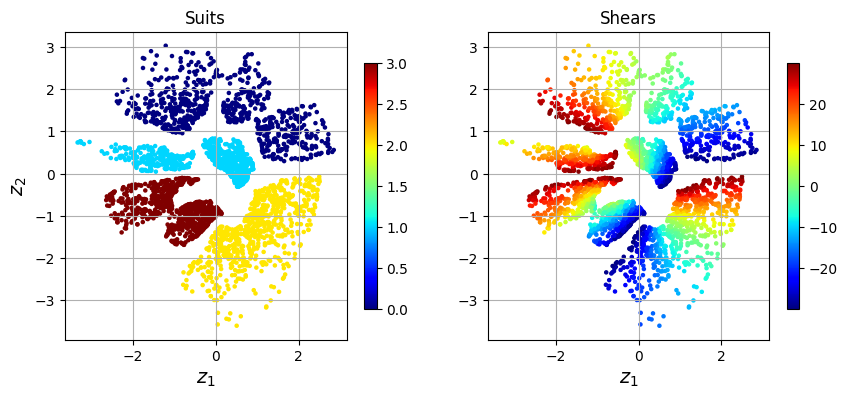

Epoch: 451 Training loss: 86.1443
Epoch: 452 Training loss: 86.4985
Epoch: 453 Training loss: 86.4629
Epoch: 454 Training loss: 86.5181
Epoch: 455 Training loss: 86.7790
Epoch: 456 Training loss: 86.5333
Epoch: 457 Training loss: 86.0702
Epoch: 458 Training loss: 86.1184
Epoch: 459 Training loss: 86.2973
Epoch: 460 Training loss: 86.3325
Epoch: 461 Training loss: 86.1079
Epoch: 462 Training loss: 86.0196
Epoch: 463 Training loss: 86.1295
Epoch: 464 Training loss: 85.9372
Epoch: 465 Training loss: 86.0342
Epoch: 466 Training loss: 86.0624
Epoch: 467 Training loss: 86.1486
Epoch: 468 Training loss: 86.3329
Epoch: 469 Training loss: 86.0056
Epoch: 470 Training loss: 85.9283
Epoch: 471 Training loss: 86.0654
Epoch: 472 Training loss: 85.9971
Epoch: 473 Training loss: 86.2137
Epoch: 474 Training loss: 86.2860
Epoch: 475 Training loss: 86.0688
Epoch: 476 Training loss: 86.2164
Epoch: 477 Training loss: 85.8320
Epoch: 478 Training loss: 85.8409
Epoch: 479 Training loss: 86.1536
Epoch: 480 Tra

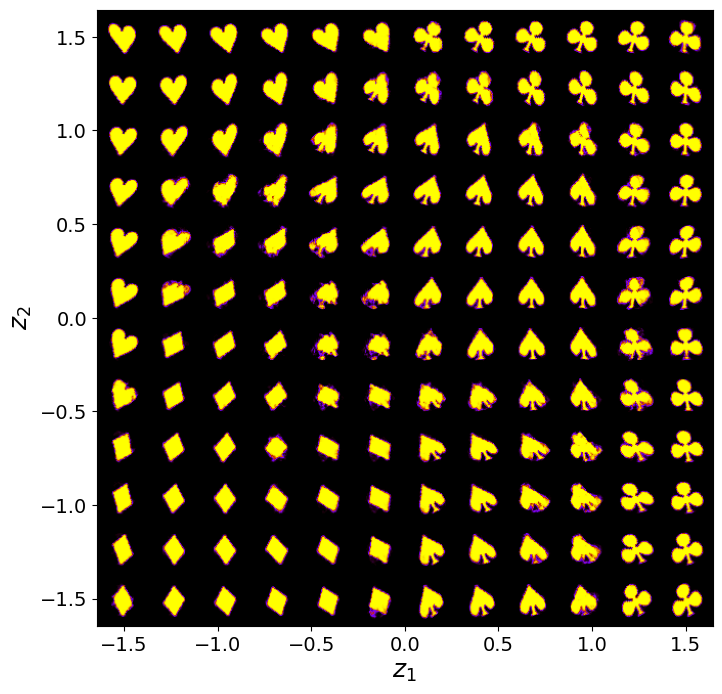

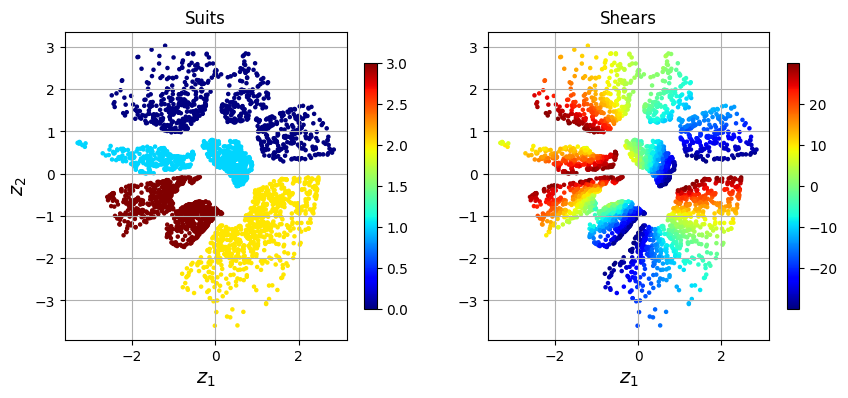

Epoch: 501 Training loss: 85.7166
Epoch: 502 Training loss: 85.7389
Epoch: 503 Training loss: 85.8364
Epoch: 504 Training loss: 85.6513
Epoch: 505 Training loss: 85.9271
Epoch: 506 Training loss: 85.6259
Epoch: 507 Training loss: 85.6749
Epoch: 508 Training loss: 85.4872
Epoch: 509 Training loss: 85.6111
Epoch: 510 Training loss: 85.6880
Epoch: 511 Training loss: 85.5169
Epoch: 512 Training loss: 85.5064
Epoch: 513 Training loss: 85.3233
Epoch: 514 Training loss: 85.4884
Epoch: 515 Training loss: 85.9202
Epoch: 516 Training loss: 85.6031
Epoch: 517 Training loss: 85.6371
Epoch: 518 Training loss: 85.4035
Epoch: 519 Training loss: 85.4885
Epoch: 520 Training loss: 85.3642
Epoch: 521 Training loss: 85.2926
Epoch: 522 Training loss: 85.7521
Epoch: 523 Training loss: 85.8217
Epoch: 524 Training loss: 85.5265
Epoch: 525 Training loss: 86.1132
Epoch: 526 Training loss: 85.7040
Epoch: 527 Training loss: 85.2152
Epoch: 528 Training loss: 85.2417
Epoch: 529 Training loss: 85.7130
Epoch: 530 Tra

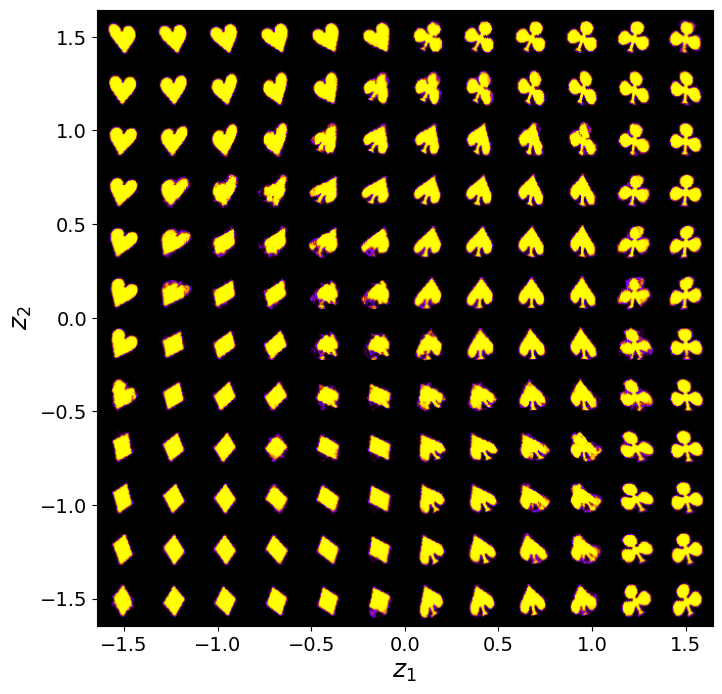

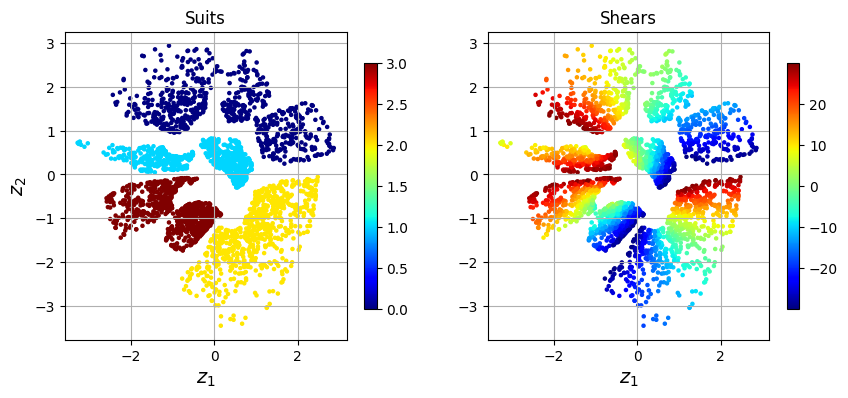

Epoch: 551 Training loss: 85.1818
Epoch: 552 Training loss: 85.0064
Epoch: 553 Training loss: 85.4886
Epoch: 554 Training loss: 85.4312
Epoch: 555 Training loss: 85.2128
Epoch: 556 Training loss: 85.4857
Epoch: 557 Training loss: 85.1969
Epoch: 558 Training loss: 85.4966
Epoch: 559 Training loss: 85.3172
Epoch: 560 Training loss: 85.2513
Epoch: 561 Training loss: 85.3609
Epoch: 562 Training loss: 85.1641
Epoch: 563 Training loss: 85.3288
Epoch: 564 Training loss: 84.9840
Epoch: 565 Training loss: 84.9440
Epoch: 566 Training loss: 85.2047
Epoch: 567 Training loss: 84.9252
Epoch: 568 Training loss: 84.8348
Epoch: 569 Training loss: 85.2412
Epoch: 570 Training loss: 85.2751
Epoch: 571 Training loss: 85.2357
Epoch: 572 Training loss: 84.9705
Epoch: 573 Training loss: 85.2871
Epoch: 574 Training loss: 84.8619
Epoch: 575 Training loss: 84.9816
Epoch: 576 Training loss: 84.9990
Epoch: 577 Training loss: 84.9367
Epoch: 578 Training loss: 84.9138
Epoch: 579 Training loss: 85.1162
Epoch: 580 Tra

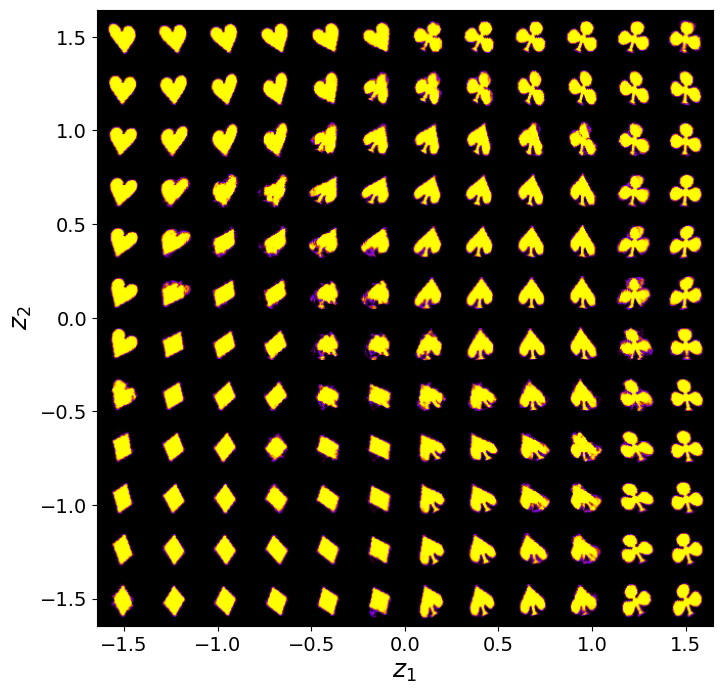

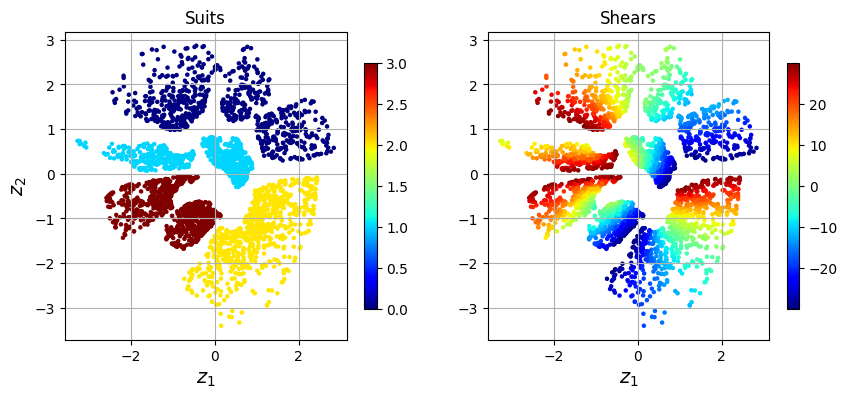

Epoch: 601 Training loss: 84.6649
Epoch: 602 Training loss: 84.7134
Epoch: 603 Training loss: 84.8411
Epoch: 604 Training loss: 85.1596
Epoch: 605 Training loss: 85.2909
Epoch: 606 Training loss: 84.7634
Epoch: 607 Training loss: 84.9020
Epoch: 608 Training loss: 84.6247
Epoch: 609 Training loss: 84.5665
Epoch: 610 Training loss: 84.5712
Epoch: 611 Training loss: 84.7349
Epoch: 612 Training loss: 84.5044
Epoch: 613 Training loss: 84.9207
Epoch: 614 Training loss: 84.6162
Epoch: 615 Training loss: 84.6904
Epoch: 616 Training loss: 84.7878
Epoch: 617 Training loss: 84.5472
Epoch: 618 Training loss: 84.5413
Epoch: 619 Training loss: 84.9431
Epoch: 620 Training loss: 84.8034
Epoch: 621 Training loss: 84.5992
Epoch: 622 Training loss: 84.5737
Epoch: 623 Training loss: 84.6582
Epoch: 624 Training loss: 84.5163
Epoch: 625 Training loss: 84.6752
Epoch: 626 Training loss: 84.6651
Epoch: 627 Training loss: 84.4413
Epoch: 628 Training loss: 84.5023
Epoch: 629 Training loss: 84.3735
Epoch: 630 Tra

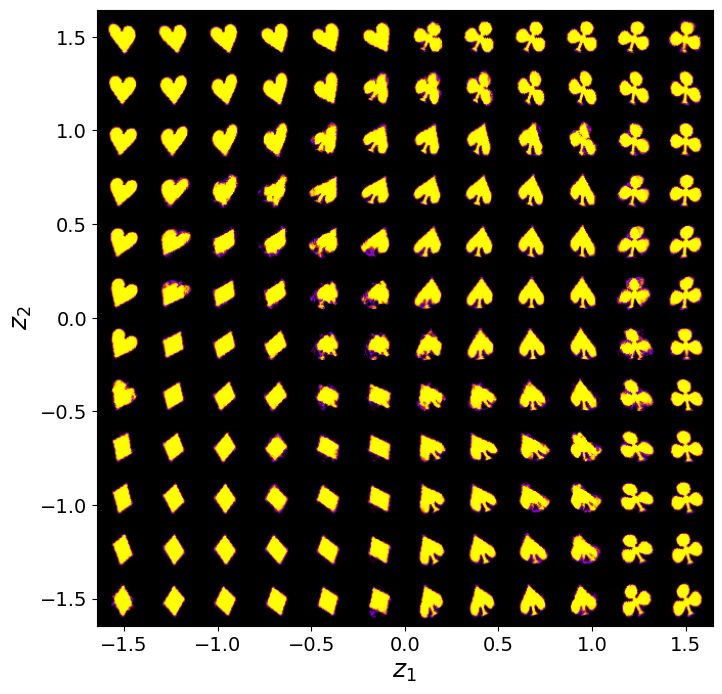

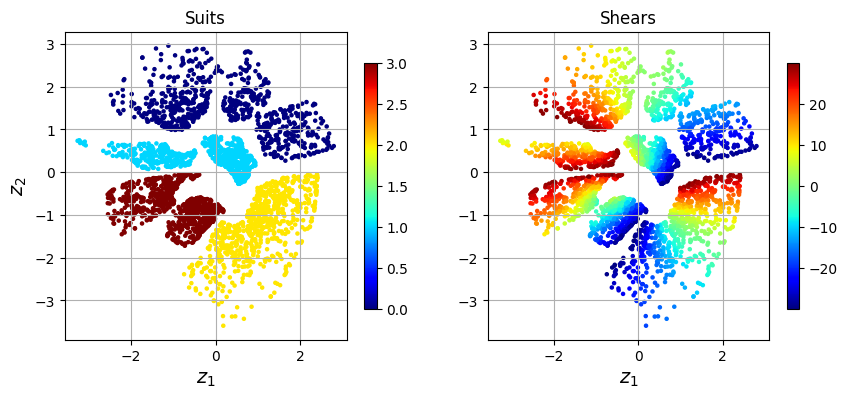

Epoch: 651 Training loss: 84.3212
Epoch: 652 Training loss: 84.4724
Epoch: 653 Training loss: 85.2397
Epoch: 654 Training loss: 85.3789
Epoch: 655 Training loss: 84.4613
Epoch: 656 Training loss: 84.1721
Epoch: 657 Training loss: 84.1892
Epoch: 658 Training loss: 84.1532
Epoch: 659 Training loss: 84.1924
Epoch: 660 Training loss: 84.3618
Epoch: 661 Training loss: 84.4460
Epoch: 662 Training loss: 84.9827
Epoch: 663 Training loss: 84.3610
Epoch: 664 Training loss: 84.2135
Epoch: 665 Training loss: 84.1797
Epoch: 666 Training loss: 84.3248
Epoch: 667 Training loss: 84.4390
Epoch: 668 Training loss: 84.2224
Epoch: 669 Training loss: 84.3208
Epoch: 670 Training loss: 84.4625
Epoch: 671 Training loss: 84.1983
Epoch: 672 Training loss: 84.1226
Epoch: 673 Training loss: 84.3944
Epoch: 674 Training loss: 84.0487
Epoch: 675 Training loss: 84.4596
Epoch: 676 Training loss: 84.0978
Epoch: 677 Training loss: 85.0398
Epoch: 678 Training loss: 85.1414
Epoch: 679 Training loss: 84.3950
Epoch: 680 Tra

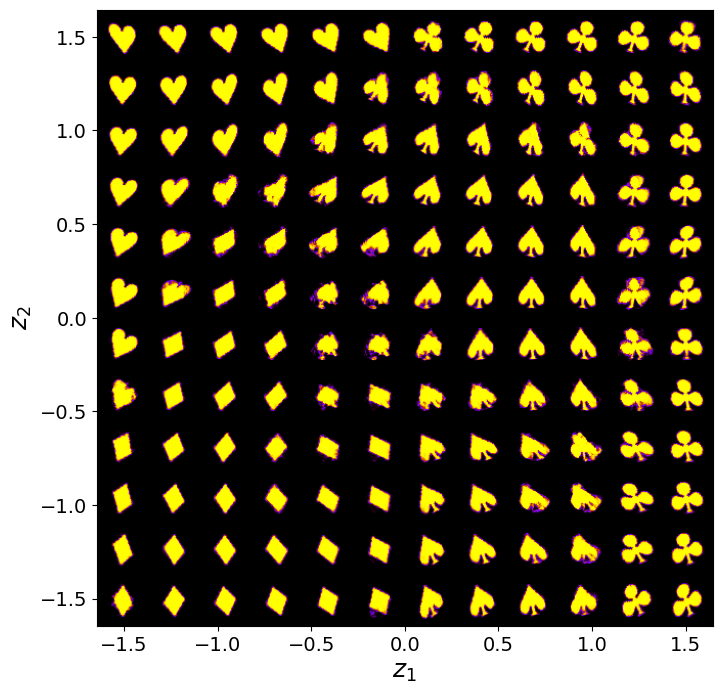

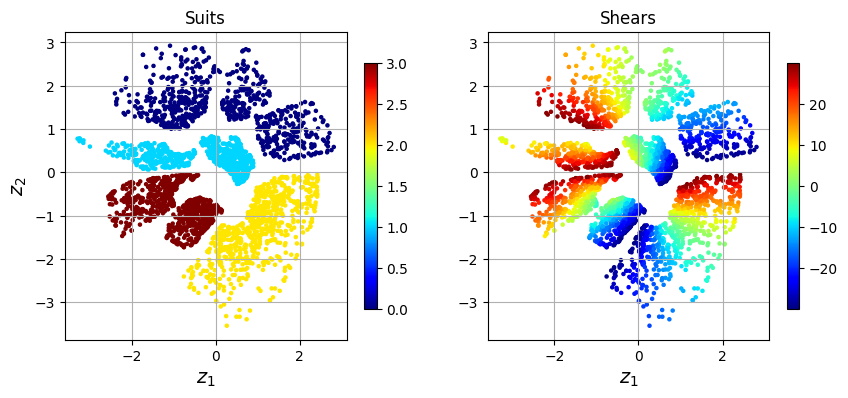

Epoch: 701 Training loss: 83.9397
Epoch: 702 Training loss: 84.0233
Epoch: 703 Training loss: 84.0835
Epoch: 704 Training loss: 84.2876
Epoch: 705 Training loss: 84.5570
Epoch: 706 Training loss: 84.1747
Epoch: 707 Training loss: 84.3898
Epoch: 708 Training loss: 84.6100
Epoch: 709 Training loss: 84.3787
Epoch: 710 Training loss: 84.3002
Epoch: 711 Training loss: 84.1106
Epoch: 712 Training loss: 84.2708
Epoch: 713 Training loss: 84.3011
Epoch: 714 Training loss: 84.0388
Epoch: 715 Training loss: 83.9809
Epoch: 716 Training loss: 83.7706
Epoch: 717 Training loss: 83.7561
Epoch: 718 Training loss: 83.9353
Epoch: 719 Training loss: 83.9547
Epoch: 720 Training loss: 83.9464
Epoch: 721 Training loss: 84.2742
Epoch: 722 Training loss: 84.1822
Epoch: 723 Training loss: 83.8767
Epoch: 724 Training loss: 84.3518
Epoch: 725 Training loss: 84.0317
Epoch: 726 Training loss: 83.9874
Epoch: 727 Training loss: 84.0542
Epoch: 728 Training loss: 83.8817
Epoch: 729 Training loss: 83.7342
Epoch: 730 Tra

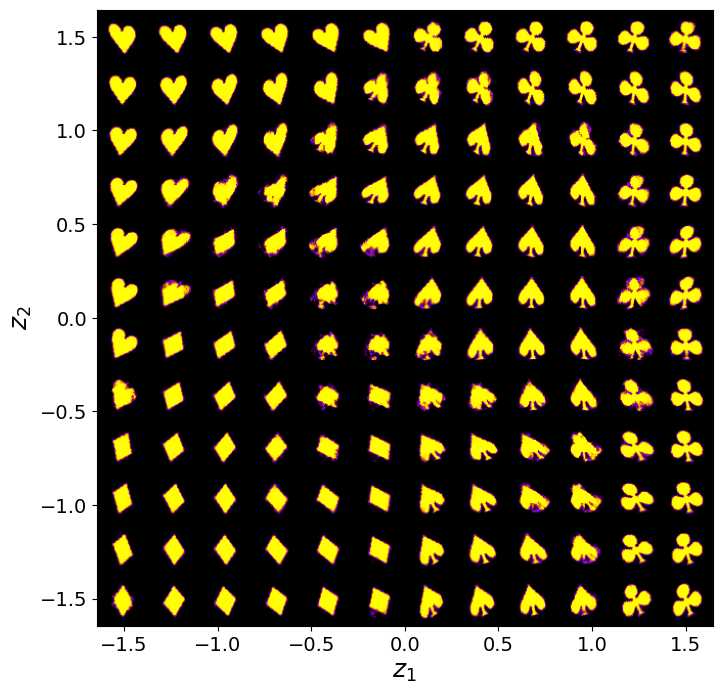

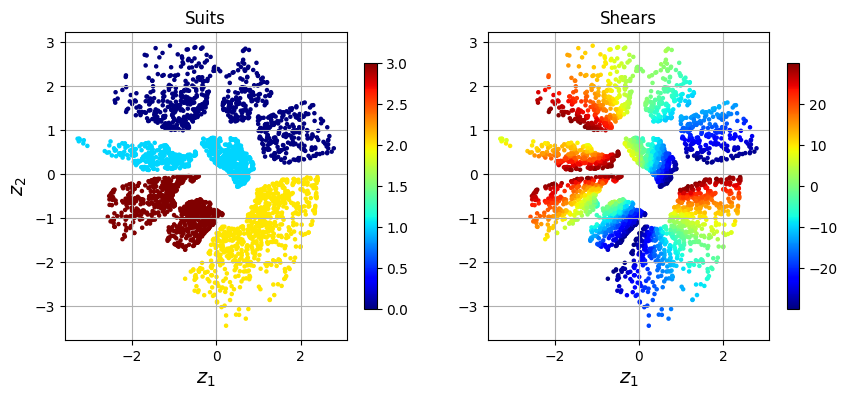

Epoch: 751 Training loss: 83.8702
Epoch: 752 Training loss: 83.8379
Epoch: 753 Training loss: 83.8061
Epoch: 754 Training loss: 83.9536
Epoch: 755 Training loss: 83.9735
Epoch: 756 Training loss: 83.7744
Epoch: 757 Training loss: 83.7414
Epoch: 758 Training loss: 83.9825
Epoch: 759 Training loss: 83.7550
Epoch: 760 Training loss: 83.8982
Epoch: 761 Training loss: 83.8486
Epoch: 762 Training loss: 83.7446
Epoch: 763 Training loss: 83.8946
Epoch: 764 Training loss: 83.6122
Epoch: 765 Training loss: 83.6091
Epoch: 766 Training loss: 83.8583
Epoch: 767 Training loss: 83.9007
Epoch: 768 Training loss: 83.8776
Epoch: 769 Training loss: 83.9269
Epoch: 770 Training loss: 84.1295
Epoch: 771 Training loss: 83.7219
Epoch: 772 Training loss: 83.6697
Epoch: 773 Training loss: 84.0524
Epoch: 774 Training loss: 84.1338
Epoch: 775 Training loss: 83.8849
Epoch: 776 Training loss: 83.8360
Epoch: 777 Training loss: 83.5631
Epoch: 778 Training loss: 83.5081
Epoch: 779 Training loss: 83.7114
Epoch: 780 Tra

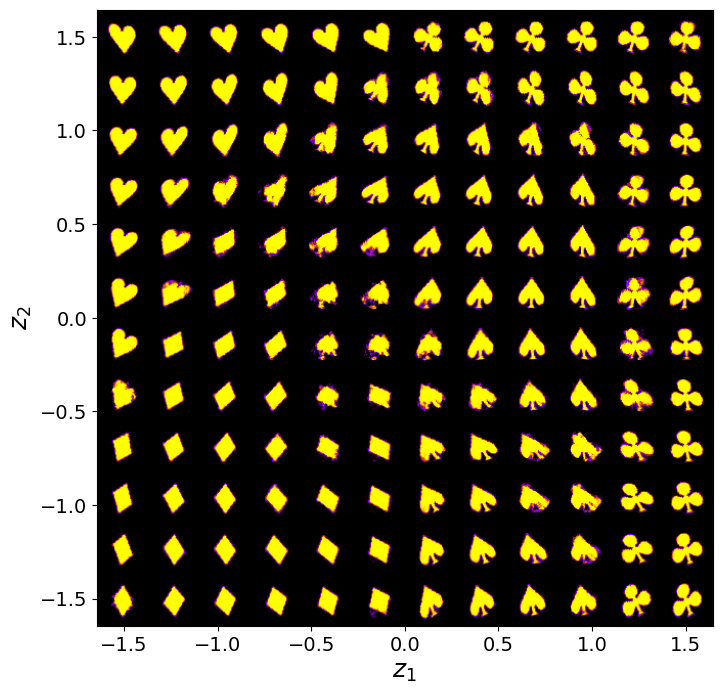

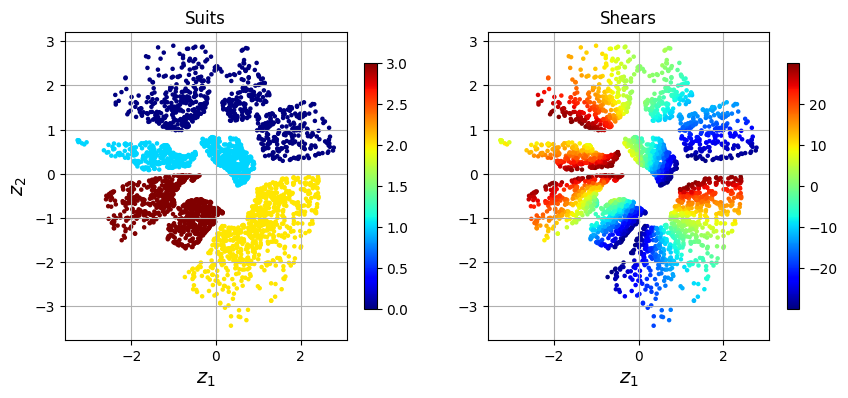

Epoch: 801 Training loss: 83.6910
Epoch: 802 Training loss: 83.5607
Epoch: 803 Training loss: 83.5159
Epoch: 804 Training loss: 84.0078
Epoch: 805 Training loss: 84.0512
Epoch: 806 Training loss: 83.8990
Epoch: 807 Training loss: 83.9025
Epoch: 808 Training loss: 83.5345
Epoch: 809 Training loss: 83.6790
Epoch: 810 Training loss: 83.9939
Epoch: 811 Training loss: 83.7234
Epoch: 812 Training loss: 83.4230
Epoch: 813 Training loss: 83.3828
Epoch: 814 Training loss: 83.3895
Epoch: 815 Training loss: 83.7144
Epoch: 816 Training loss: 83.4668
Epoch: 817 Training loss: 83.4606
Epoch: 818 Training loss: 83.5172
Epoch: 819 Training loss: 83.6106
Epoch: 820 Training loss: 83.3534
Epoch: 821 Training loss: 83.4186
Epoch: 822 Training loss: 83.5095
Epoch: 823 Training loss: 83.3462
Epoch: 824 Training loss: 83.5948
Epoch: 825 Training loss: 83.9048
Epoch: 826 Training loss: 83.4459
Epoch: 827 Training loss: 83.6089
Epoch: 828 Training loss: 83.4034
Epoch: 829 Training loss: 83.5427
Epoch: 830 Tra

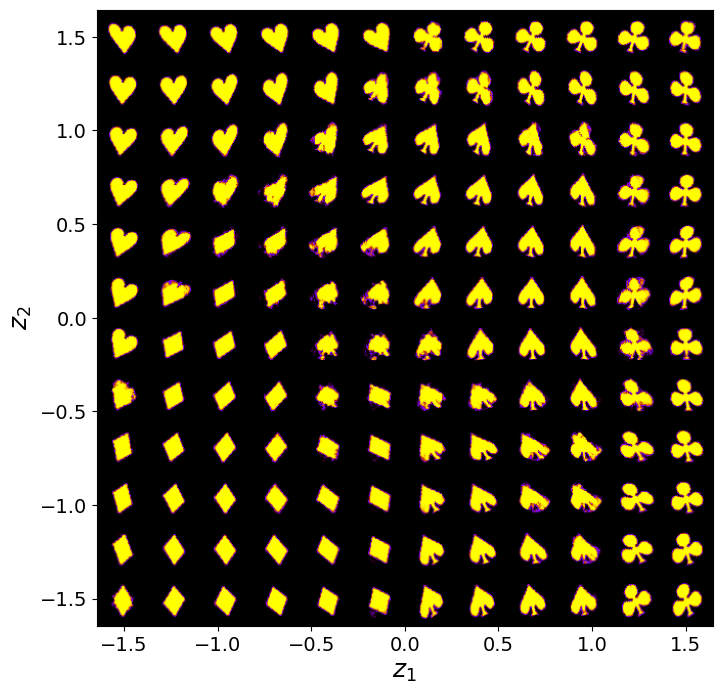

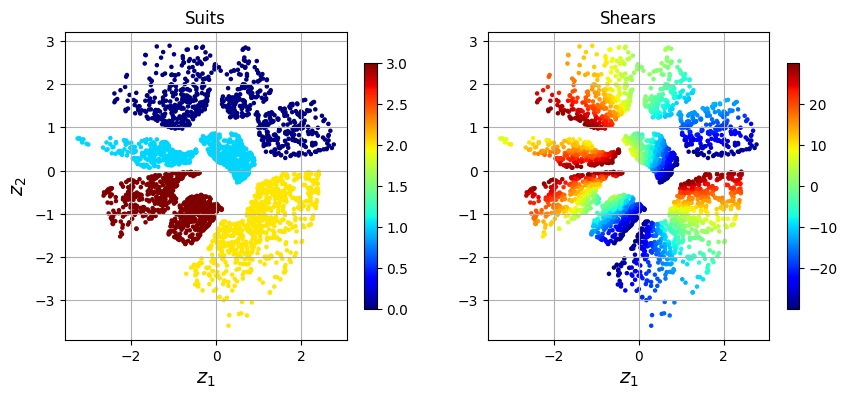

Epoch: 851 Training loss: 83.4510
Epoch: 852 Training loss: 83.5888
Epoch: 853 Training loss: 83.6067
Epoch: 854 Training loss: 83.5287
Epoch: 855 Training loss: 83.2843
Epoch: 856 Training loss: 83.2830
Epoch: 857 Training loss: 83.6235
Epoch: 858 Training loss: 83.4649
Epoch: 859 Training loss: 83.3205
Epoch: 860 Training loss: 83.4205
Epoch: 861 Training loss: 83.3046
Epoch: 862 Training loss: 83.1830
Epoch: 863 Training loss: 83.3984
Epoch: 864 Training loss: 83.5091
Epoch: 865 Training loss: 83.3304
Epoch: 866 Training loss: 83.2246
Epoch: 867 Training loss: 83.3502
Epoch: 868 Training loss: 83.3196
Epoch: 869 Training loss: 83.3742
Epoch: 870 Training loss: 83.3205
Epoch: 871 Training loss: 83.6874
Epoch: 872 Training loss: 83.7059
Epoch: 873 Training loss: 83.6065
Epoch: 874 Training loss: 83.4909
Epoch: 875 Training loss: 83.7125
Epoch: 876 Training loss: 83.6376
Epoch: 877 Training loss: 83.6308
Epoch: 878 Training loss: 83.2985
Epoch: 879 Training loss: 83.2384
Epoch: 880 Tra

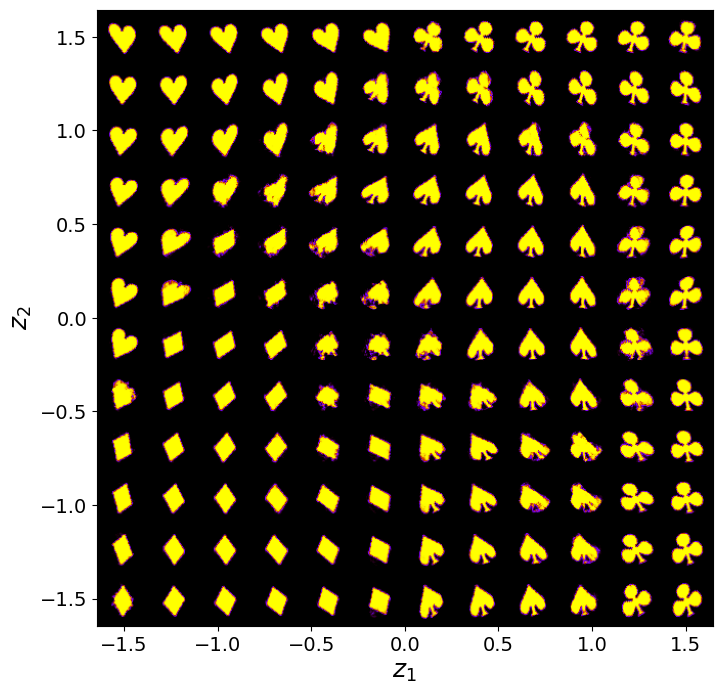

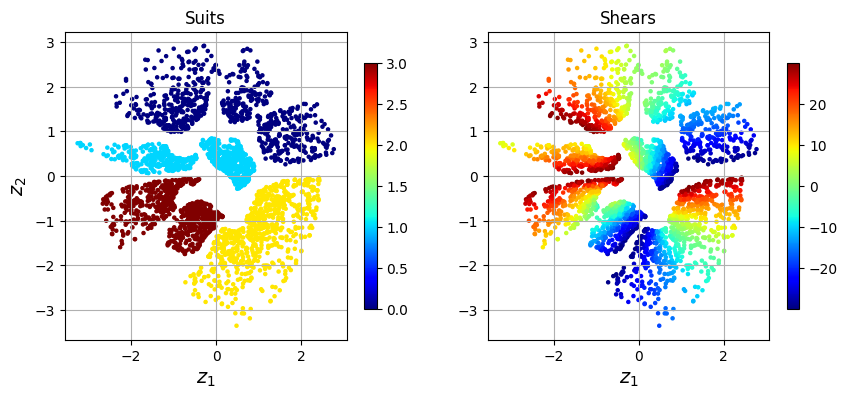

Epoch: 901 Training loss: 83.1932
Epoch: 902 Training loss: 83.0779
Epoch: 903 Training loss: 83.1217
Epoch: 904 Training loss: 83.1606
Epoch: 905 Training loss: 83.4049
Epoch: 906 Training loss: 83.3774
Epoch: 907 Training loss: 83.2413
Epoch: 908 Training loss: 83.0080
Epoch: 909 Training loss: 83.1279
Epoch: 910 Training loss: 82.9610
Epoch: 911 Training loss: 83.1441
Epoch: 912 Training loss: 83.1954
Epoch: 913 Training loss: 82.9872
Epoch: 914 Training loss: 83.4464
Epoch: 915 Training loss: 83.5463
Epoch: 916 Training loss: 83.1172
Epoch: 917 Training loss: 83.0913
Epoch: 918 Training loss: 82.9930
Epoch: 919 Training loss: 83.2836
Epoch: 920 Training loss: 83.1199
Epoch: 921 Training loss: 83.4028
Epoch: 922 Training loss: 83.1354
Epoch: 923 Training loss: 83.1813
Epoch: 924 Training loss: 83.1612
Epoch: 925 Training loss: 83.0764
Epoch: 926 Training loss: 83.3157
Epoch: 927 Training loss: 84.1071
Epoch: 928 Training loss: 83.2056
Epoch: 929 Training loss: 83.0538
Epoch: 930 Tra

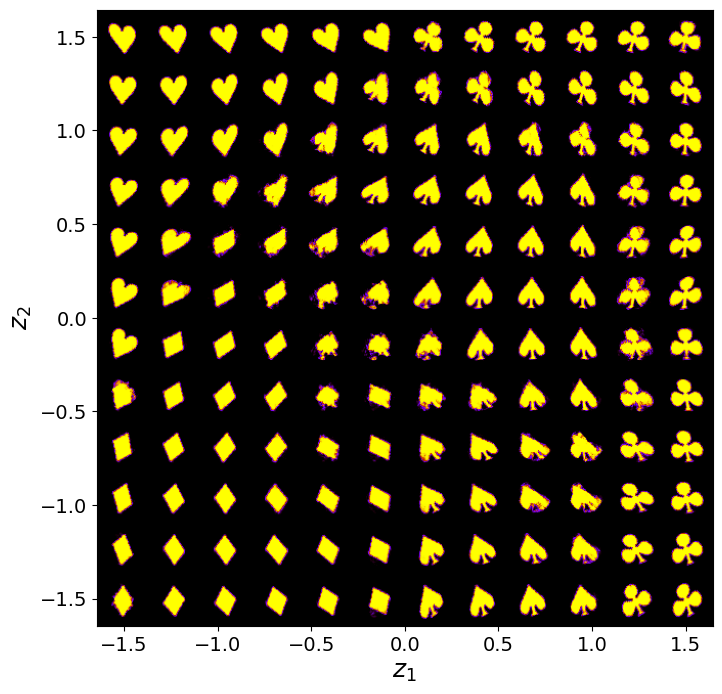

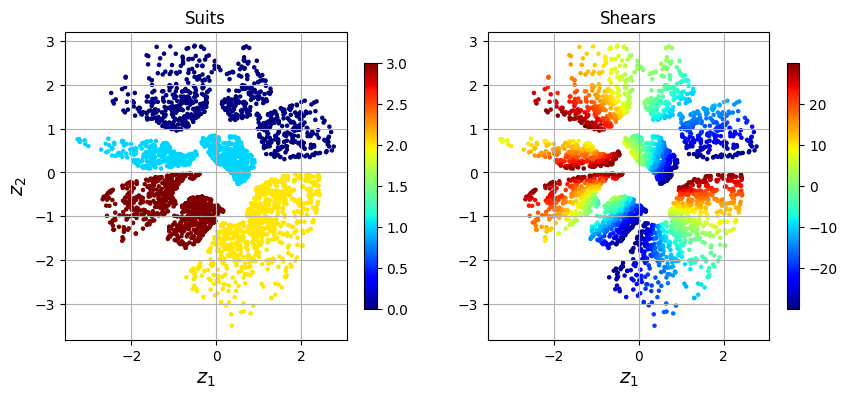

Epoch: 951 Training loss: 83.3453
Epoch: 952 Training loss: 83.0790
Epoch: 953 Training loss: 83.1453
Epoch: 954 Training loss: 82.8791
Epoch: 955 Training loss: 82.9454
Epoch: 956 Training loss: 82.9826
Epoch: 957 Training loss: 82.8717
Epoch: 958 Training loss: 82.9564
Epoch: 959 Training loss: 83.1603
Epoch: 960 Training loss: 83.2451
Epoch: 961 Training loss: 83.1324
Epoch: 962 Training loss: 83.0614
Epoch: 963 Training loss: 83.3303
Epoch: 964 Training loss: 83.0735
Epoch: 965 Training loss: 82.8862
Epoch: 966 Training loss: 83.0486
Epoch: 967 Training loss: 82.9858
Epoch: 968 Training loss: 83.0402
Epoch: 969 Training loss: 83.1995
Epoch: 970 Training loss: 83.5486
Epoch: 971 Training loss: 83.1324
Epoch: 972 Training loss: 83.1685
Epoch: 973 Training loss: 83.2756
Epoch: 974 Training loss: 83.1157
Epoch: 975 Training loss: 82.8241
Epoch: 976 Training loss: 82.8787
Epoch: 977 Training loss: 82.9040
Epoch: 978 Training loss: 82.8291
Epoch: 979 Training loss: 82.9222
Epoch: 980 Tra

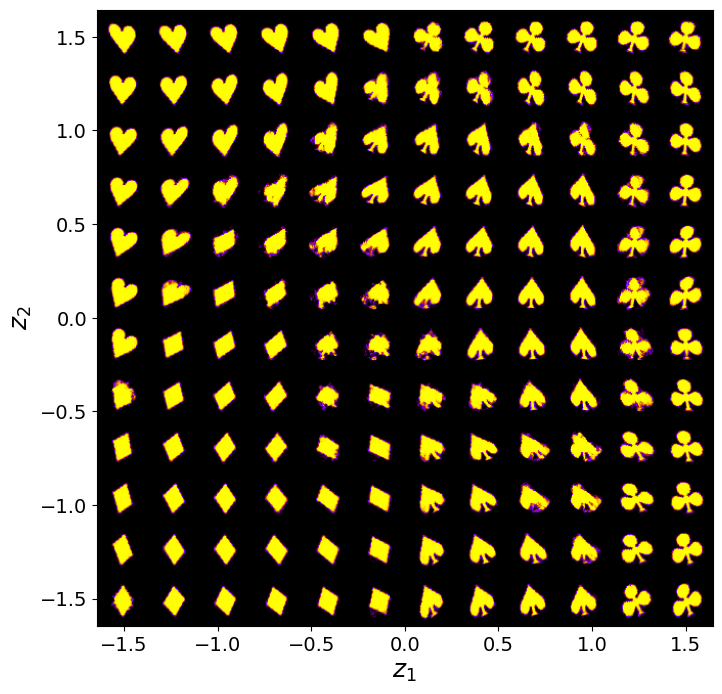

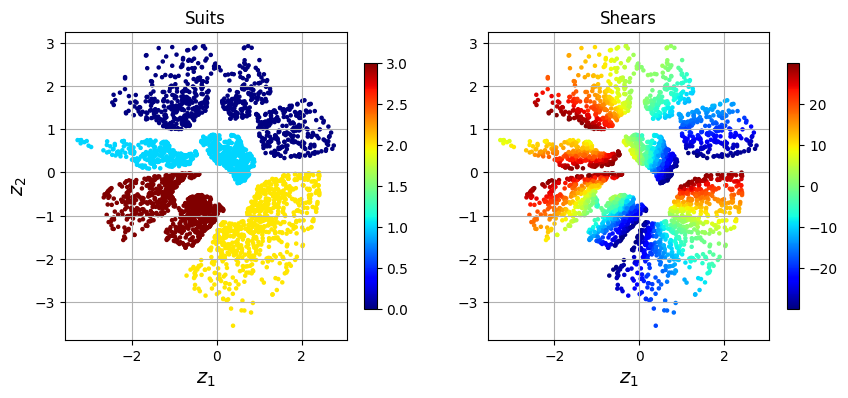

Epoch: 1001 Training loss: 82.7728
Epoch: 1002 Training loss: 82.9854
Epoch: 1003 Training loss: 82.9490
Epoch: 1004 Training loss: 83.0146
Epoch: 1005 Training loss: 83.1827
Epoch: 1006 Training loss: 83.0123
Epoch: 1007 Training loss: 83.4811
Epoch: 1008 Training loss: 82.9765
Epoch: 1009 Training loss: 83.0118
Epoch: 1010 Training loss: 83.0657
Epoch: 1011 Training loss: 83.3331
Epoch: 1012 Training loss: 82.8168
Epoch: 1013 Training loss: 82.6787
Epoch: 1014 Training loss: 82.7741
Epoch: 1015 Training loss: 82.7666
Epoch: 1016 Training loss: 83.1356
Epoch: 1017 Training loss: 82.8852
Epoch: 1018 Training loss: 82.8916
Epoch: 1019 Training loss: 82.8756
Epoch: 1020 Training loss: 82.8275
Epoch: 1021 Training loss: 83.1385
Epoch: 1022 Training loss: 82.7527
Epoch: 1023 Training loss: 82.6204
Epoch: 1024 Training loss: 82.6841
Epoch: 1025 Training loss: 82.7505
Epoch: 1026 Training loss: 83.1470
Epoch: 1027 Training loss: 83.1024
Epoch: 1028 Training loss: 83.0098
Epoch: 1029 Training

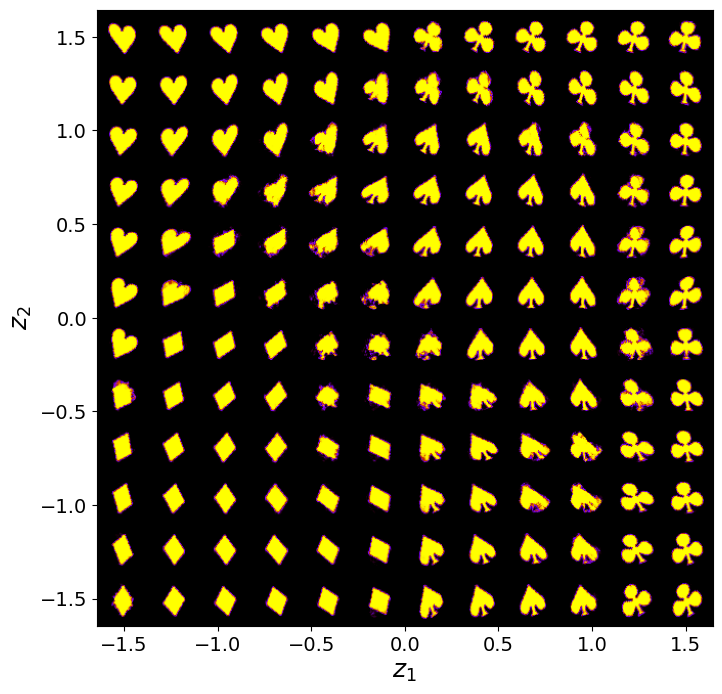

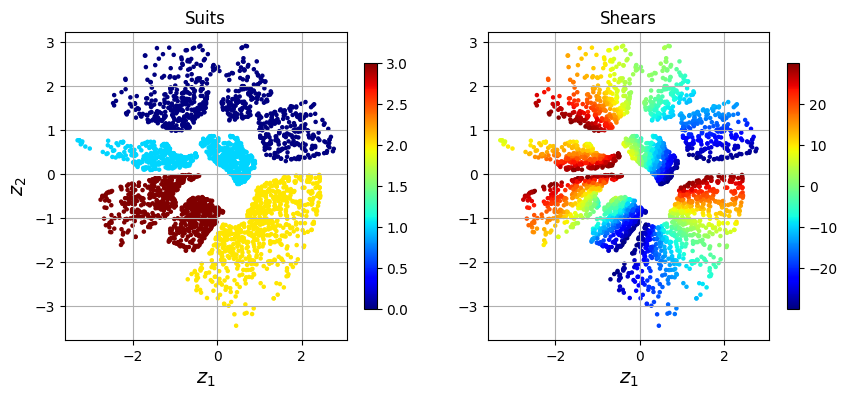

Epoch: 1051 Training loss: 82.9137
Epoch: 1052 Training loss: 82.6252
Epoch: 1053 Training loss: 82.5818
Epoch: 1054 Training loss: 82.6648
Epoch: 1055 Training loss: 82.8058
Epoch: 1056 Training loss: 82.7088
Epoch: 1057 Training loss: 82.6021
Epoch: 1058 Training loss: 82.8399
Epoch: 1059 Training loss: 82.7991
Epoch: 1060 Training loss: 82.7458
Epoch: 1061 Training loss: 82.9287
Epoch: 1062 Training loss: 83.1290
Epoch: 1063 Training loss: 82.7546
Epoch: 1064 Training loss: 82.7050
Epoch: 1065 Training loss: 82.8284
Epoch: 1066 Training loss: 82.7490
Epoch: 1067 Training loss: 82.6096
Epoch: 1068 Training loss: 82.6471
Epoch: 1069 Training loss: 82.7998
Epoch: 1070 Training loss: 82.6136
Epoch: 1071 Training loss: 82.7076
Epoch: 1072 Training loss: 82.4893
Epoch: 1073 Training loss: 82.6478
Epoch: 1074 Training loss: 82.9754
Epoch: 1075 Training loss: 82.6539
Epoch: 1076 Training loss: 82.6990
Epoch: 1077 Training loss: 82.7091
Epoch: 1078 Training loss: 83.2382
Epoch: 1079 Training

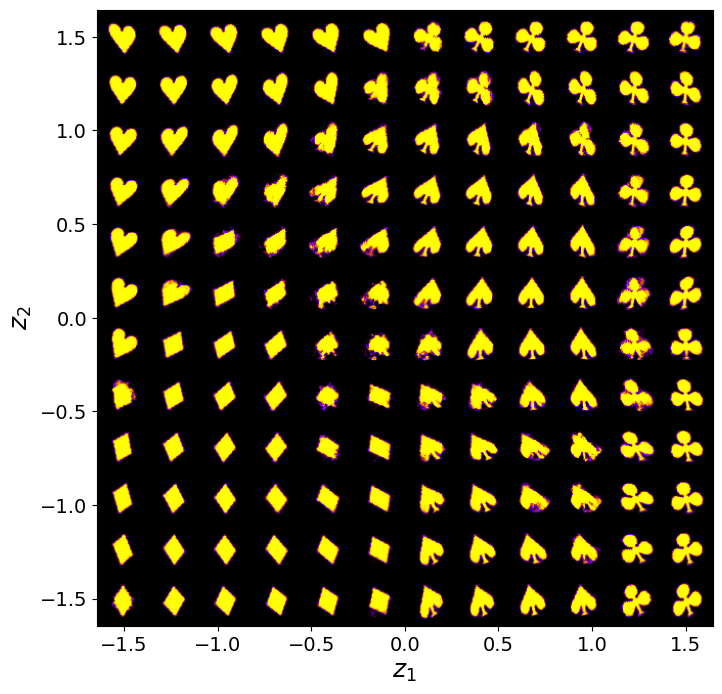

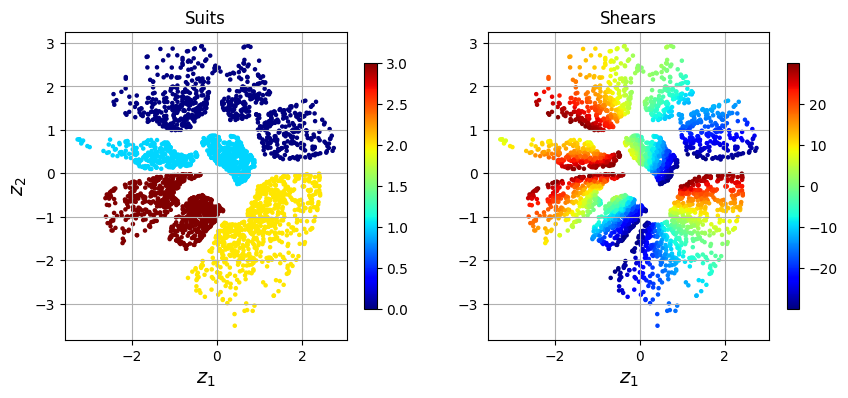

Epoch: 1101 Training loss: 82.6066
Epoch: 1102 Training loss: 82.4957
Epoch: 1103 Training loss: 82.6121
Epoch: 1104 Training loss: 82.6007
Epoch: 1105 Training loss: 82.5147
Epoch: 1106 Training loss: 82.5730
Epoch: 1107 Training loss: 82.7852
Epoch: 1108 Training loss: 82.8169
Epoch: 1109 Training loss: 82.6708
Epoch: 1110 Training loss: 82.7404
Epoch: 1111 Training loss: 82.4595
Epoch: 1112 Training loss: 82.6549
Epoch: 1113 Training loss: 82.6892
Epoch: 1114 Training loss: 82.7226
Epoch: 1115 Training loss: 82.5618
Epoch: 1116 Training loss: 82.5058
Epoch: 1117 Training loss: 82.6486
Epoch: 1118 Training loss: 82.5681
Epoch: 1119 Training loss: 82.5979
Epoch: 1120 Training loss: 82.6365
Epoch: 1121 Training loss: 83.1446
Epoch: 1122 Training loss: 82.9265
Epoch: 1123 Training loss: 82.6474
Epoch: 1124 Training loss: 82.5626
Epoch: 1125 Training loss: 82.4817
Epoch: 1126 Training loss: 82.6740
Epoch: 1127 Training loss: 82.5661
Epoch: 1128 Training loss: 82.4066
Epoch: 1129 Training

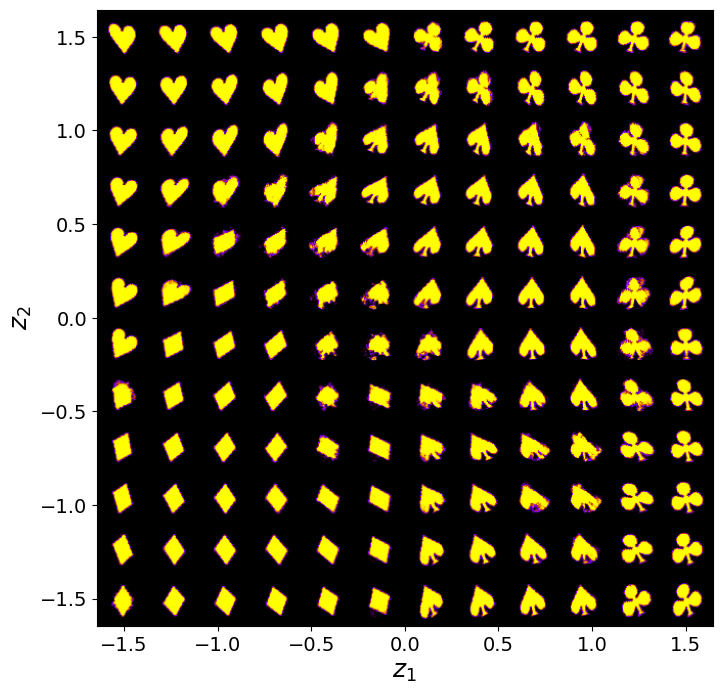

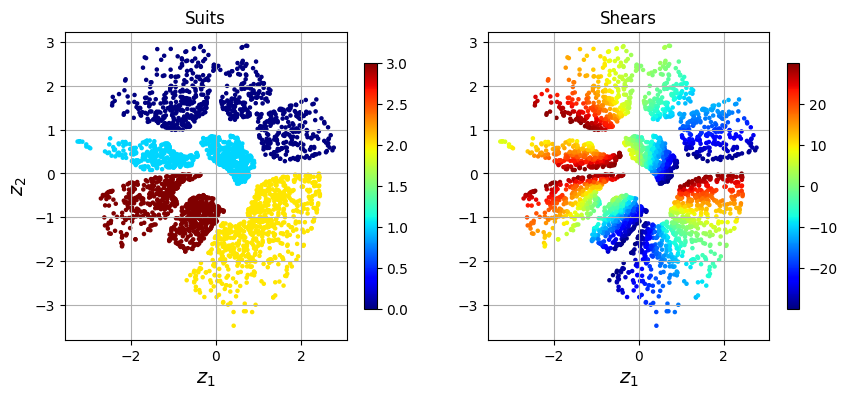

Epoch: 1151 Training loss: 82.5830
Epoch: 1152 Training loss: 82.5356
Epoch: 1153 Training loss: 82.4715
Epoch: 1154 Training loss: 82.3433
Epoch: 1155 Training loss: 82.3898
Epoch: 1156 Training loss: 82.3076
Epoch: 1157 Training loss: 82.4532
Epoch: 1158 Training loss: 82.7367
Epoch: 1159 Training loss: 82.4042
Epoch: 1160 Training loss: 82.5762
Epoch: 1161 Training loss: 82.4630
Epoch: 1162 Training loss: 82.4772
Epoch: 1163 Training loss: 82.3685
Epoch: 1164 Training loss: 82.4492
Epoch: 1165 Training loss: 82.4591
Epoch: 1166 Training loss: 82.4288
Epoch: 1167 Training loss: 82.5612
Epoch: 1168 Training loss: 82.6591
Epoch: 1169 Training loss: 82.5854
Epoch: 1170 Training loss: 82.4687
Epoch: 1171 Training loss: 82.6311
Epoch: 1172 Training loss: 82.4402
Epoch: 1173 Training loss: 82.5808
Epoch: 1174 Training loss: 82.3933
Epoch: 1175 Training loss: 82.3505
Epoch: 1176 Training loss: 82.3171
Epoch: 1177 Training loss: 82.6379
Epoch: 1178 Training loss: 82.5833
Epoch: 1179 Training

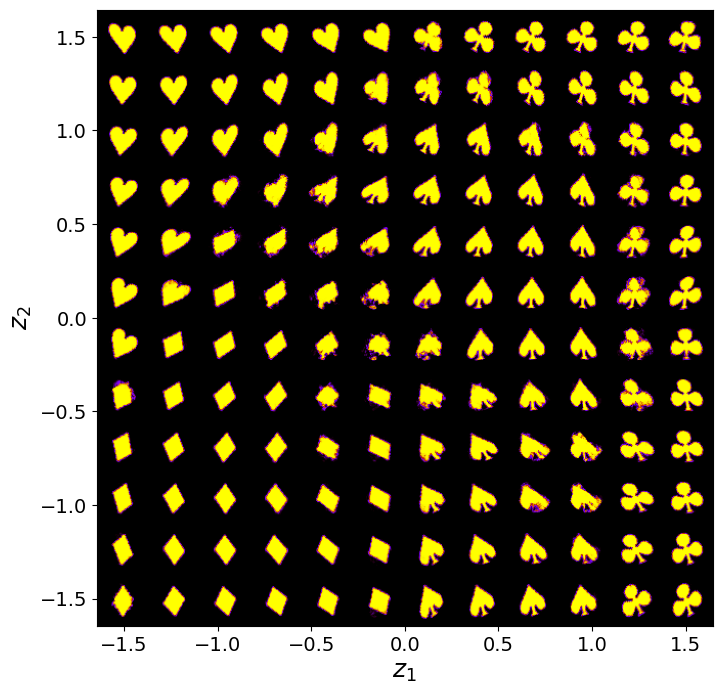

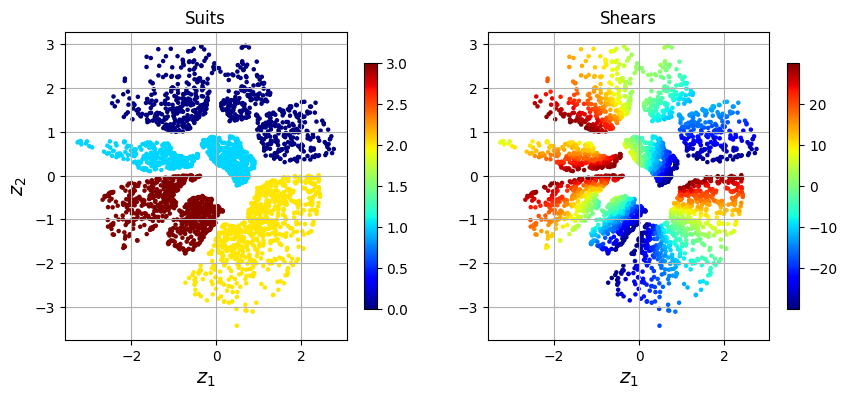

Epoch: 1201 Training loss: 82.8914
Epoch: 1202 Training loss: 82.6366
Epoch: 1203 Training loss: 82.5976
Epoch: 1204 Training loss: 82.3194
Epoch: 1205 Training loss: 82.3247
Epoch: 1206 Training loss: 82.3009
Epoch: 1207 Training loss: 82.4639
Epoch: 1208 Training loss: 82.4821
Epoch: 1209 Training loss: 82.5530
Epoch: 1210 Training loss: 82.3824
Epoch: 1211 Training loss: 82.5144
Epoch: 1212 Training loss: 82.7120
Epoch: 1213 Training loss: 82.6871
Epoch: 1214 Training loss: 82.4718
Epoch: 1215 Training loss: 82.4719
Epoch: 1216 Training loss: 82.3219
Epoch: 1217 Training loss: 82.3676
Epoch: 1218 Training loss: 82.4950
Epoch: 1219 Training loss: 82.2774
Epoch: 1220 Training loss: 82.4717
Epoch: 1221 Training loss: 82.5184
Epoch: 1222 Training loss: 82.4731
Epoch: 1223 Training loss: 82.4438
Epoch: 1224 Training loss: 82.3777
Epoch: 1225 Training loss: 82.3168
Epoch: 1226 Training loss: 82.1968
Epoch: 1227 Training loss: 82.2849
Epoch: 1228 Training loss: 82.3476
Epoch: 1229 Training

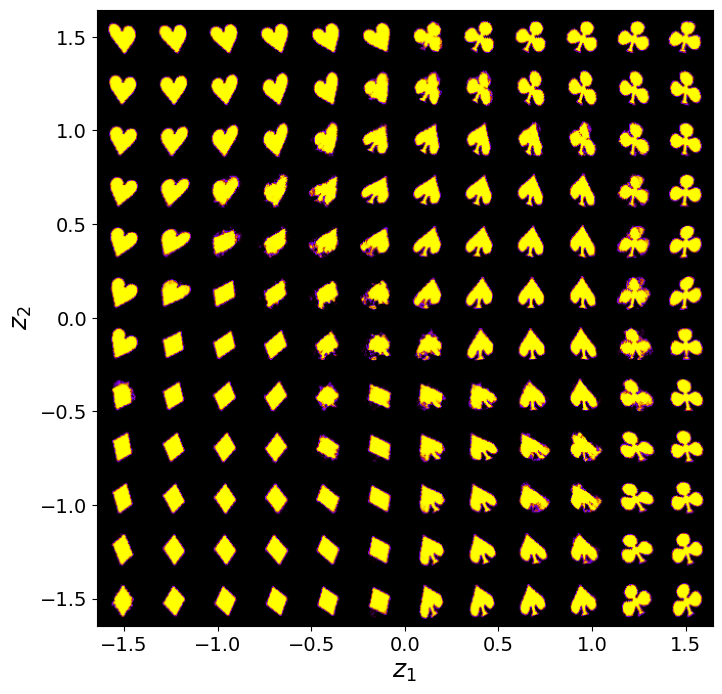

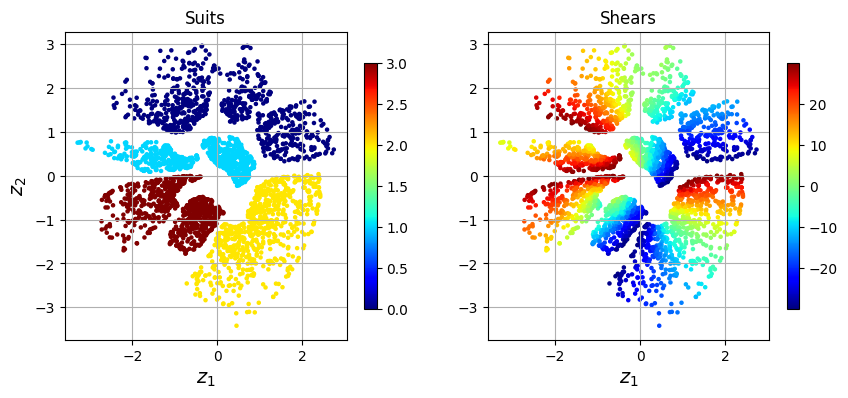

Epoch: 1251 Training loss: 82.2930
Epoch: 1252 Training loss: 82.0960
Epoch: 1253 Training loss: 82.5221
Epoch: 1254 Training loss: 82.2487
Epoch: 1255 Training loss: 82.0801
Epoch: 1256 Training loss: 82.3910
Epoch: 1257 Training loss: 82.5348
Epoch: 1258 Training loss: 82.6942
Epoch: 1259 Training loss: 82.5882
Epoch: 1260 Training loss: 82.3005
Epoch: 1261 Training loss: 82.2337
Epoch: 1262 Training loss: 82.3579
Epoch: 1263 Training loss: 82.2310
Epoch: 1264 Training loss: 82.3849
Epoch: 1265 Training loss: 82.6159
Epoch: 1266 Training loss: 82.3124
Epoch: 1267 Training loss: 82.1811
Epoch: 1268 Training loss: 82.1113
Epoch: 1269 Training loss: 82.2532
Epoch: 1270 Training loss: 82.1546
Epoch: 1271 Training loss: 82.0885
Epoch: 1272 Training loss: 82.2143
Epoch: 1273 Training loss: 82.1473
Epoch: 1274 Training loss: 82.1804
Epoch: 1275 Training loss: 82.2594
Epoch: 1276 Training loss: 82.3508
Epoch: 1277 Training loss: 82.5178
Epoch: 1278 Training loss: 82.8913
Epoch: 1279 Training

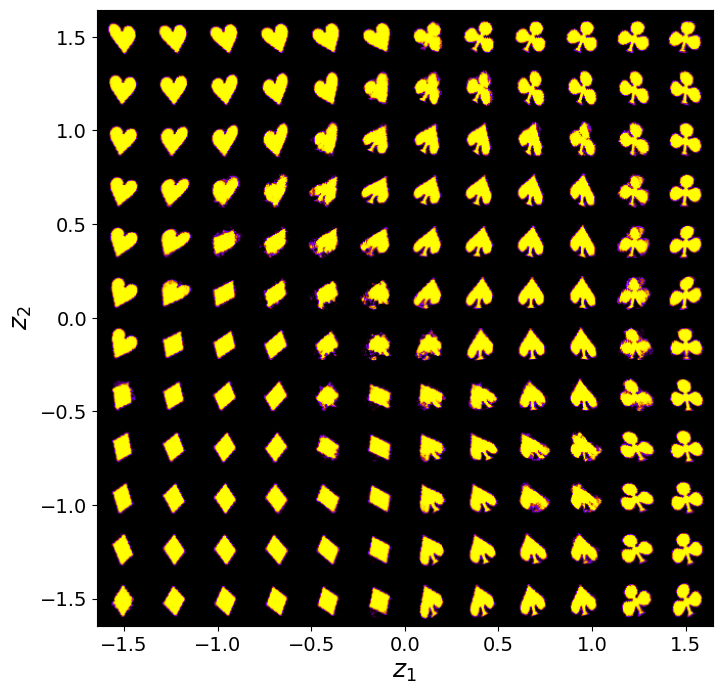

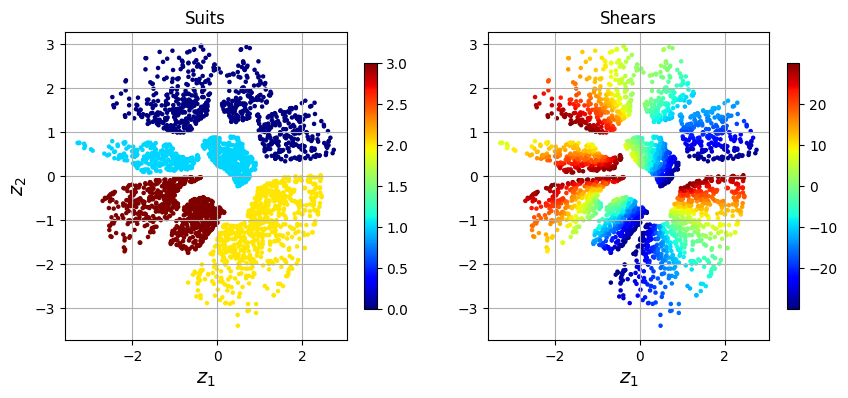

Epoch: 1301 Training loss: 82.2346
Epoch: 1302 Training loss: 82.0480
Epoch: 1303 Training loss: 82.5306
Epoch: 1304 Training loss: 82.4756
Epoch: 1305 Training loss: 82.1492
Epoch: 1306 Training loss: 82.2552
Epoch: 1307 Training loss: 82.4309
Epoch: 1308 Training loss: 82.1550
Epoch: 1309 Training loss: 82.3670
Epoch: 1310 Training loss: 82.3066
Epoch: 1311 Training loss: 82.2340
Epoch: 1312 Training loss: 82.2051
Epoch: 1313 Training loss: 82.0545
Epoch: 1314 Training loss: 82.1533
Epoch: 1315 Training loss: 82.0411
Epoch: 1316 Training loss: 82.3296
Epoch: 1317 Training loss: 82.6657
Epoch: 1318 Training loss: 82.3088
Epoch: 1319 Training loss: 82.2451
Epoch: 1320 Training loss: 82.3365
Epoch: 1321 Training loss: 81.9823
Epoch: 1322 Training loss: 82.0211
Epoch: 1323 Training loss: 82.0725
Epoch: 1324 Training loss: 82.1431
Epoch: 1325 Training loss: 82.4537
Epoch: 1326 Training loss: 82.7784
Epoch: 1327 Training loss: 82.3476
Epoch: 1328 Training loss: 82.0513
Epoch: 1329 Training

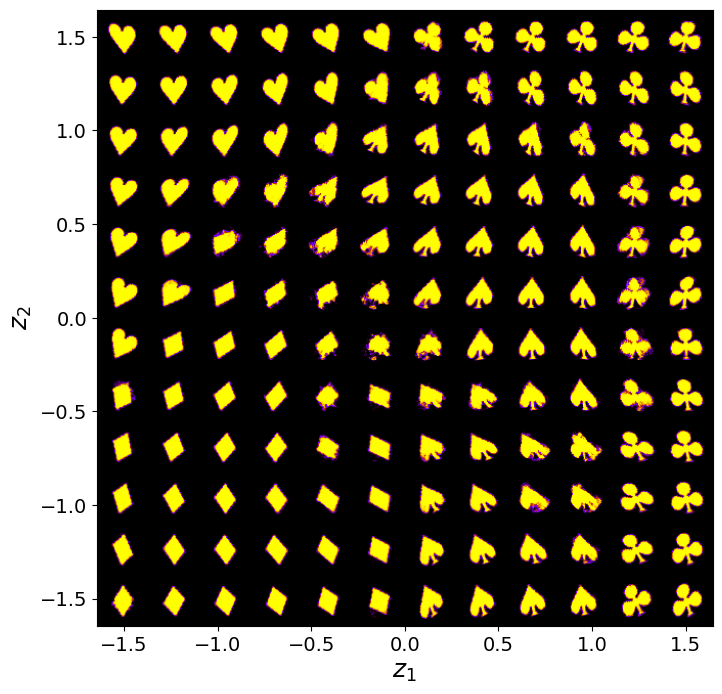

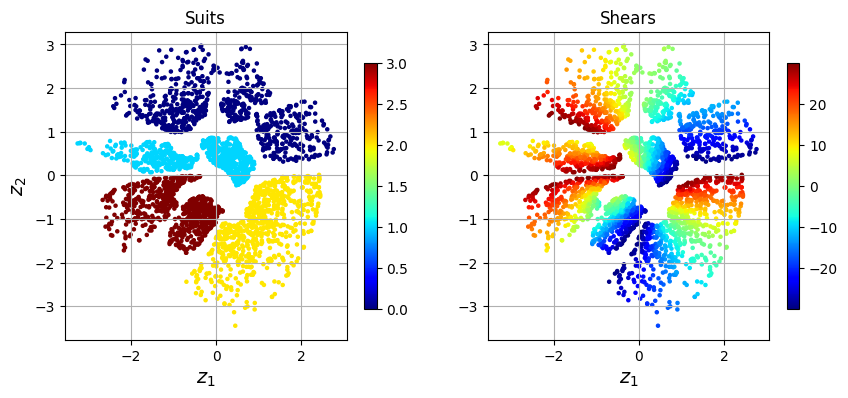

Epoch: 1351 Training loss: 82.3150
Epoch: 1352 Training loss: 82.4504
Epoch: 1353 Training loss: 82.4228
Epoch: 1354 Training loss: 82.6221
Epoch: 1355 Training loss: 82.3909
Epoch: 1356 Training loss: 82.3120
Epoch: 1357 Training loss: 82.8454
Epoch: 1358 Training loss: 82.1255
Epoch: 1359 Training loss: 82.1323
Epoch: 1360 Training loss: 81.9133
Epoch: 1361 Training loss: 81.9927
Epoch: 1362 Training loss: 81.9578
Epoch: 1363 Training loss: 82.0517
Epoch: 1364 Training loss: 82.1886
Epoch: 1365 Training loss: 82.1838
Epoch: 1366 Training loss: 82.2247
Epoch: 1367 Training loss: 82.1156
Epoch: 1368 Training loss: 82.6205
Epoch: 1369 Training loss: 82.3617
Epoch: 1370 Training loss: 81.8981
Epoch: 1371 Training loss: 81.9739
Epoch: 1372 Training loss: 81.9698
Epoch: 1373 Training loss: 82.0070
Epoch: 1374 Training loss: 82.3813
Epoch: 1375 Training loss: 82.2609
Epoch: 1376 Training loss: 82.1019
Epoch: 1377 Training loss: 82.0506
Epoch: 1378 Training loss: 82.0292
Epoch: 1379 Training

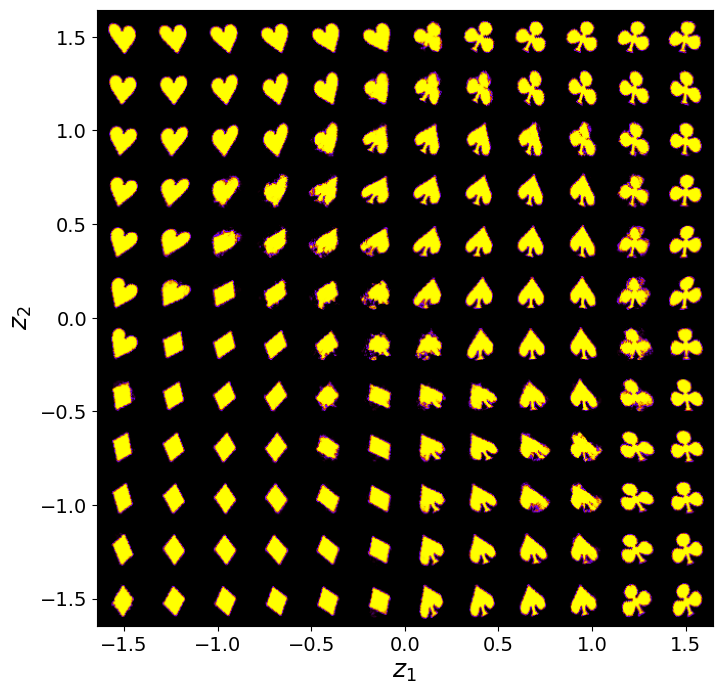

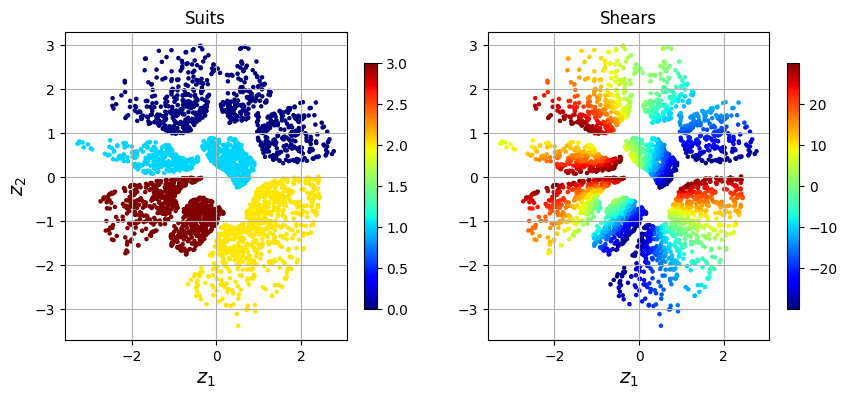

Epoch: 1401 Training loss: 81.9613
Epoch: 1402 Training loss: 81.9780
Epoch: 1403 Training loss: 81.9259
Epoch: 1404 Training loss: 82.1133
Epoch: 1405 Training loss: 82.1501
Epoch: 1406 Training loss: 81.9922
Epoch: 1407 Training loss: 82.1881
Epoch: 1408 Training loss: 82.7484
Epoch: 1409 Training loss: 82.3463
Epoch: 1410 Training loss: 82.1947
Epoch: 1411 Training loss: 82.2937
Epoch: 1412 Training loss: 82.7469
Epoch: 1413 Training loss: 82.1680
Epoch: 1414 Training loss: 82.0915
Epoch: 1415 Training loss: 81.9263
Epoch: 1416 Training loss: 81.8345
Epoch: 1417 Training loss: 81.8781
Epoch: 1418 Training loss: 82.0617
Epoch: 1419 Training loss: 82.0762
Epoch: 1420 Training loss: 82.5048
Epoch: 1421 Training loss: 82.2278
Epoch: 1422 Training loss: 82.2541
Epoch: 1423 Training loss: 81.8329
Epoch: 1424 Training loss: 82.1434
Epoch: 1425 Training loss: 82.2611
Epoch: 1426 Training loss: 82.0692
Epoch: 1427 Training loss: 82.0806
Epoch: 1428 Training loss: 81.9842
Epoch: 1429 Training

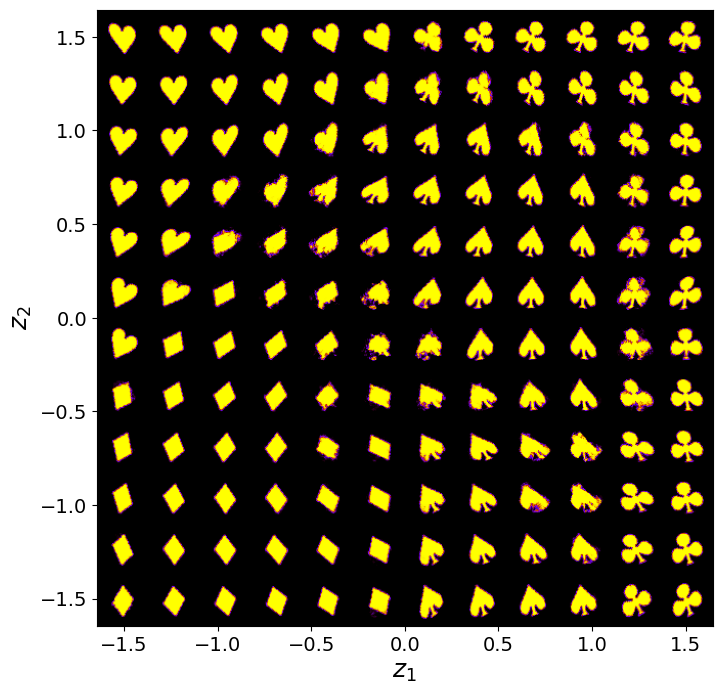

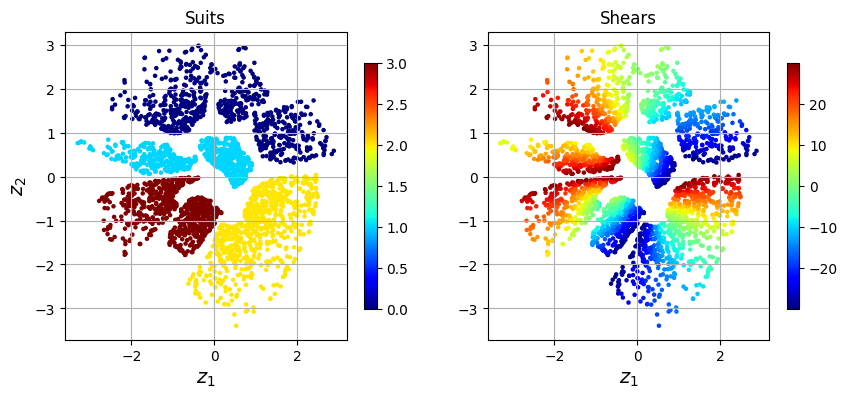

Epoch: 1451 Training loss: 81.8320
Epoch: 1452 Training loss: 81.7956
Epoch: 1453 Training loss: 82.0072
Epoch: 1454 Training loss: 81.8539
Epoch: 1455 Training loss: 81.9541
Epoch: 1456 Training loss: 82.1319
Epoch: 1457 Training loss: 82.3543
Epoch: 1458 Training loss: 82.2294
Epoch: 1459 Training loss: 82.1701
Epoch: 1460 Training loss: 81.9871
Epoch: 1461 Training loss: 82.3087
Epoch: 1462 Training loss: 82.1725
Epoch: 1463 Training loss: 81.9403
Epoch: 1464 Training loss: 82.0309
Epoch: 1465 Training loss: 81.8495
Epoch: 1466 Training loss: 82.1811
Epoch: 1467 Training loss: 82.3970
Epoch: 1468 Training loss: 82.1582
Epoch: 1469 Training loss: 81.7935
Epoch: 1470 Training loss: 81.9656
Epoch: 1471 Training loss: 81.8203
Epoch: 1472 Training loss: 81.7371
Epoch: 1473 Training loss: 81.9410
Epoch: 1474 Training loss: 82.0148
Epoch: 1475 Training loss: 81.8400
Epoch: 1476 Training loss: 82.0485
Epoch: 1477 Training loss: 82.0817
Epoch: 1478 Training loss: 82.1558
Epoch: 1479 Training

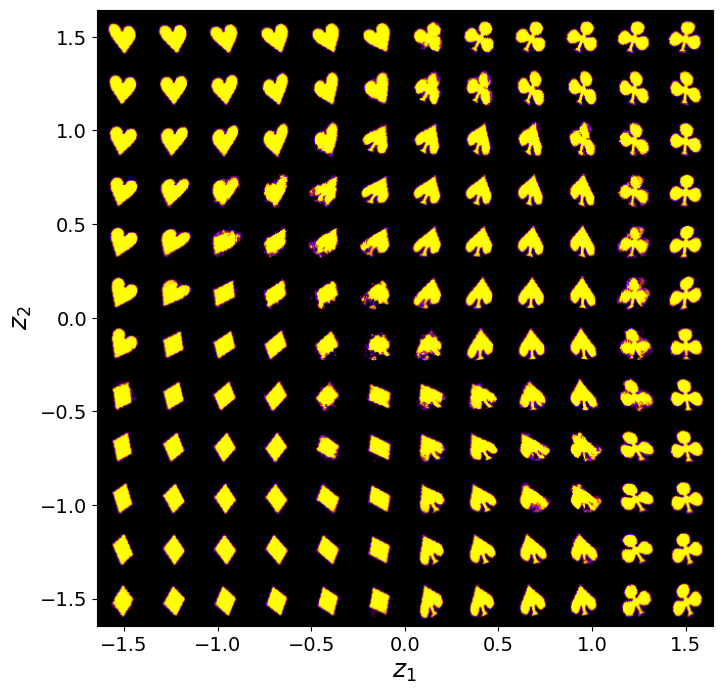

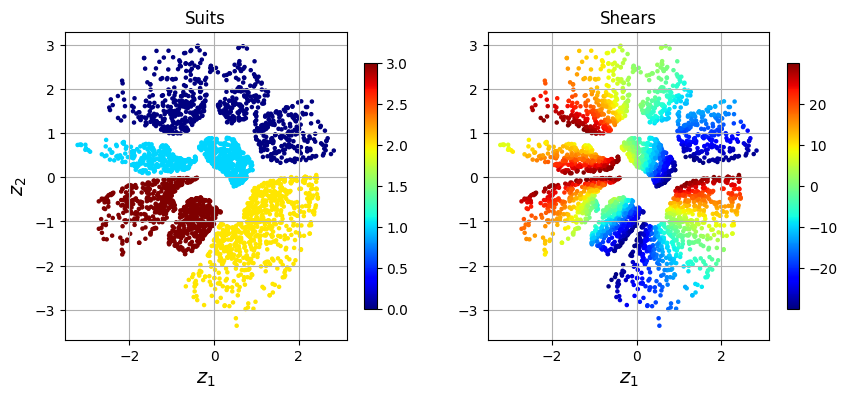

In [10]:
figs = []
for e in range(1500):
    trainer.step(dataloader, train_vae=True)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
        model.manifold2d(d=12)
        z_loc, _ = model.encode(cards_all.reshape(-1, ws* ws))

        fig,ax = plt.subplots(1,2, figsize=(10,4))

        im = ax[0].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=labels_all, cmap='jet')
        cbar = fig.colorbar(im, ax=ax[0], shrink=.8)
        im = ax[1].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=angles_all, cmap='jet')
        cbar = fig.colorbar(im, ax=ax[1], shrink=.8)

        for _ in ax:
          _.set_xlabel('$z_1$', fontsize=14)
          _.grid()

        ax[0].set_title('Suits')
        ax[1].set_title('Shears')
        ax[0].set_ylabel('$z_2$', fontsize=14)

        plt.show()
        figs.append(fig)


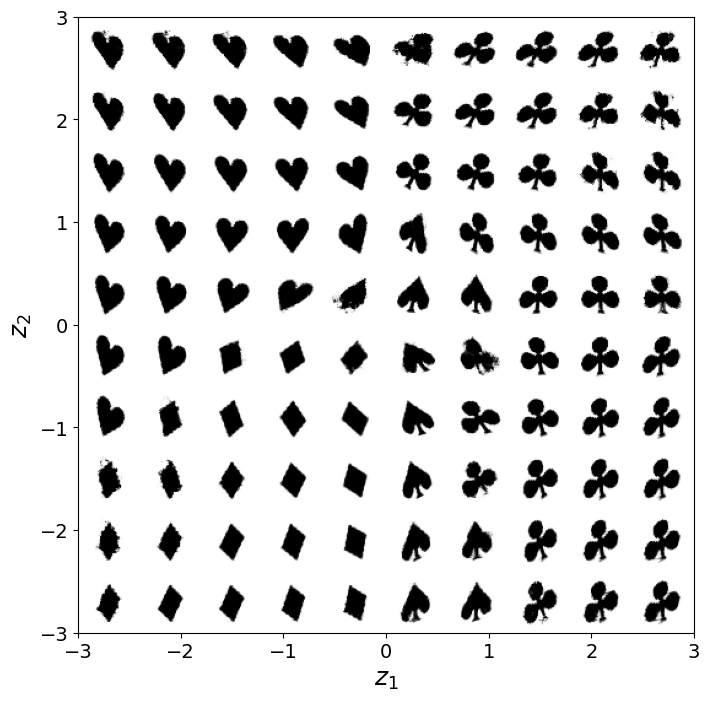

In [11]:
mf = model.manifold2d(d=10, cmap='binary', z_coord=[-3,3,-3,3], dpi=50)

mf_np = rearrange_manifold(mf)

<ipython-input-12-6a5f3f68ff0b>:16: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  scatter = ax[1].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),


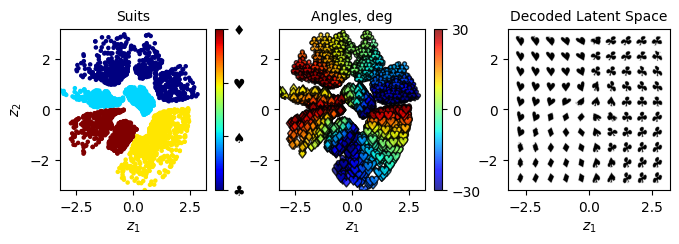

In [12]:
suits = ['♣', '♠', '♥', '♦', ]  # Card suits
suit_markers = {0: '♣', 1: '♠', 2: '♥', 3: '♦'}
z_loc, _ = model.encode(cards_all.reshape(-1, ws* ws))


fig,ax = plt.subplots(1,3, figsize=(8,2.1))

im = ax[0].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=labels_all, cmap='jet')
cbar = fig.colorbar(im, ax=ax[0])
cbar.set_ticks(np.linspace(0, 3, len(suits)))  # Set positions of labels
cbar.set_ticklabels(suits)
ax[0].set_title('Suits', fontsize=10)

for suit_id, suit_marker in suit_markers.items():
  indices = np.where(labels_all == suit_id)
  scatter = ax[1].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),
             label=suit_marker, s=40, alpha=0.8, edgecolors='black',
             marker='$' + suit_marker + '$',
             c = angles_all[indices],
             vmin=-30,
             vmax=30,
             cmap='jet')

# im = ax[1].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=angles_all, cmap='jet')
cbar = fig.colorbar(scatter, ax=ax[1])
cbar.set_ticks([-30,0,30])
ax[1].set_title('Angles, deg', fontsize=10)

# Add the large plot on the left
ax[2].imshow(mf_np, cmap='binary', extent = [-3,3,-3,3])
ax[2].set_title('Decoded Latent Space', fontsize=10)

ax[0].set_xlabel('$z_1$', fontsize=10)
ax[1].set_xlabel('$z_1$', fontsize=10)
ax[2].set_xlabel('$z_1$', fontsize=10)
ax[0].set_ylabel('$z_2$', fontsize=10)

for _ in ax:
  _.set_xlim(-3.2,3.2)
  _.set_ylim(-3.2,3.2)

#plt.tight_layout()
#fig.savefig('full_vae.jpg', dpi=300, bbox_inches='tight')

#3. Train the VAE model on the subset

In [13]:
threshold = 0
threshold1 = 15
cards_train = cards_all[(angles_all < threshold) | (angles_all > threshold1)]
labels_train = labels_all[(angles_all < threshold) | (angles_all > threshold1)]
translations_train = translations_all[(angles_all < threshold) | (angles_all > threshold1)]
shears_train = shears_all[(angles_all < threshold) | (angles_all > threshold1)]
angles_train = angles_all[(angles_all < threshold) | (angles_all > threshold1)]

cards_test = cards_all[(angles_all > threshold) & (angles_all < threshold1)]
labels_test = labels_all[(angles_all > threshold) & (angles_all < threshold1)]
translations_test = translations_all[(angles_all > threshold) & (angles_all < threshold1)]
shears_test = shears_all[(angles_all > threshold) & (angles_all < threshold1)]
angles_test = angles_all[(angles_all > threshold) & (angles_all < threshold1)]

Text(0, 0.5, 'Counts')

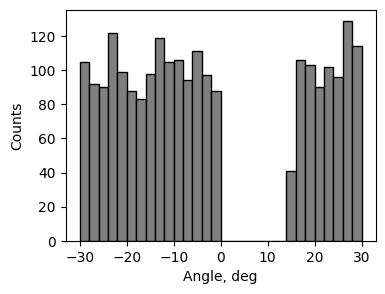

In [24]:
fig = plt.figure(figsize=(4,3))
_ = plt.hist(angles_train, bins=30, range=(-30,30), edgecolor='black', color='grey')
plt.xlabel('Angle, deg')
plt.ylabel('Counts')

In [25]:
ws = 48
data_dim = (ws, ws)

model = pv.models.iVAE(data_dim, 2)
trainer = pv.trainers.SVItrainer(model)
dataloader = pv.utils.init_dataloader(cards_train.reshape(-1, ws* ws), batch_size=100)

Epoch: 1 Training loss: 1095.6171
Epoch: 2 Training loss: 442.2920
Epoch: 3 Training loss: 397.3490
Epoch: 4 Training loss: 391.2451
Epoch: 5 Training loss: 386.5200
Epoch: 6 Training loss: 382.1843
Epoch: 7 Training loss: 378.3032
Epoch: 8 Training loss: 370.5542
Epoch: 9 Training loss: 356.4378
Epoch: 10 Training loss: 342.6829
Epoch: 11 Training loss: 333.0914
Epoch: 12 Training loss: 323.2520
Epoch: 13 Training loss: 311.0042
Epoch: 14 Training loss: 294.4996
Epoch: 15 Training loss: 278.1436
Epoch: 16 Training loss: 264.8929
Epoch: 17 Training loss: 253.9463
Epoch: 18 Training loss: 245.1744
Epoch: 19 Training loss: 238.3692
Epoch: 20 Training loss: 232.8920
Epoch: 21 Training loss: 227.8672
Epoch: 22 Training loss: 223.5914
Epoch: 23 Training loss: 219.7348
Epoch: 24 Training loss: 216.3457
Epoch: 25 Training loss: 212.4395
Epoch: 26 Training loss: 209.3079
Epoch: 27 Training loss: 206.4986
Epoch: 28 Training loss: 203.8253
Epoch: 29 Training loss: 201.5464
Epoch: 30 Training los

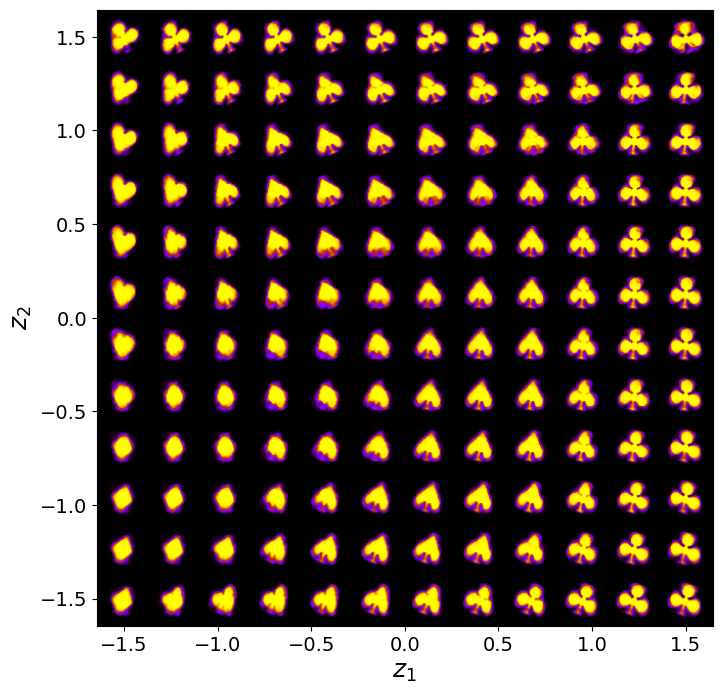

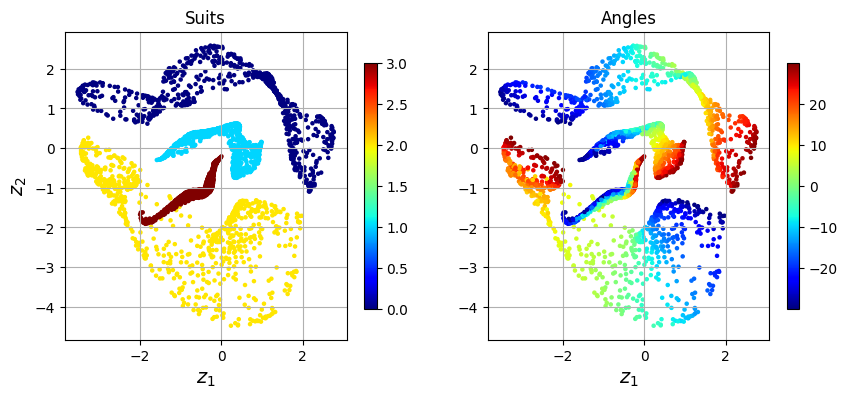

Epoch: 51 Training loss: 163.2067
Epoch: 52 Training loss: 162.0797
Epoch: 53 Training loss: 160.6324
Epoch: 54 Training loss: 159.6643
Epoch: 55 Training loss: 158.3307
Epoch: 56 Training loss: 157.2377
Epoch: 57 Training loss: 155.9595
Epoch: 58 Training loss: 154.7080
Epoch: 59 Training loss: 153.4764
Epoch: 60 Training loss: 152.3947
Epoch: 61 Training loss: 151.7441
Epoch: 62 Training loss: 150.1267
Epoch: 63 Training loss: 148.9503
Epoch: 64 Training loss: 148.3642
Epoch: 65 Training loss: 147.4227
Epoch: 66 Training loss: 146.1408
Epoch: 67 Training loss: 145.0748
Epoch: 68 Training loss: 143.9980
Epoch: 69 Training loss: 142.9405
Epoch: 70 Training loss: 142.0883
Epoch: 71 Training loss: 141.0345
Epoch: 72 Training loss: 140.3413
Epoch: 73 Training loss: 139.2293
Epoch: 74 Training loss: 138.5989
Epoch: 75 Training loss: 137.5668
Epoch: 76 Training loss: 136.6743
Epoch: 77 Training loss: 135.6659
Epoch: 78 Training loss: 134.9259
Epoch: 79 Training loss: 134.1588
Epoch: 80 Trai

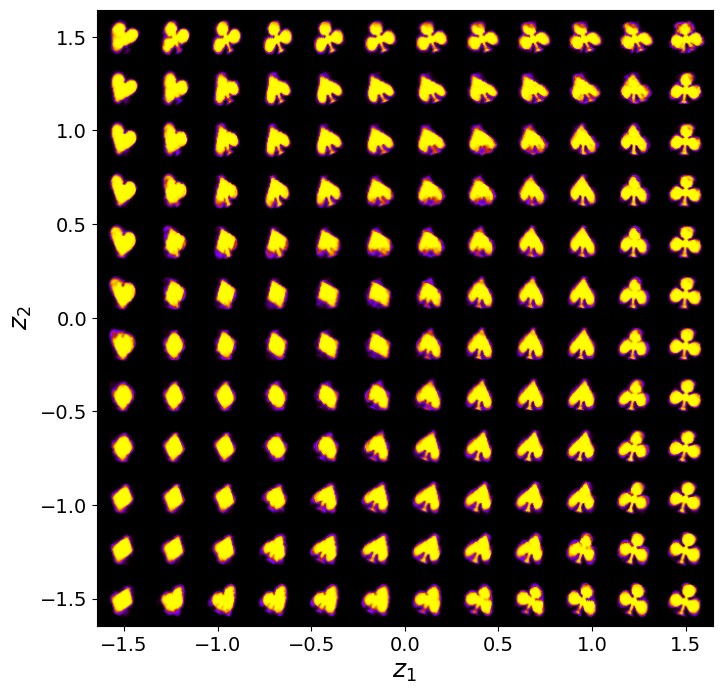

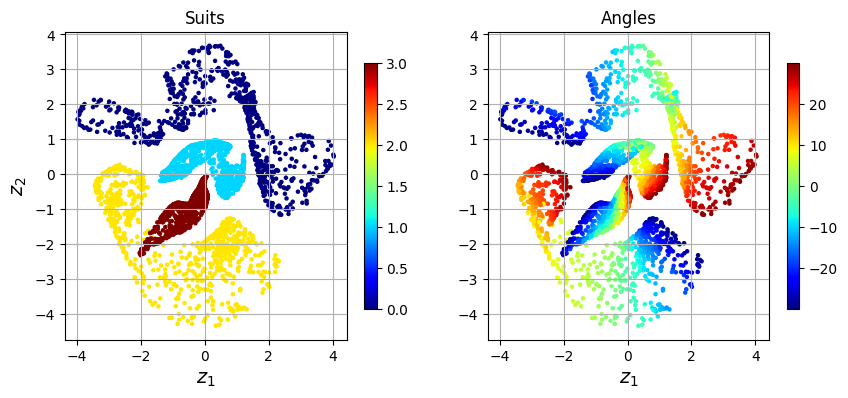

Epoch: 101 Training loss: 120.2207
Epoch: 102 Training loss: 119.6711
Epoch: 103 Training loss: 119.7173
Epoch: 104 Training loss: 118.9980
Epoch: 105 Training loss: 118.4409
Epoch: 106 Training loss: 118.4041
Epoch: 107 Training loss: 118.4167
Epoch: 108 Training loss: 117.2889
Epoch: 109 Training loss: 116.4813
Epoch: 110 Training loss: 116.2343
Epoch: 111 Training loss: 115.8314
Epoch: 112 Training loss: 116.1788
Epoch: 113 Training loss: 115.3839
Epoch: 114 Training loss: 114.3940
Epoch: 115 Training loss: 113.9945
Epoch: 116 Training loss: 113.5059
Epoch: 117 Training loss: 113.2581
Epoch: 118 Training loss: 112.8684
Epoch: 119 Training loss: 112.7548
Epoch: 120 Training loss: 112.7679
Epoch: 121 Training loss: 112.1361
Epoch: 122 Training loss: 111.4326
Epoch: 123 Training loss: 111.2759
Epoch: 124 Training loss: 110.9859
Epoch: 125 Training loss: 110.5585
Epoch: 126 Training loss: 110.2323
Epoch: 127 Training loss: 109.8532
Epoch: 128 Training loss: 109.5430
Epoch: 129 Training 

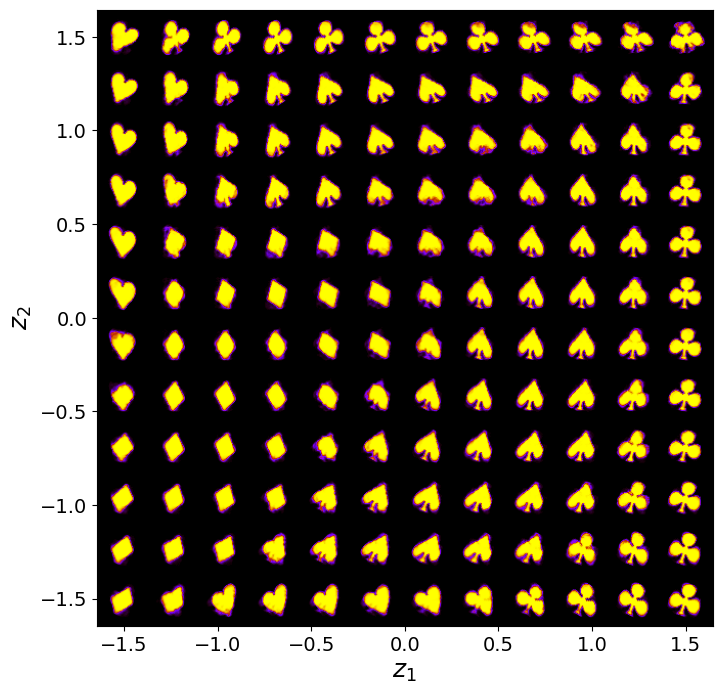

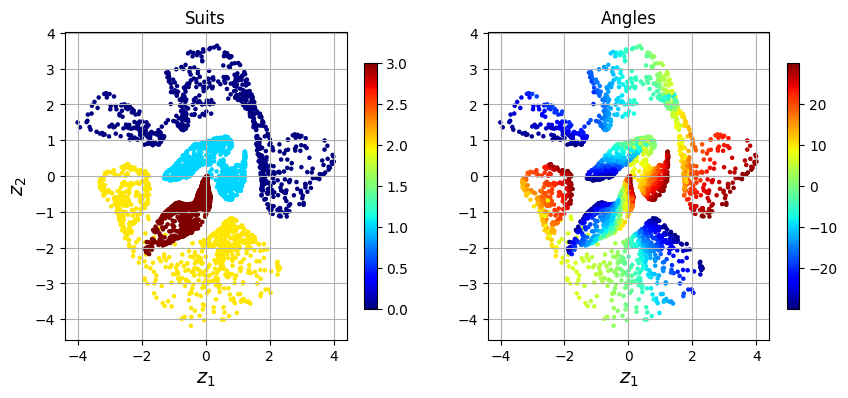

Epoch: 151 Training loss: 104.4124
Epoch: 152 Training loss: 103.9072
Epoch: 153 Training loss: 103.6594
Epoch: 154 Training loss: 103.7854
Epoch: 155 Training loss: 103.4078
Epoch: 156 Training loss: 103.0727
Epoch: 157 Training loss: 103.2145
Epoch: 158 Training loss: 103.1832
Epoch: 159 Training loss: 102.6988
Epoch: 160 Training loss: 102.9791
Epoch: 161 Training loss: 102.2889
Epoch: 162 Training loss: 102.4575
Epoch: 163 Training loss: 102.1641
Epoch: 164 Training loss: 101.7121
Epoch: 165 Training loss: 101.4801
Epoch: 166 Training loss: 101.1504
Epoch: 167 Training loss: 101.0071
Epoch: 168 Training loss: 101.3848
Epoch: 169 Training loss: 101.2088
Epoch: 170 Training loss: 100.8903
Epoch: 171 Training loss: 100.7991
Epoch: 172 Training loss: 100.5681
Epoch: 173 Training loss: 100.9346
Epoch: 174 Training loss: 100.0878
Epoch: 175 Training loss: 100.2474
Epoch: 176 Training loss: 99.9559
Epoch: 177 Training loss: 100.1071
Epoch: 178 Training loss: 99.9068
Epoch: 179 Training lo

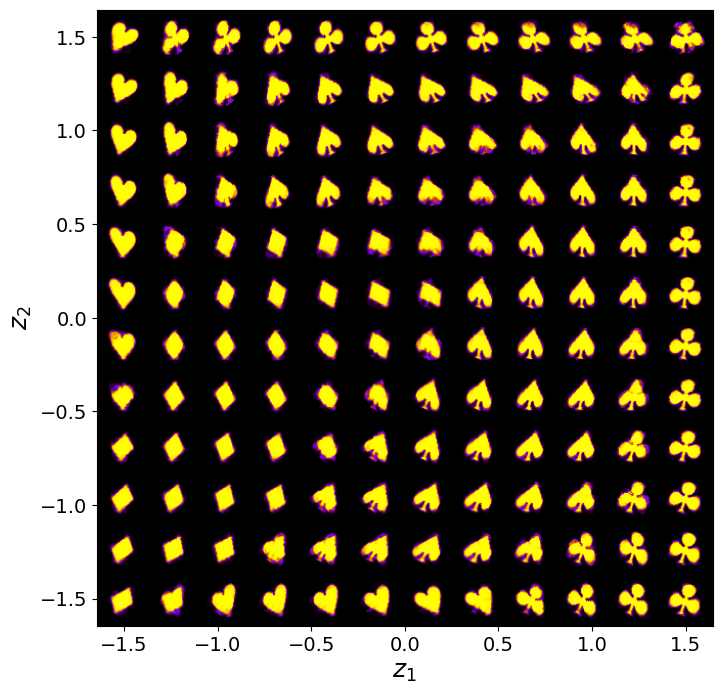

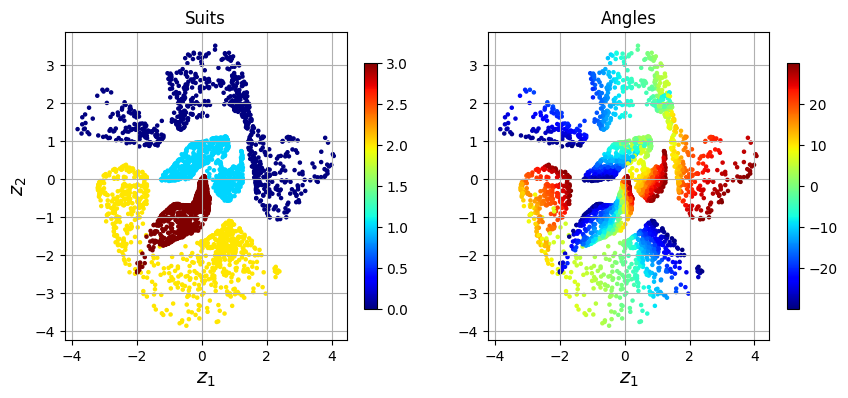

Epoch: 201 Training loss: 96.5862
Epoch: 202 Training loss: 96.7124
Epoch: 203 Training loss: 96.6559
Epoch: 204 Training loss: 96.8967
Epoch: 205 Training loss: 96.5819
Epoch: 206 Training loss: 96.4738
Epoch: 207 Training loss: 96.1011
Epoch: 208 Training loss: 95.8478
Epoch: 209 Training loss: 95.8247
Epoch: 210 Training loss: 95.8027
Epoch: 211 Training loss: 95.7613
Epoch: 212 Training loss: 95.7733
Epoch: 213 Training loss: 95.6552
Epoch: 214 Training loss: 95.3720
Epoch: 215 Training loss: 95.1839
Epoch: 216 Training loss: 95.3206
Epoch: 217 Training loss: 95.3095
Epoch: 218 Training loss: 95.0379
Epoch: 219 Training loss: 95.4031
Epoch: 220 Training loss: 95.6601
Epoch: 221 Training loss: 95.0605
Epoch: 222 Training loss: 96.1682
Epoch: 223 Training loss: 94.7956
Epoch: 224 Training loss: 94.7013
Epoch: 225 Training loss: 94.5244
Epoch: 226 Training loss: 94.2867
Epoch: 227 Training loss: 94.0841
Epoch: 228 Training loss: 94.2189
Epoch: 229 Training loss: 94.2024
Epoch: 230 Tra

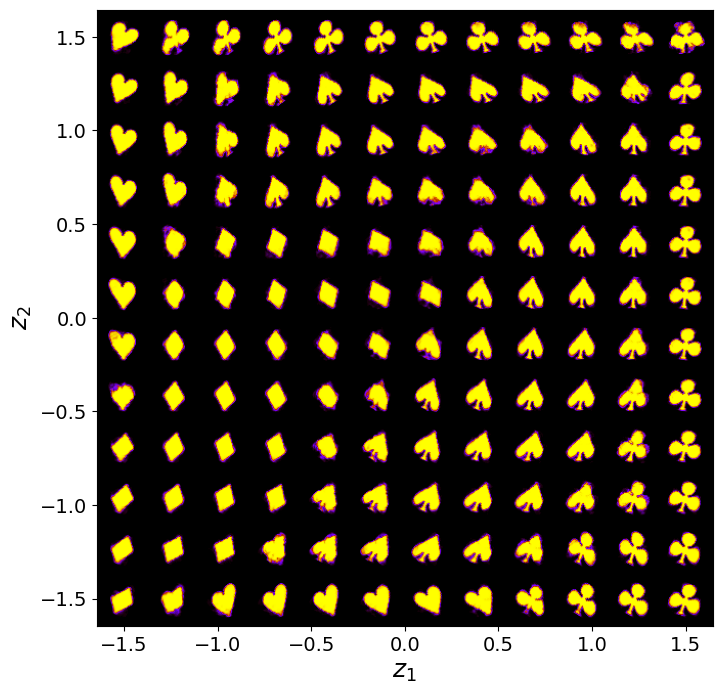

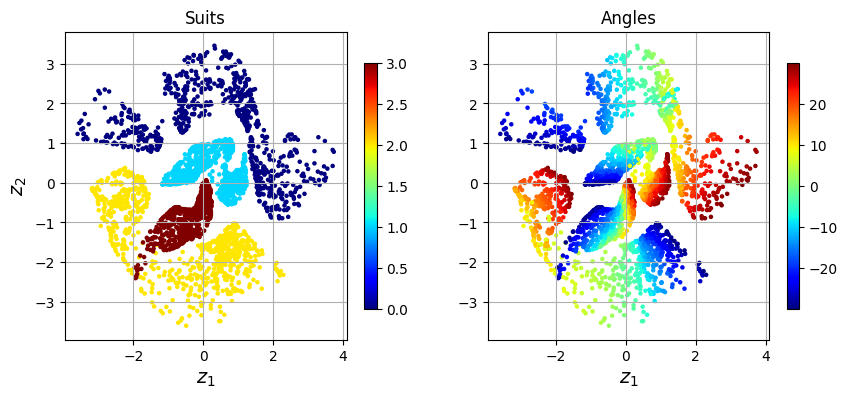

Epoch: 251 Training loss: 92.3448
Epoch: 252 Training loss: 92.5916
Epoch: 253 Training loss: 93.0748
Epoch: 254 Training loss: 92.8280
Epoch: 255 Training loss: 92.6925
Epoch: 256 Training loss: 92.2406
Epoch: 257 Training loss: 92.0581
Epoch: 258 Training loss: 92.2415
Epoch: 259 Training loss: 92.2552
Epoch: 260 Training loss: 91.9726
Epoch: 261 Training loss: 91.8468
Epoch: 262 Training loss: 91.8027
Epoch: 263 Training loss: 91.9661
Epoch: 264 Training loss: 91.9466
Epoch: 265 Training loss: 91.7032
Epoch: 266 Training loss: 91.7264
Epoch: 267 Training loss: 91.7650
Epoch: 268 Training loss: 91.8484
Epoch: 269 Training loss: 91.6403
Epoch: 270 Training loss: 91.4754
Epoch: 271 Training loss: 91.9078
Epoch: 272 Training loss: 91.4865
Epoch: 273 Training loss: 91.2872
Epoch: 274 Training loss: 91.2747
Epoch: 275 Training loss: 91.3210
Epoch: 276 Training loss: 91.3416
Epoch: 277 Training loss: 91.4823
Epoch: 278 Training loss: 91.0396
Epoch: 279 Training loss: 91.4565
Epoch: 280 Tra

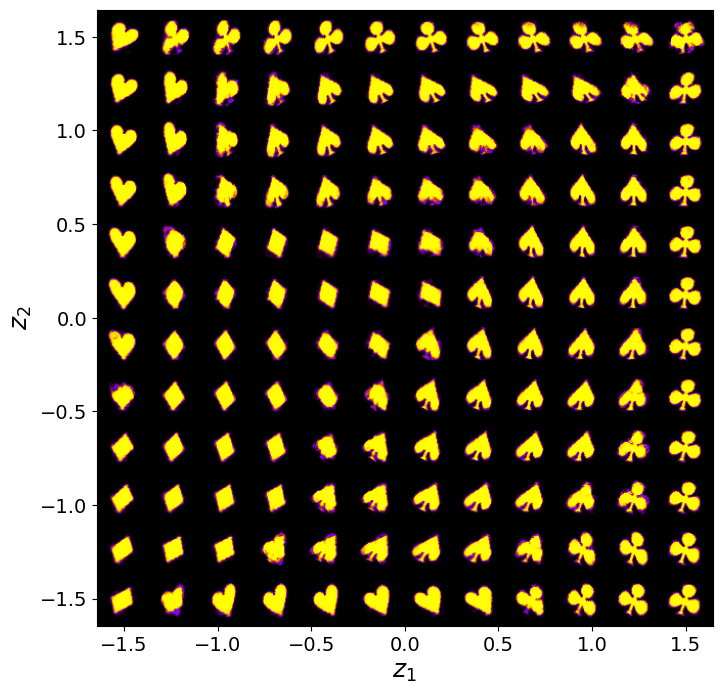

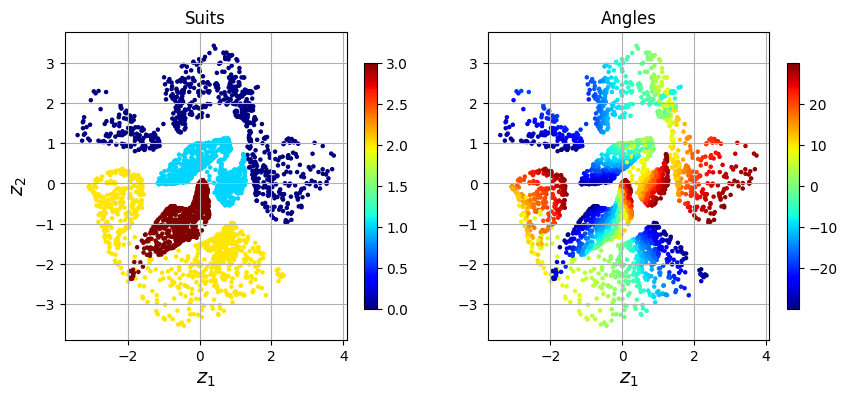

Epoch: 301 Training loss: 90.0781
Epoch: 302 Training loss: 90.0617
Epoch: 303 Training loss: 89.7927
Epoch: 304 Training loss: 89.9520
Epoch: 305 Training loss: 89.9607
Epoch: 306 Training loss: 89.7987
Epoch: 307 Training loss: 89.7675
Epoch: 308 Training loss: 89.9550
Epoch: 309 Training loss: 89.7006
Epoch: 310 Training loss: 89.7195
Epoch: 311 Training loss: 89.6675
Epoch: 312 Training loss: 90.6184
Epoch: 313 Training loss: 90.1524
Epoch: 314 Training loss: 90.0670
Epoch: 315 Training loss: 89.6764
Epoch: 316 Training loss: 89.4011
Epoch: 317 Training loss: 89.1290
Epoch: 318 Training loss: 89.1315
Epoch: 319 Training loss: 89.2865
Epoch: 320 Training loss: 89.3616
Epoch: 321 Training loss: 89.2555
Epoch: 322 Training loss: 89.1554
Epoch: 323 Training loss: 89.1410
Epoch: 324 Training loss: 89.2215
Epoch: 325 Training loss: 89.0743
Epoch: 326 Training loss: 89.1034
Epoch: 327 Training loss: 88.9426
Epoch: 328 Training loss: 89.1120
Epoch: 329 Training loss: 88.7398
Epoch: 330 Tra

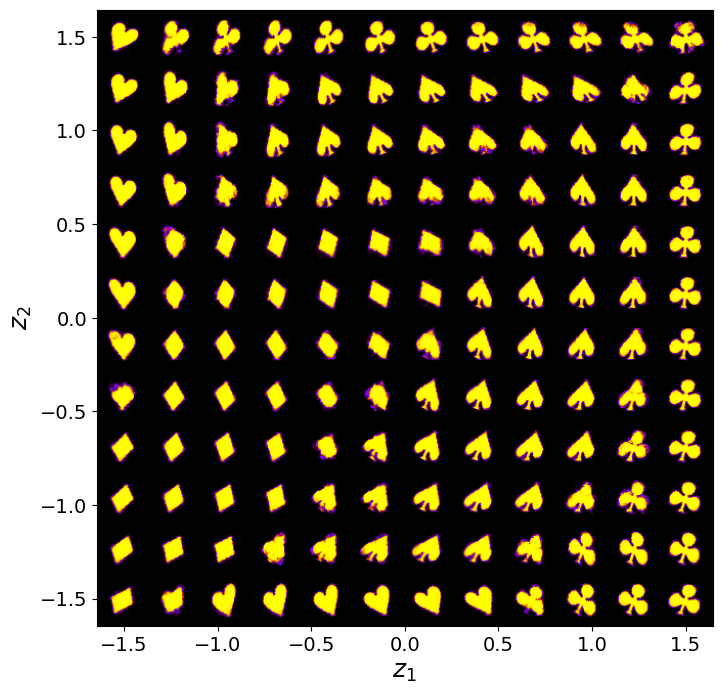

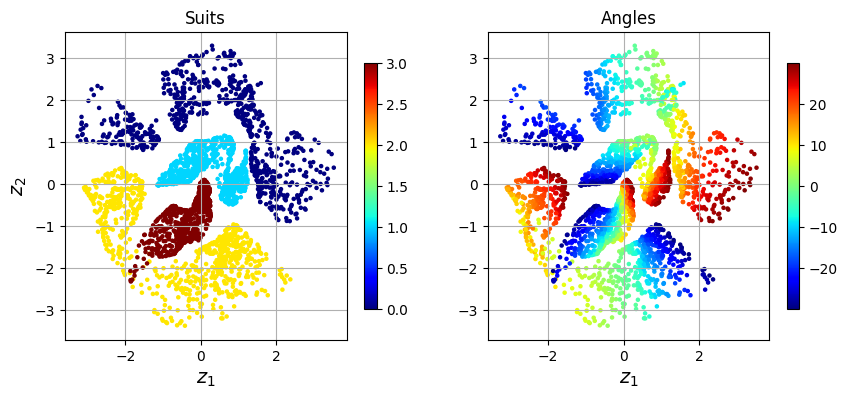

Epoch: 351 Training loss: 88.3213
Epoch: 352 Training loss: 88.1613
Epoch: 353 Training loss: 88.2819
Epoch: 354 Training loss: 88.1643
Epoch: 355 Training loss: 88.2998
Epoch: 356 Training loss: 88.1341
Epoch: 357 Training loss: 88.8743
Epoch: 358 Training loss: 88.7706
Epoch: 359 Training loss: 87.9980
Epoch: 360 Training loss: 87.8975
Epoch: 361 Training loss: 88.0341
Epoch: 362 Training loss: 87.8724
Epoch: 363 Training loss: 88.2124
Epoch: 364 Training loss: 87.9389
Epoch: 365 Training loss: 87.8675
Epoch: 366 Training loss: 87.8349
Epoch: 367 Training loss: 87.6698
Epoch: 368 Training loss: 87.7615
Epoch: 369 Training loss: 88.1614
Epoch: 370 Training loss: 88.2285
Epoch: 371 Training loss: 88.1968
Epoch: 372 Training loss: 88.2201
Epoch: 373 Training loss: 87.7092
Epoch: 374 Training loss: 87.3668
Epoch: 375 Training loss: 87.3933
Epoch: 376 Training loss: 87.5576
Epoch: 377 Training loss: 87.3369
Epoch: 378 Training loss: 87.5100
Epoch: 379 Training loss: 87.2832
Epoch: 380 Tra

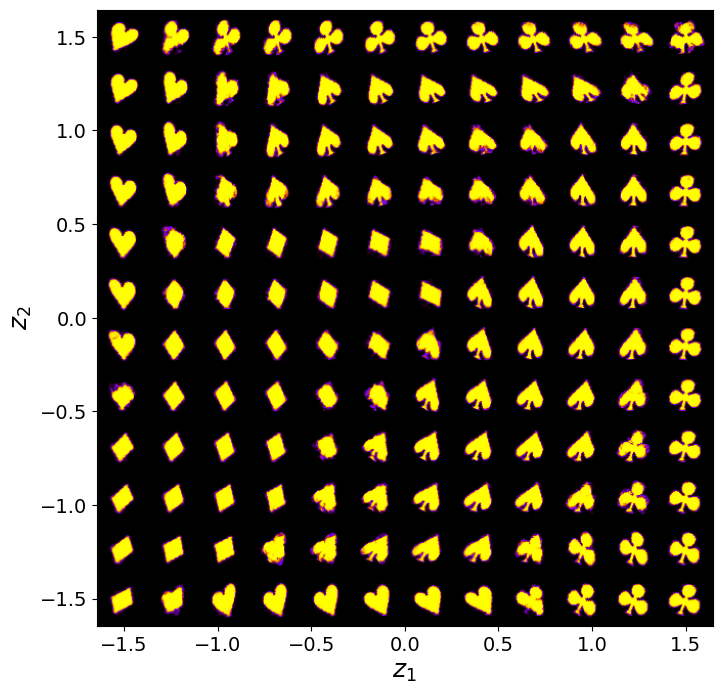

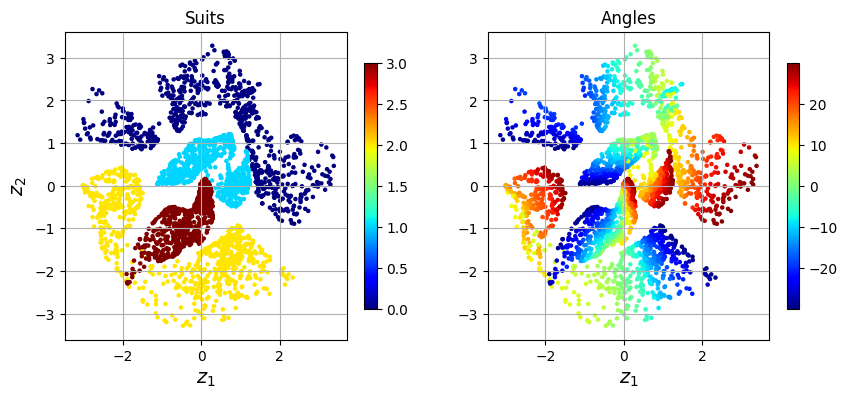

Epoch: 401 Training loss: 87.2767
Epoch: 402 Training loss: 87.1694
Epoch: 403 Training loss: 86.9533
Epoch: 404 Training loss: 86.9971
Epoch: 405 Training loss: 86.8100
Epoch: 406 Training loss: 86.6897
Epoch: 407 Training loss: 86.8232
Epoch: 408 Training loss: 87.2811
Epoch: 409 Training loss: 87.1910
Epoch: 410 Training loss: 86.8959
Epoch: 411 Training loss: 86.7497
Epoch: 412 Training loss: 86.8472
Epoch: 413 Training loss: 86.5838
Epoch: 414 Training loss: 86.8704
Epoch: 415 Training loss: 87.6069
Epoch: 416 Training loss: 86.7633
Epoch: 417 Training loss: 86.7128
Epoch: 418 Training loss: 86.6396
Epoch: 419 Training loss: 86.7227
Epoch: 420 Training loss: 86.7132
Epoch: 421 Training loss: 86.4461
Epoch: 422 Training loss: 86.5802
Epoch: 423 Training loss: 86.5088
Epoch: 424 Training loss: 86.5171
Epoch: 425 Training loss: 86.5967
Epoch: 426 Training loss: 86.5599
Epoch: 427 Training loss: 86.7444
Epoch: 428 Training loss: 86.6809
Epoch: 429 Training loss: 86.5996
Epoch: 430 Tra

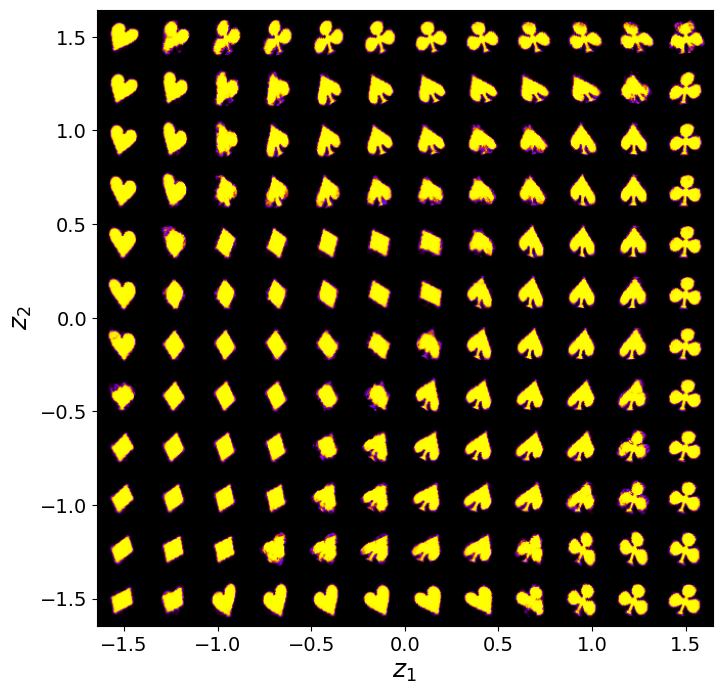

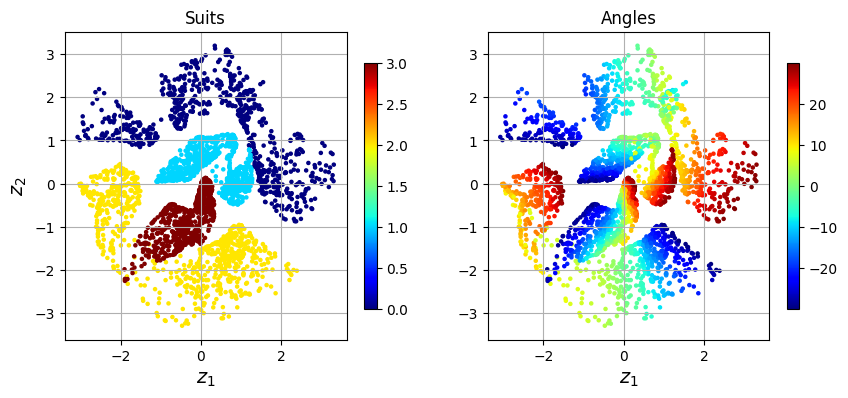

Epoch: 451 Training loss: 86.1239
Epoch: 452 Training loss: 86.0802
Epoch: 453 Training loss: 86.1630
Epoch: 454 Training loss: 86.0623
Epoch: 455 Training loss: 85.8514
Epoch: 456 Training loss: 86.0924
Epoch: 457 Training loss: 86.0569
Epoch: 458 Training loss: 85.7925
Epoch: 459 Training loss: 85.9663
Epoch: 460 Training loss: 86.1745
Epoch: 461 Training loss: 86.3500
Epoch: 462 Training loss: 86.3997
Epoch: 463 Training loss: 85.9386
Epoch: 464 Training loss: 85.9530
Epoch: 465 Training loss: 86.1050
Epoch: 466 Training loss: 86.0594
Epoch: 467 Training loss: 86.1096
Epoch: 468 Training loss: 85.7632
Epoch: 469 Training loss: 85.6652
Epoch: 470 Training loss: 85.6583
Epoch: 471 Training loss: 85.9023
Epoch: 472 Training loss: 85.9961
Epoch: 473 Training loss: 85.8727
Epoch: 474 Training loss: 85.8175
Epoch: 475 Training loss: 86.0639
Epoch: 476 Training loss: 86.0023
Epoch: 477 Training loss: 85.8533
Epoch: 478 Training loss: 85.6686
Epoch: 479 Training loss: 85.6953
Epoch: 480 Tra

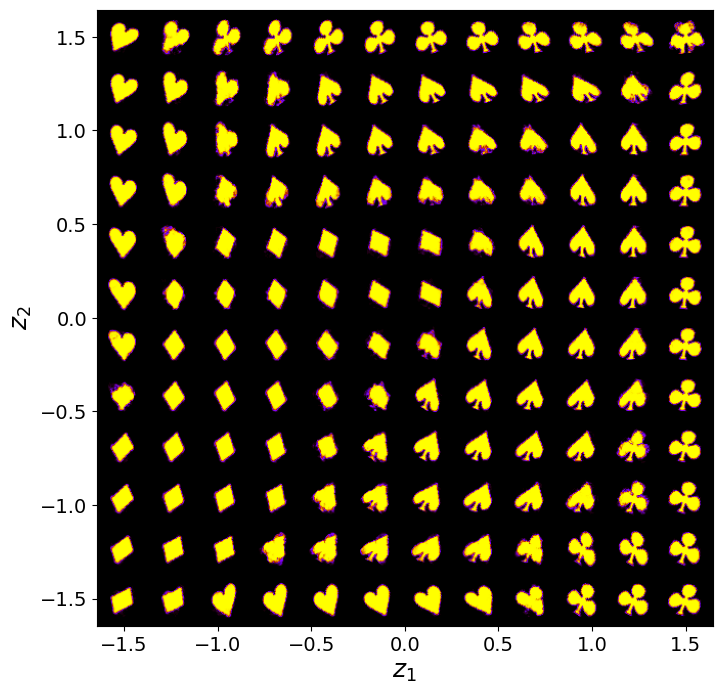

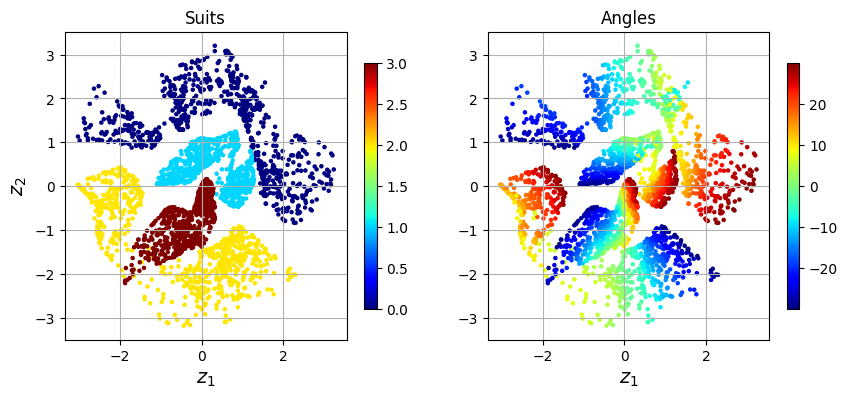

Epoch: 501 Training loss: 85.5204
Epoch: 502 Training loss: 85.3327
Epoch: 503 Training loss: 85.3862
Epoch: 504 Training loss: 85.3676
Epoch: 505 Training loss: 85.2657
Epoch: 506 Training loss: 85.1821
Epoch: 507 Training loss: 85.5181
Epoch: 508 Training loss: 85.3009
Epoch: 509 Training loss: 85.3147
Epoch: 510 Training loss: 85.5308
Epoch: 511 Training loss: 85.9872
Epoch: 512 Training loss: 86.4010
Epoch: 513 Training loss: 86.0043
Epoch: 514 Training loss: 85.6396
Epoch: 515 Training loss: 85.8582
Epoch: 516 Training loss: 85.8169
Epoch: 517 Training loss: 85.5430
Epoch: 518 Training loss: 85.6035
Epoch: 519 Training loss: 85.6469
Epoch: 520 Training loss: 85.4845
Epoch: 521 Training loss: 85.3383
Epoch: 522 Training loss: 85.2250
Epoch: 523 Training loss: 85.3870
Epoch: 524 Training loss: 85.0768
Epoch: 525 Training loss: 85.1511
Epoch: 526 Training loss: 85.2176
Epoch: 527 Training loss: 85.2900
Epoch: 528 Training loss: 85.0758
Epoch: 529 Training loss: 85.1637
Epoch: 530 Tra

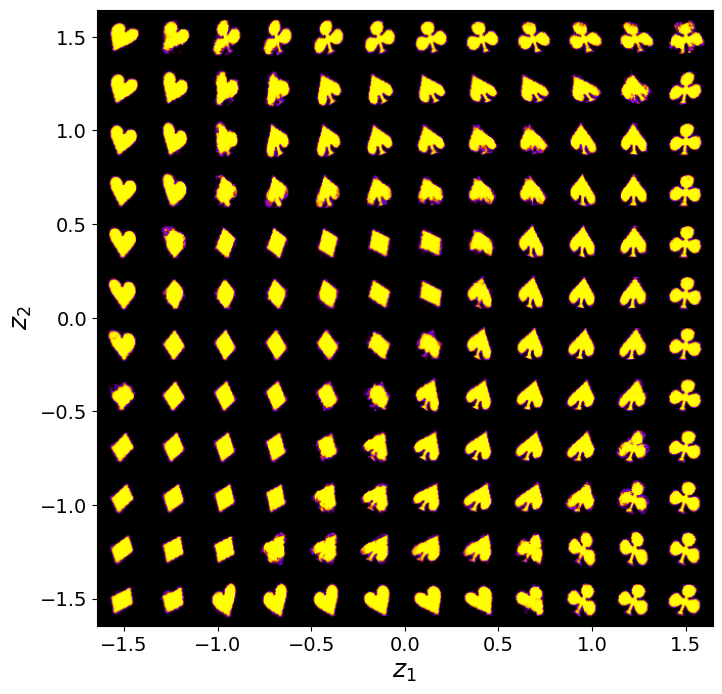

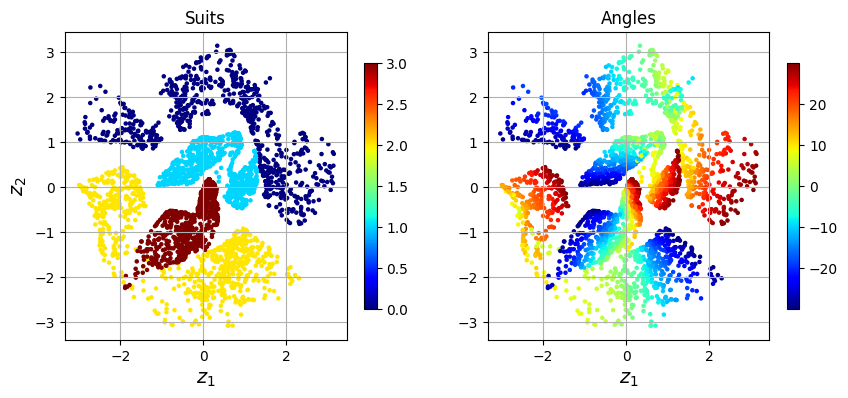

Epoch: 551 Training loss: 84.8173
Epoch: 552 Training loss: 84.8655
Epoch: 553 Training loss: 84.7891
Epoch: 554 Training loss: 84.7425
Epoch: 555 Training loss: 84.7408
Epoch: 556 Training loss: 84.8316
Epoch: 557 Training loss: 84.8867
Epoch: 558 Training loss: 85.1785
Epoch: 559 Training loss: 85.1158
Epoch: 560 Training loss: 84.8741
Epoch: 561 Training loss: 84.7331
Epoch: 562 Training loss: 84.7084
Epoch: 563 Training loss: 84.9804
Epoch: 564 Training loss: 84.6252
Epoch: 565 Training loss: 84.6022
Epoch: 566 Training loss: 84.6493
Epoch: 567 Training loss: 84.9183
Epoch: 568 Training loss: 84.9276
Epoch: 569 Training loss: 84.9044
Epoch: 570 Training loss: 84.7401
Epoch: 571 Training loss: 84.6871
Epoch: 572 Training loss: 84.6263
Epoch: 573 Training loss: 84.6100
Epoch: 574 Training loss: 84.8290
Epoch: 575 Training loss: 84.6414
Epoch: 576 Training loss: 84.6393
Epoch: 577 Training loss: 84.4655
Epoch: 578 Training loss: 84.6629
Epoch: 579 Training loss: 84.8075
Epoch: 580 Tra

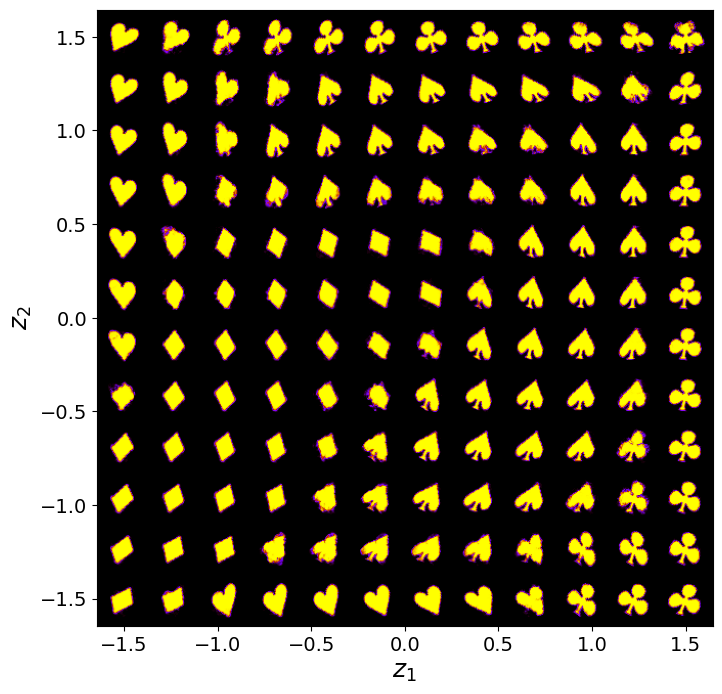

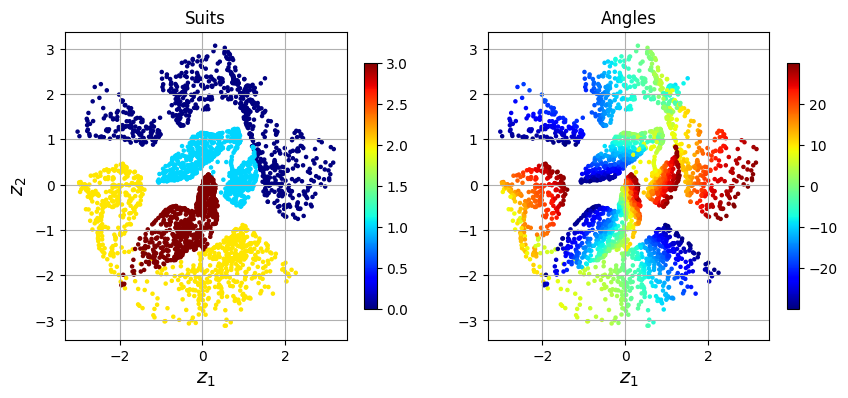

Epoch: 601 Training loss: 84.4950
Epoch: 602 Training loss: 84.9909
Epoch: 603 Training loss: 85.1223
Epoch: 604 Training loss: 84.7008
Epoch: 605 Training loss: 84.7973
Epoch: 606 Training loss: 84.4314
Epoch: 607 Training loss: 84.2806
Epoch: 608 Training loss: 84.2776
Epoch: 609 Training loss: 84.2737
Epoch: 610 Training loss: 84.2840
Epoch: 611 Training loss: 84.6583
Epoch: 612 Training loss: 84.4309
Epoch: 613 Training loss: 84.2749
Epoch: 614 Training loss: 84.4697
Epoch: 615 Training loss: 84.7055
Epoch: 616 Training loss: 84.6064
Epoch: 617 Training loss: 84.4249
Epoch: 618 Training loss: 84.3547
Epoch: 619 Training loss: 85.0680
Epoch: 620 Training loss: 86.2590
Epoch: 621 Training loss: 85.1099
Epoch: 622 Training loss: 84.9779
Epoch: 623 Training loss: 84.5291
Epoch: 624 Training loss: 84.2668
Epoch: 625 Training loss: 84.2117
Epoch: 626 Training loss: 84.3078
Epoch: 627 Training loss: 84.1251
Epoch: 628 Training loss: 84.1774
Epoch: 629 Training loss: 84.2264
Epoch: 630 Tra

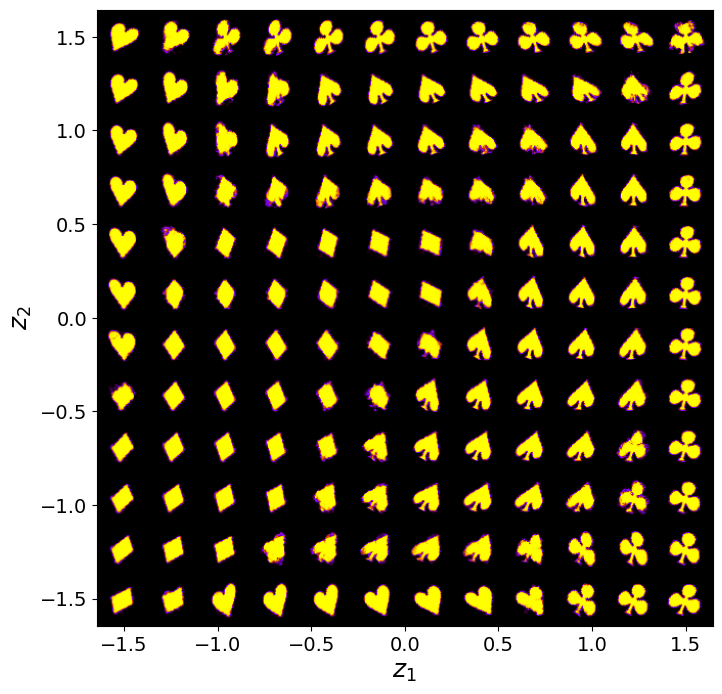

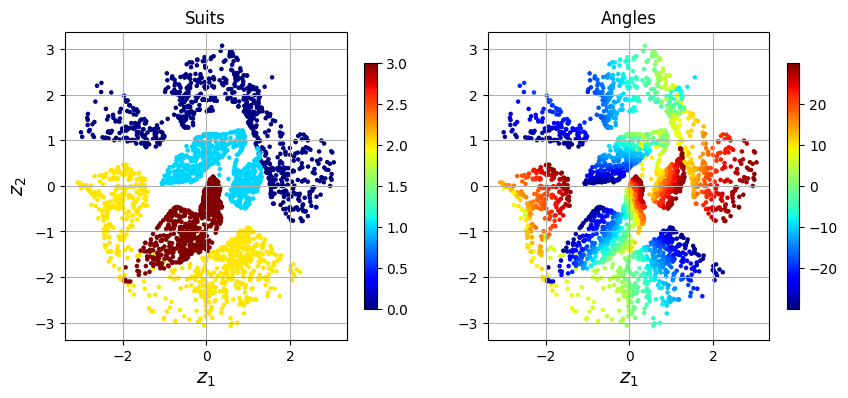

Epoch: 651 Training loss: 83.8671
Epoch: 652 Training loss: 83.8073
Epoch: 653 Training loss: 83.9010
Epoch: 654 Training loss: 84.0727
Epoch: 655 Training loss: 84.0332
Epoch: 656 Training loss: 84.0508
Epoch: 657 Training loss: 83.9974
Epoch: 658 Training loss: 84.2009
Epoch: 659 Training loss: 84.0569
Epoch: 660 Training loss: 83.9068
Epoch: 661 Training loss: 84.0476
Epoch: 662 Training loss: 84.1294
Epoch: 663 Training loss: 84.0740
Epoch: 664 Training loss: 84.1513
Epoch: 665 Training loss: 84.2301
Epoch: 666 Training loss: 83.9373
Epoch: 667 Training loss: 83.8386
Epoch: 668 Training loss: 83.9525
Epoch: 669 Training loss: 83.8713
Epoch: 670 Training loss: 84.1176
Epoch: 671 Training loss: 84.2608
Epoch: 672 Training loss: 84.2108
Epoch: 673 Training loss: 83.9422
Epoch: 674 Training loss: 83.9632
Epoch: 675 Training loss: 84.1296
Epoch: 676 Training loss: 84.0343
Epoch: 677 Training loss: 84.0832
Epoch: 678 Training loss: 84.2527
Epoch: 679 Training loss: 83.8464
Epoch: 680 Tra

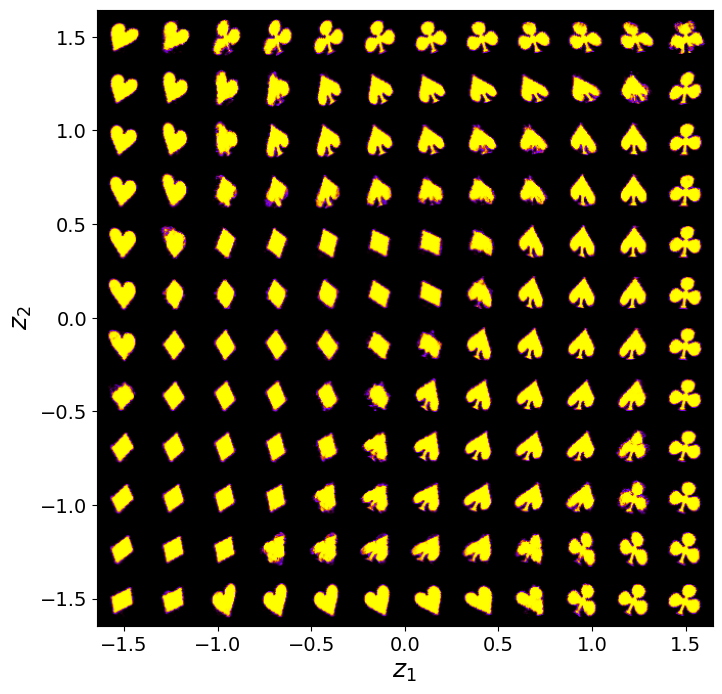

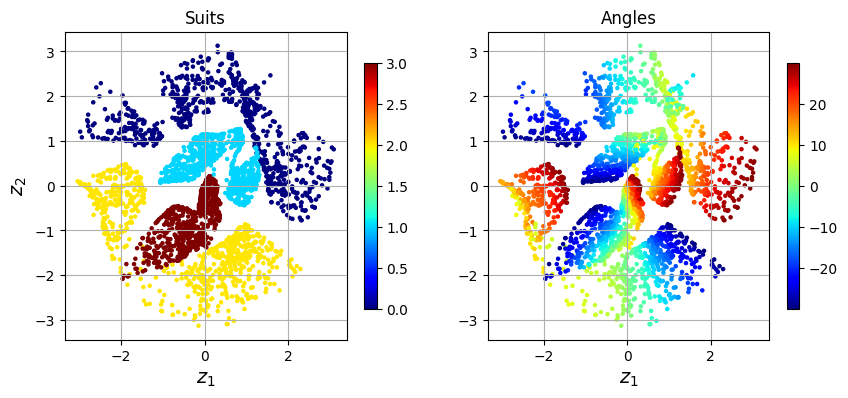

Epoch: 701 Training loss: 83.5866
Epoch: 702 Training loss: 83.7569
Epoch: 703 Training loss: 83.8505
Epoch: 704 Training loss: 84.0247
Epoch: 705 Training loss: 84.1021
Epoch: 706 Training loss: 83.8542
Epoch: 707 Training loss: 83.6710
Epoch: 708 Training loss: 83.6244
Epoch: 709 Training loss: 83.7744
Epoch: 710 Training loss: 83.5849
Epoch: 711 Training loss: 83.8173
Epoch: 712 Training loss: 83.5741
Epoch: 713 Training loss: 83.5460
Epoch: 714 Training loss: 83.6697
Epoch: 715 Training loss: 83.7402
Epoch: 716 Training loss: 83.8256
Epoch: 717 Training loss: 83.5572
Epoch: 718 Training loss: 83.6160
Epoch: 719 Training loss: 83.7380
Epoch: 720 Training loss: 83.6515
Epoch: 721 Training loss: 83.6347
Epoch: 722 Training loss: 83.5475
Epoch: 723 Training loss: 83.6765
Epoch: 724 Training loss: 83.5924
Epoch: 725 Training loss: 83.6545
Epoch: 726 Training loss: 83.4553
Epoch: 727 Training loss: 83.4577
Epoch: 728 Training loss: 83.3107
Epoch: 729 Training loss: 83.5320
Epoch: 730 Tra

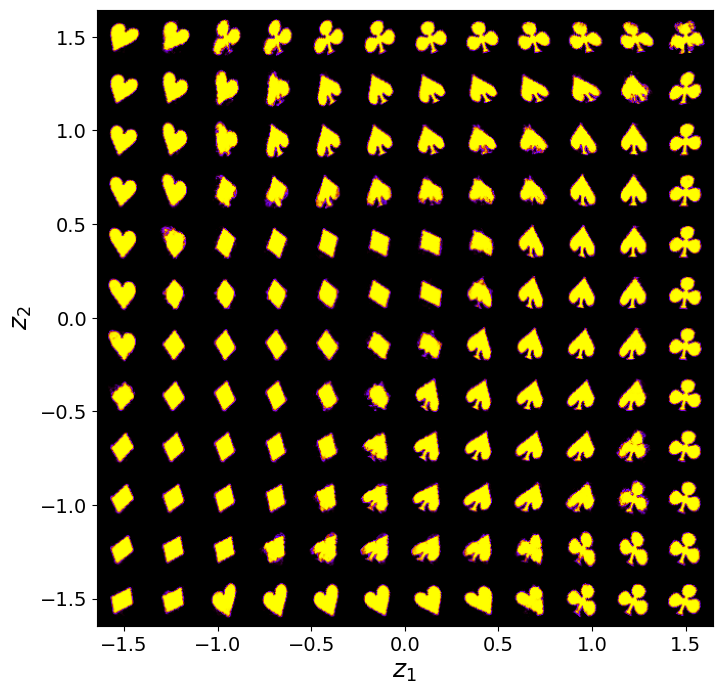

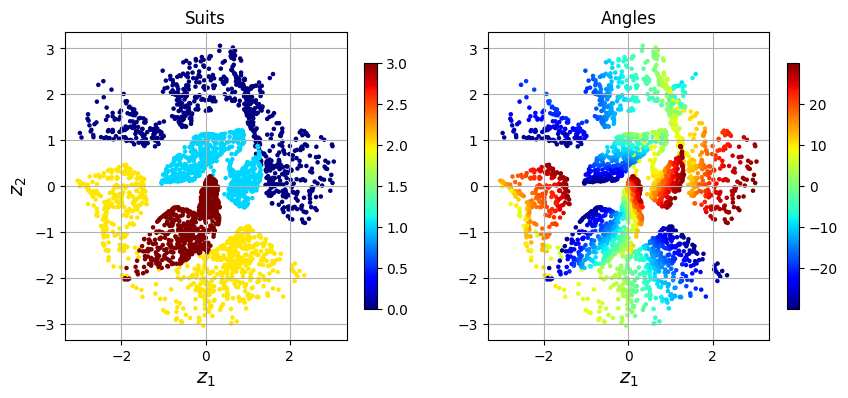

Epoch: 751 Training loss: 83.3796
Epoch: 752 Training loss: 83.3761
Epoch: 753 Training loss: 83.6497
Epoch: 754 Training loss: 83.4706
Epoch: 755 Training loss: 83.3076
Epoch: 756 Training loss: 83.3974
Epoch: 757 Training loss: 83.4107
Epoch: 758 Training loss: 83.5977
Epoch: 759 Training loss: 83.2326
Epoch: 760 Training loss: 83.6122
Epoch: 761 Training loss: 83.5823
Epoch: 762 Training loss: 83.4240
Epoch: 763 Training loss: 83.2318
Epoch: 764 Training loss: 83.3054
Epoch: 765 Training loss: 83.7149
Epoch: 766 Training loss: 83.6932
Epoch: 767 Training loss: 83.6845
Epoch: 768 Training loss: 83.4588
Epoch: 769 Training loss: 83.2321
Epoch: 770 Training loss: 83.4188
Epoch: 771 Training loss: 83.1526
Epoch: 772 Training loss: 83.4083
Epoch: 773 Training loss: 83.4611
Epoch: 774 Training loss: 83.5865
Epoch: 775 Training loss: 83.4169
Epoch: 776 Training loss: 83.5185
Epoch: 777 Training loss: 83.6286
Epoch: 778 Training loss: 83.3606
Epoch: 779 Training loss: 83.3837
Epoch: 780 Tra

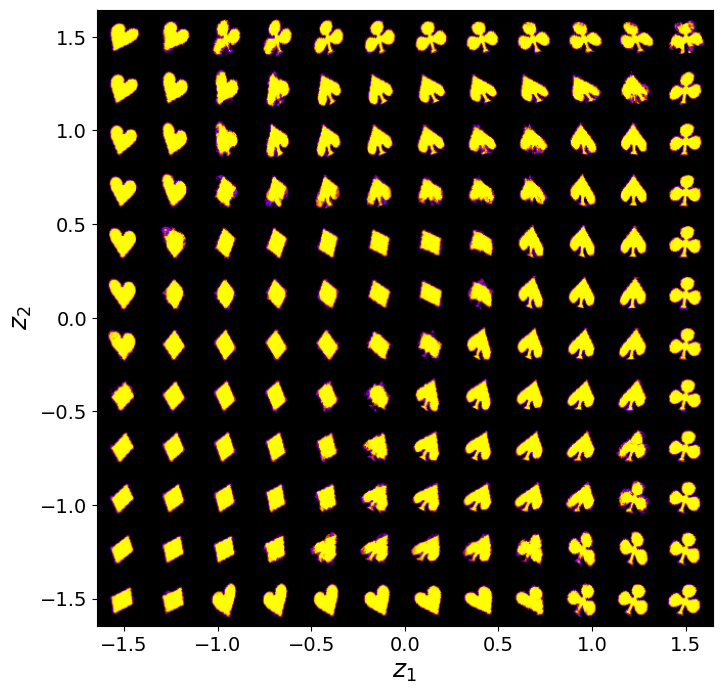

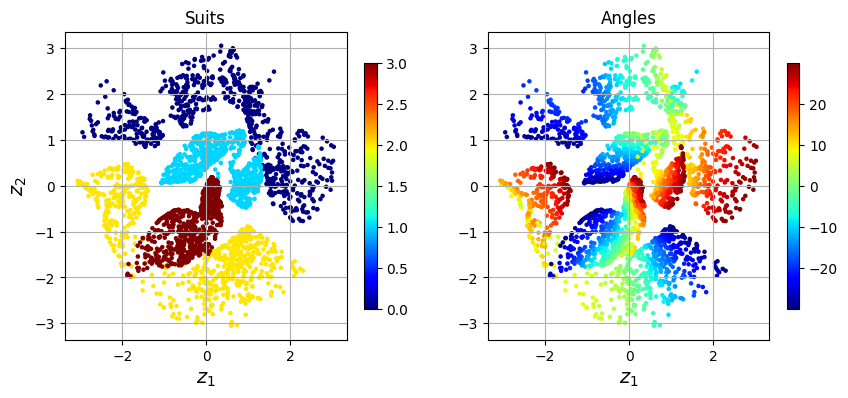

Epoch: 801 Training loss: 83.3961
Epoch: 802 Training loss: 83.3887
Epoch: 803 Training loss: 83.0720
Epoch: 804 Training loss: 83.2537
Epoch: 805 Training loss: 83.2826
Epoch: 806 Training loss: 83.2575
Epoch: 807 Training loss: 83.2219
Epoch: 808 Training loss: 83.1276
Epoch: 809 Training loss: 83.1257
Epoch: 810 Training loss: 83.0072
Epoch: 811 Training loss: 83.1637
Epoch: 812 Training loss: 83.3911
Epoch: 813 Training loss: 83.5141
Epoch: 814 Training loss: 83.6872
Epoch: 815 Training loss: 83.2691
Epoch: 816 Training loss: 83.0309
Epoch: 817 Training loss: 82.8708
Epoch: 818 Training loss: 83.0099
Epoch: 819 Training loss: 83.0400
Epoch: 820 Training loss: 83.0766
Epoch: 821 Training loss: 83.0812
Epoch: 822 Training loss: 83.2996
Epoch: 823 Training loss: 83.2387
Epoch: 824 Training loss: 83.2030
Epoch: 825 Training loss: 83.0623
Epoch: 826 Training loss: 83.0841
Epoch: 827 Training loss: 83.0337
Epoch: 828 Training loss: 82.9359
Epoch: 829 Training loss: 82.9284
Epoch: 830 Tra

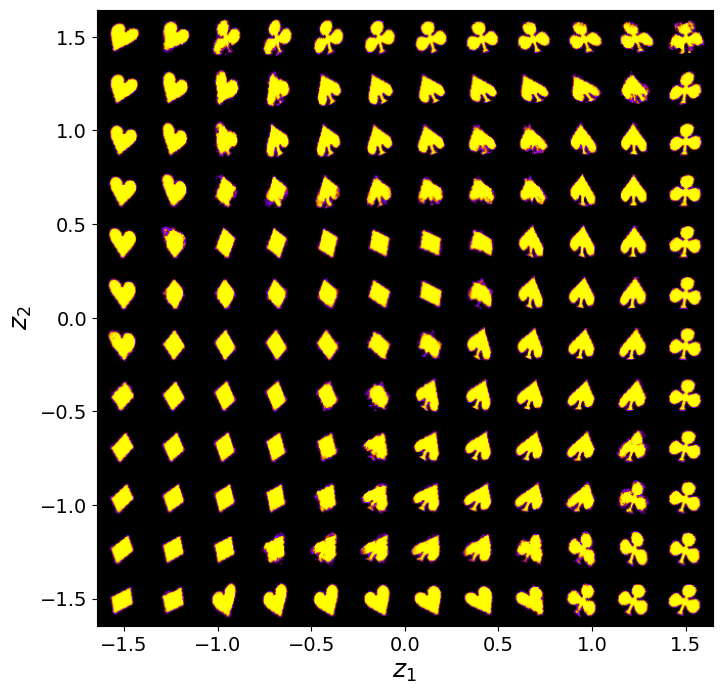

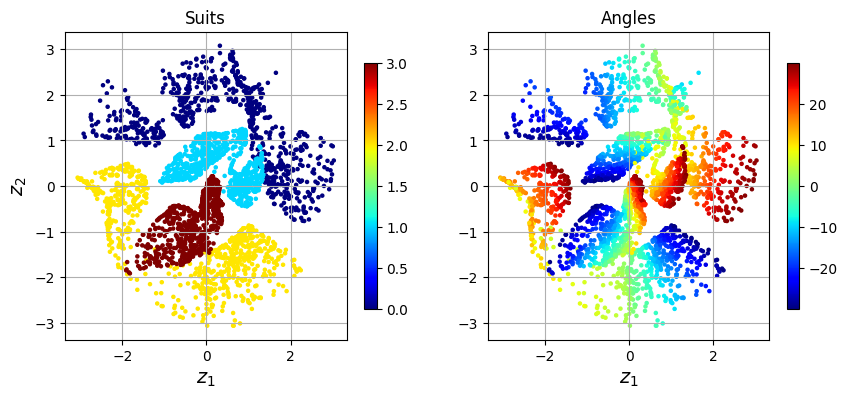

Epoch: 851 Training loss: 82.9440
Epoch: 852 Training loss: 82.9843
Epoch: 853 Training loss: 83.0257
Epoch: 854 Training loss: 82.7112
Epoch: 855 Training loss: 83.0485
Epoch: 856 Training loss: 82.9904
Epoch: 857 Training loss: 82.9897
Epoch: 858 Training loss: 82.9855
Epoch: 859 Training loss: 82.9747
Epoch: 860 Training loss: 82.9618
Epoch: 861 Training loss: 82.8190
Epoch: 862 Training loss: 82.9150
Epoch: 863 Training loss: 83.1565
Epoch: 864 Training loss: 83.1792
Epoch: 865 Training loss: 83.0640
Epoch: 866 Training loss: 82.8867
Epoch: 867 Training loss: 82.7796
Epoch: 868 Training loss: 82.9457
Epoch: 869 Training loss: 82.8134
Epoch: 870 Training loss: 82.9173
Epoch: 871 Training loss: 82.8404
Epoch: 872 Training loss: 82.9118
Epoch: 873 Training loss: 82.9645
Epoch: 874 Training loss: 82.7826
Epoch: 875 Training loss: 82.8910
Epoch: 876 Training loss: 82.9855
Epoch: 877 Training loss: 82.8138
Epoch: 878 Training loss: 82.8605
Epoch: 879 Training loss: 82.9994
Epoch: 880 Tra

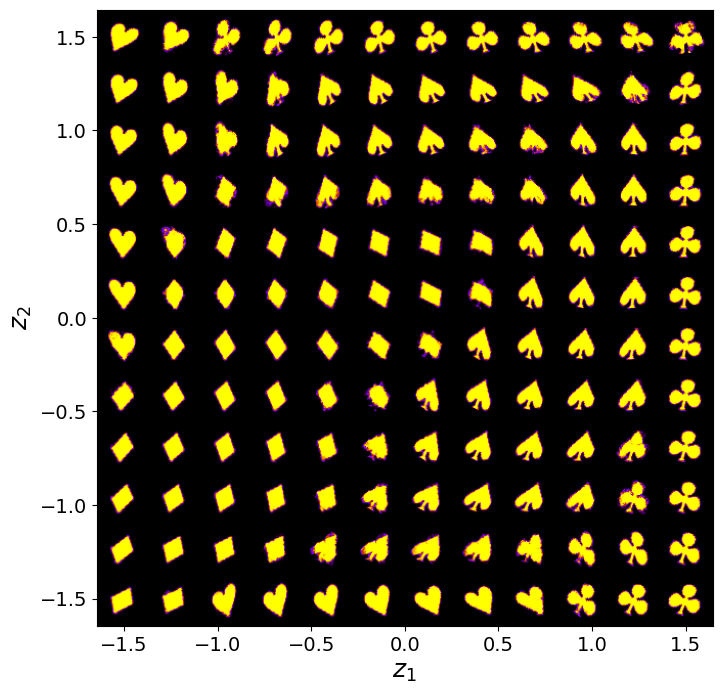

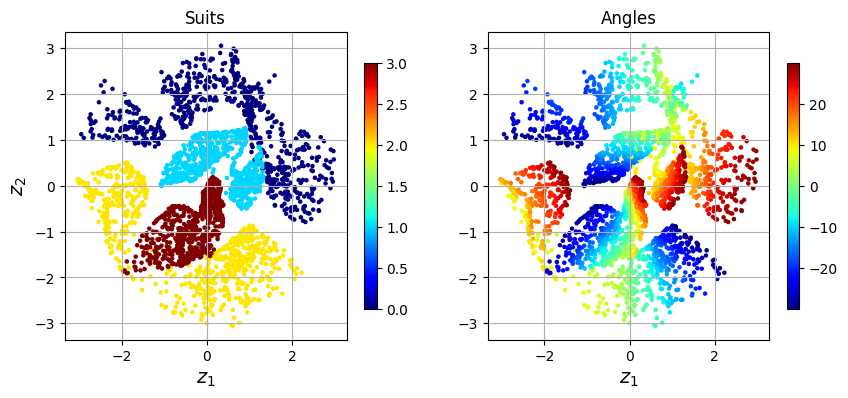

Epoch: 901 Training loss: 83.0410
Epoch: 902 Training loss: 82.8577
Epoch: 903 Training loss: 82.7410
Epoch: 904 Training loss: 82.6209
Epoch: 905 Training loss: 82.8698
Epoch: 906 Training loss: 82.8180
Epoch: 907 Training loss: 82.7028
Epoch: 908 Training loss: 82.5442
Epoch: 909 Training loss: 82.5764
Epoch: 910 Training loss: 82.7567
Epoch: 911 Training loss: 83.0871
Epoch: 912 Training loss: 83.0808
Epoch: 913 Training loss: 82.8552
Epoch: 914 Training loss: 82.5844
Epoch: 915 Training loss: 82.6271
Epoch: 916 Training loss: 82.5117
Epoch: 917 Training loss: 82.6145
Epoch: 918 Training loss: 82.7418
Epoch: 919 Training loss: 82.9570
Epoch: 920 Training loss: 83.1729
Epoch: 921 Training loss: 82.9376
Epoch: 922 Training loss: 82.5613
Epoch: 923 Training loss: 82.7859
Epoch: 924 Training loss: 82.6783
Epoch: 925 Training loss: 83.1962
Epoch: 926 Training loss: 83.0573
Epoch: 927 Training loss: 82.8016
Epoch: 928 Training loss: 82.7554
Epoch: 929 Training loss: 82.6546
Epoch: 930 Tra

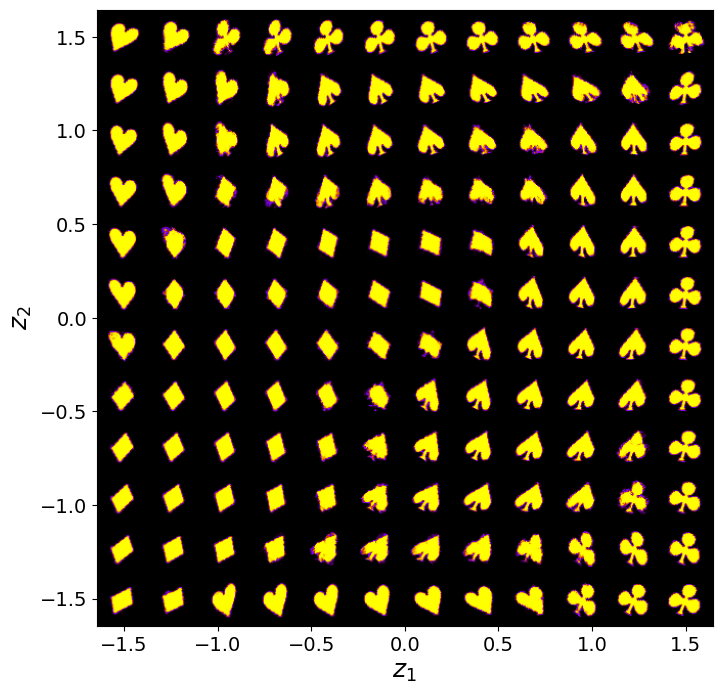

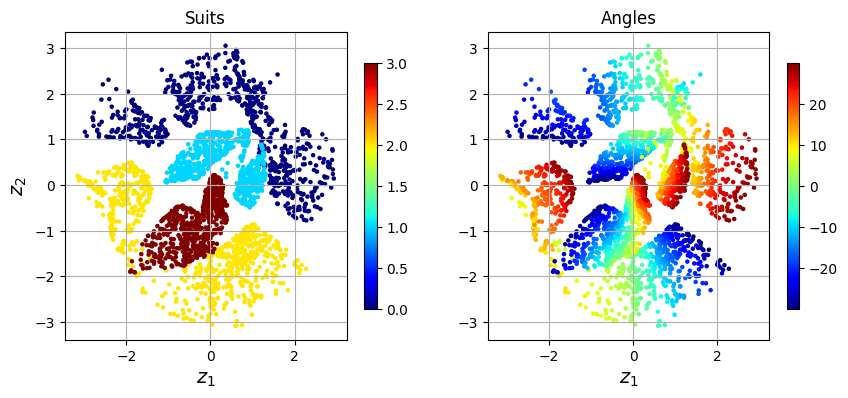

Epoch: 951 Training loss: 83.0167
Epoch: 952 Training loss: 82.7101
Epoch: 953 Training loss: 82.6097
Epoch: 954 Training loss: 82.5705
Epoch: 955 Training loss: 82.5717
Epoch: 956 Training loss: 82.3265
Epoch: 957 Training loss: 82.5185
Epoch: 958 Training loss: 82.4419
Epoch: 959 Training loss: 82.4450
Epoch: 960 Training loss: 82.4359
Epoch: 961 Training loss: 82.4715
Epoch: 962 Training loss: 82.5871
Epoch: 963 Training loss: 82.4848
Epoch: 964 Training loss: 82.4173
Epoch: 965 Training loss: 82.3765
Epoch: 966 Training loss: 82.3755
Epoch: 967 Training loss: 82.6519
Epoch: 968 Training loss: 82.6086
Epoch: 969 Training loss: 82.3830
Epoch: 970 Training loss: 82.5141
Epoch: 971 Training loss: 82.6518
Epoch: 972 Training loss: 82.5711
Epoch: 973 Training loss: 82.2611
Epoch: 974 Training loss: 82.4123
Epoch: 975 Training loss: 82.3641
Epoch: 976 Training loss: 82.5885
Epoch: 977 Training loss: 82.7037
Epoch: 978 Training loss: 82.5760
Epoch: 979 Training loss: 82.3263
Epoch: 980 Tra

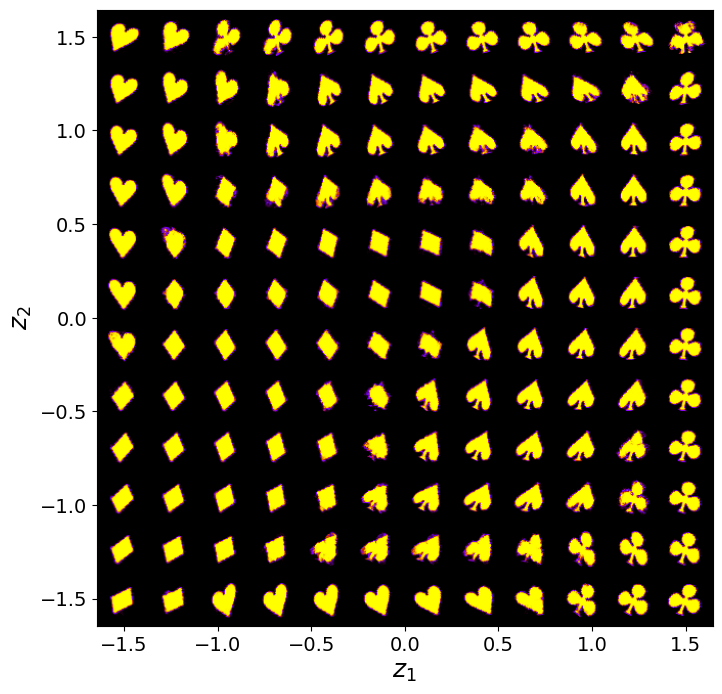

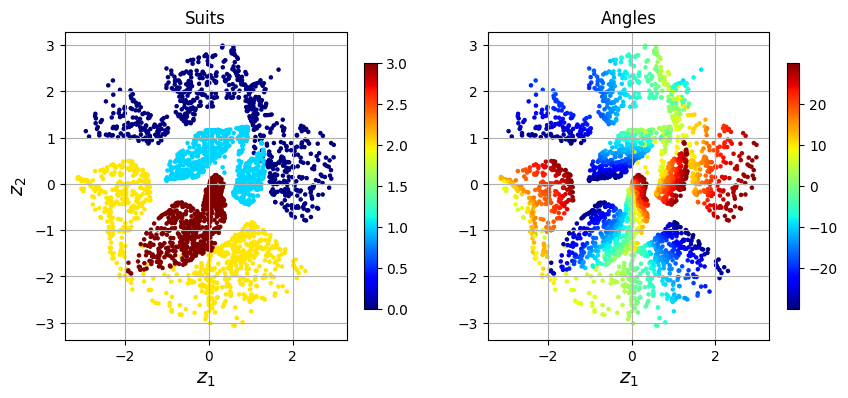

Epoch: 1001 Training loss: 82.3575
Epoch: 1002 Training loss: 82.3060
Epoch: 1003 Training loss: 82.3875
Epoch: 1004 Training loss: 82.3900
Epoch: 1005 Training loss: 82.3964
Epoch: 1006 Training loss: 82.4866
Epoch: 1007 Training loss: 82.3367
Epoch: 1008 Training loss: 82.5162
Epoch: 1009 Training loss: 82.2733
Epoch: 1010 Training loss: 82.4765
Epoch: 1011 Training loss: 82.5296
Epoch: 1012 Training loss: 82.5406
Epoch: 1013 Training loss: 82.4075
Epoch: 1014 Training loss: 82.3117
Epoch: 1015 Training loss: 82.1613
Epoch: 1016 Training loss: 82.3583
Epoch: 1017 Training loss: 82.3290
Epoch: 1018 Training loss: 82.4510
Epoch: 1019 Training loss: 82.6050
Epoch: 1020 Training loss: 82.4165
Epoch: 1021 Training loss: 82.6127
Epoch: 1022 Training loss: 82.4702
Epoch: 1023 Training loss: 82.4077
Epoch: 1024 Training loss: 82.4204
Epoch: 1025 Training loss: 82.4201
Epoch: 1026 Training loss: 82.3741
Epoch: 1027 Training loss: 82.4969
Epoch: 1028 Training loss: 82.6488
Epoch: 1029 Training

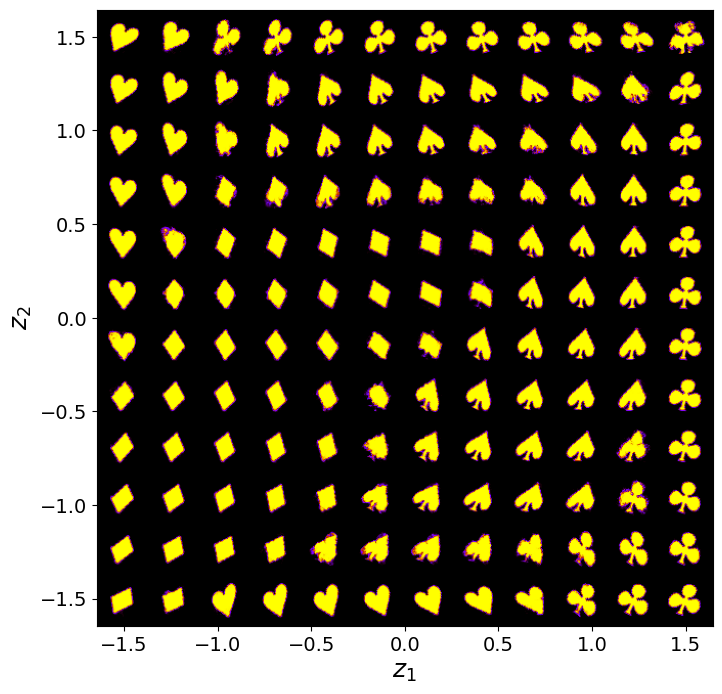

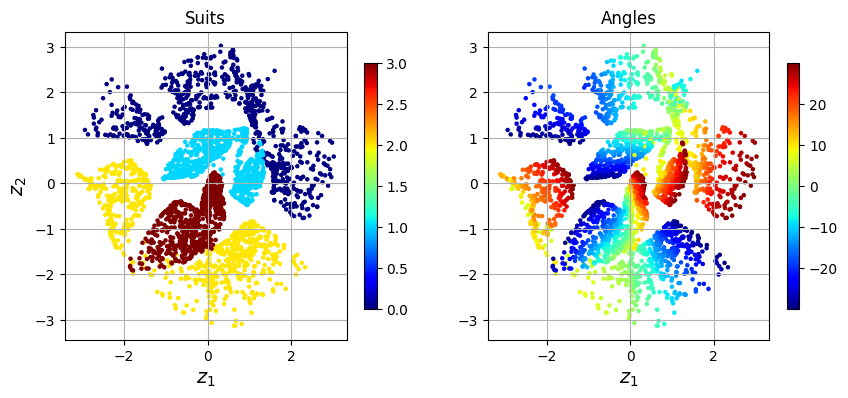

Epoch: 1051 Training loss: 82.3477
Epoch: 1052 Training loss: 82.2662
Epoch: 1053 Training loss: 83.0135
Epoch: 1054 Training loss: 82.5854
Epoch: 1055 Training loss: 82.5043
Epoch: 1056 Training loss: 82.2461
Epoch: 1057 Training loss: 82.1040
Epoch: 1058 Training loss: 82.1972
Epoch: 1059 Training loss: 82.0551
Epoch: 1060 Training loss: 82.1069
Epoch: 1061 Training loss: 82.1562
Epoch: 1062 Training loss: 82.1768
Epoch: 1063 Training loss: 82.8881
Epoch: 1064 Training loss: 82.5493
Epoch: 1065 Training loss: 82.4734
Epoch: 1066 Training loss: 82.3870
Epoch: 1067 Training loss: 82.2439
Epoch: 1068 Training loss: 82.3488
Epoch: 1069 Training loss: 82.1472
Epoch: 1070 Training loss: 81.9931
Epoch: 1071 Training loss: 82.0220
Epoch: 1072 Training loss: 82.0690
Epoch: 1073 Training loss: 82.0436
Epoch: 1074 Training loss: 82.2573
Epoch: 1075 Training loss: 82.2621
Epoch: 1076 Training loss: 82.2590
Epoch: 1077 Training loss: 82.1606
Epoch: 1078 Training loss: 82.0792
Epoch: 1079 Training

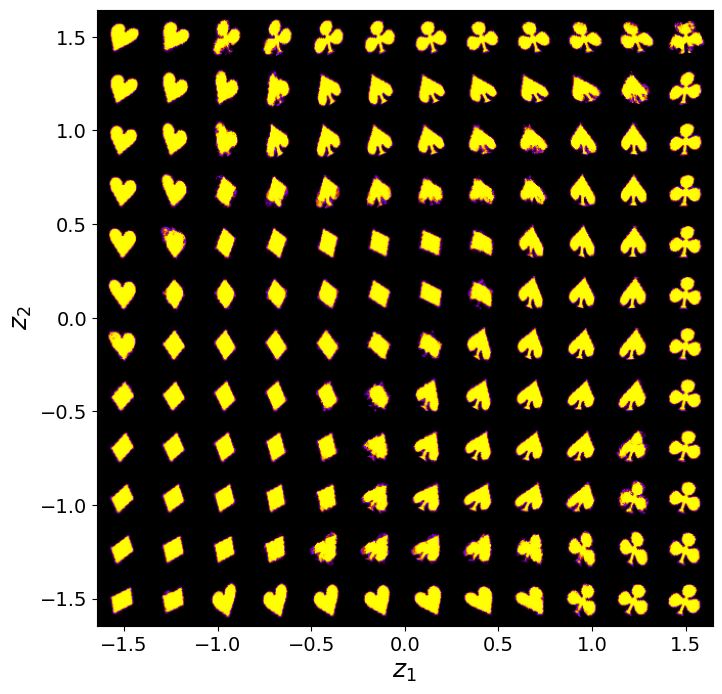

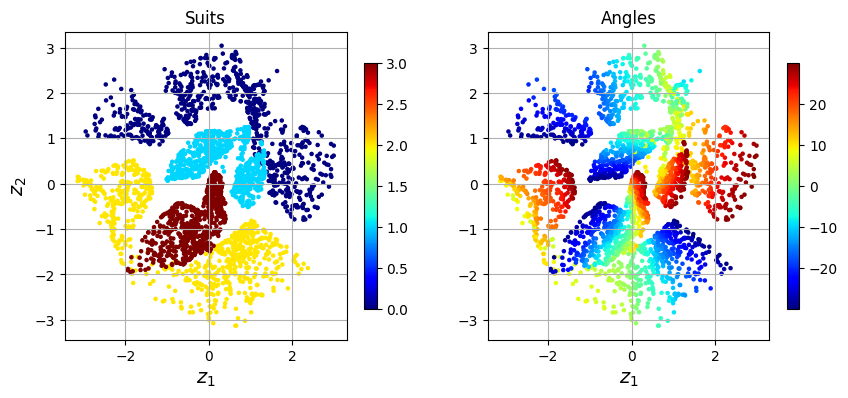

Epoch: 1101 Training loss: 82.1525
Epoch: 1102 Training loss: 82.0944
Epoch: 1103 Training loss: 82.0004
Epoch: 1104 Training loss: 82.0145
Epoch: 1105 Training loss: 82.0395
Epoch: 1106 Training loss: 82.1169
Epoch: 1107 Training loss: 82.2135
Epoch: 1108 Training loss: 82.3386
Epoch: 1109 Training loss: 82.0336
Epoch: 1110 Training loss: 82.0470
Epoch: 1111 Training loss: 81.9900
Epoch: 1112 Training loss: 82.0027
Epoch: 1113 Training loss: 82.0110
Epoch: 1114 Training loss: 82.2644
Epoch: 1115 Training loss: 82.5519
Epoch: 1116 Training loss: 82.1166
Epoch: 1117 Training loss: 82.3079
Epoch: 1118 Training loss: 82.1918
Epoch: 1119 Training loss: 82.2248
Epoch: 1120 Training loss: 82.3770
Epoch: 1121 Training loss: 82.1187
Epoch: 1122 Training loss: 82.1657
Epoch: 1123 Training loss: 82.3416
Epoch: 1124 Training loss: 82.0791
Epoch: 1125 Training loss: 81.9739
Epoch: 1126 Training loss: 81.9862
Epoch: 1127 Training loss: 82.0158
Epoch: 1128 Training loss: 81.9119
Epoch: 1129 Training

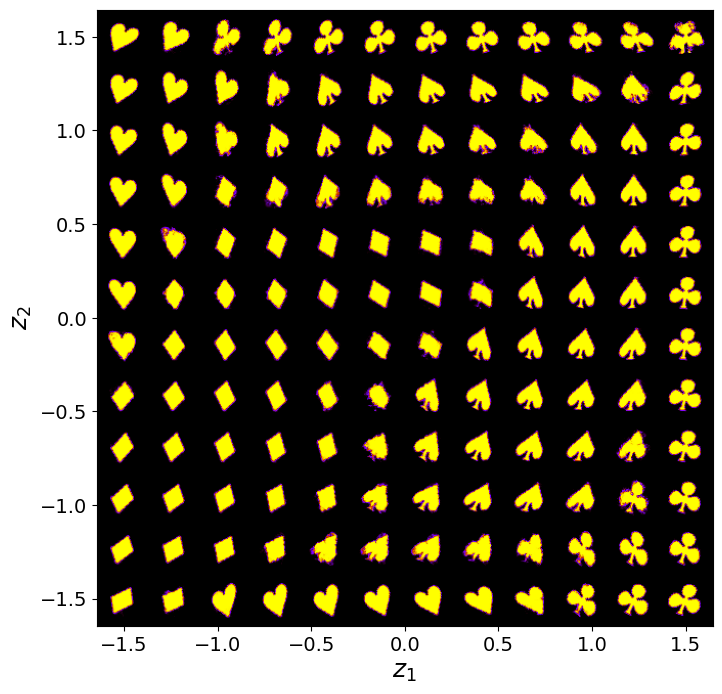

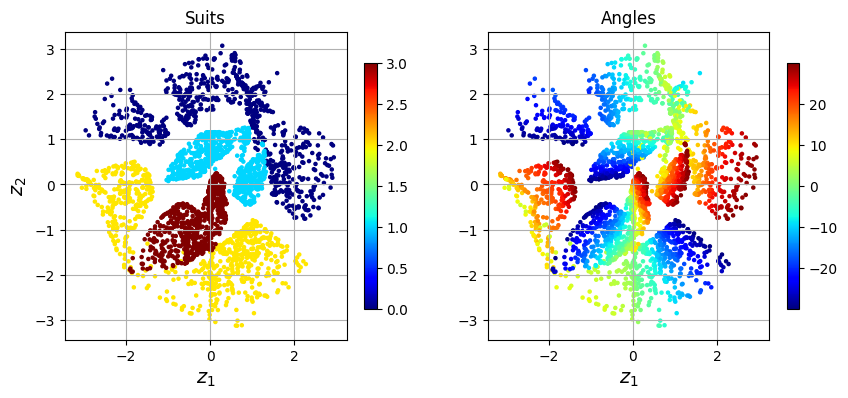

Epoch: 1151 Training loss: 81.9606
Epoch: 1152 Training loss: 82.2911
Epoch: 1153 Training loss: 82.0962
Epoch: 1154 Training loss: 81.8127
Epoch: 1155 Training loss: 81.9151
Epoch: 1156 Training loss: 81.8643
Epoch: 1157 Training loss: 81.9427
Epoch: 1158 Training loss: 81.8693
Epoch: 1159 Training loss: 81.9529
Epoch: 1160 Training loss: 81.9213
Epoch: 1161 Training loss: 82.1119
Epoch: 1162 Training loss: 81.9554
Epoch: 1163 Training loss: 82.2392
Epoch: 1164 Training loss: 82.1215
Epoch: 1165 Training loss: 82.0373
Epoch: 1166 Training loss: 82.3641
Epoch: 1167 Training loss: 82.1931
Epoch: 1168 Training loss: 81.9220
Epoch: 1169 Training loss: 81.7511
Epoch: 1170 Training loss: 81.9369
Epoch: 1171 Training loss: 82.0464
Epoch: 1172 Training loss: 82.0326
Epoch: 1173 Training loss: 81.9606
Epoch: 1174 Training loss: 82.1730
Epoch: 1175 Training loss: 81.9531
Epoch: 1176 Training loss: 81.9160
Epoch: 1177 Training loss: 81.9065
Epoch: 1178 Training loss: 82.1597
Epoch: 1179 Training

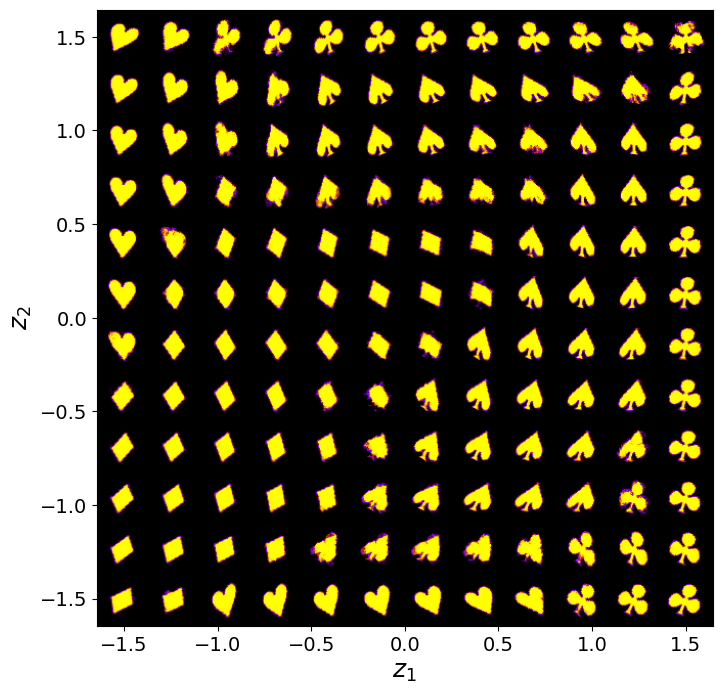

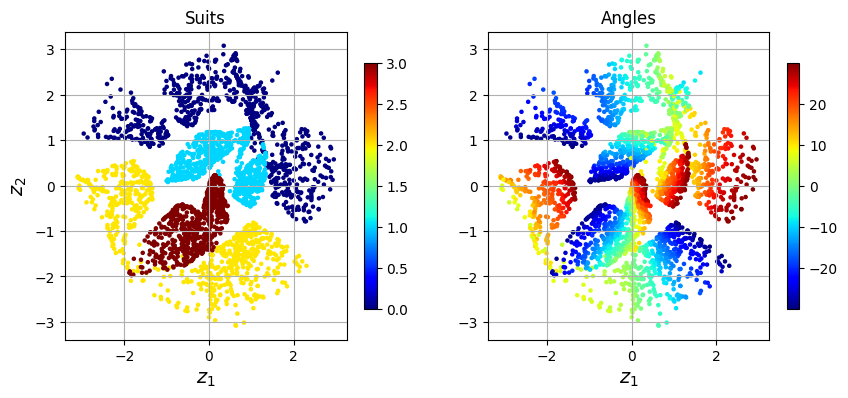

Epoch: 1201 Training loss: 81.8308
Epoch: 1202 Training loss: 81.8672
Epoch: 1203 Training loss: 81.8409
Epoch: 1204 Training loss: 81.9306
Epoch: 1205 Training loss: 81.8349
Epoch: 1206 Training loss: 81.8400
Epoch: 1207 Training loss: 81.9415
Epoch: 1208 Training loss: 82.2063
Epoch: 1209 Training loss: 82.3158
Epoch: 1210 Training loss: 81.9917
Epoch: 1211 Training loss: 82.0343
Epoch: 1212 Training loss: 81.8974
Epoch: 1213 Training loss: 81.9279
Epoch: 1214 Training loss: 81.9612
Epoch: 1215 Training loss: 81.9130
Epoch: 1216 Training loss: 81.9688
Epoch: 1217 Training loss: 81.6922
Epoch: 1218 Training loss: 81.7739
Epoch: 1219 Training loss: 81.9120
Epoch: 1220 Training loss: 81.8978
Epoch: 1221 Training loss: 81.9229
Epoch: 1222 Training loss: 81.7418
Epoch: 1223 Training loss: 82.3595
Epoch: 1224 Training loss: 82.7765
Epoch: 1225 Training loss: 82.2520
Epoch: 1226 Training loss: 81.7819
Epoch: 1227 Training loss: 81.8336
Epoch: 1228 Training loss: 81.8568
Epoch: 1229 Training

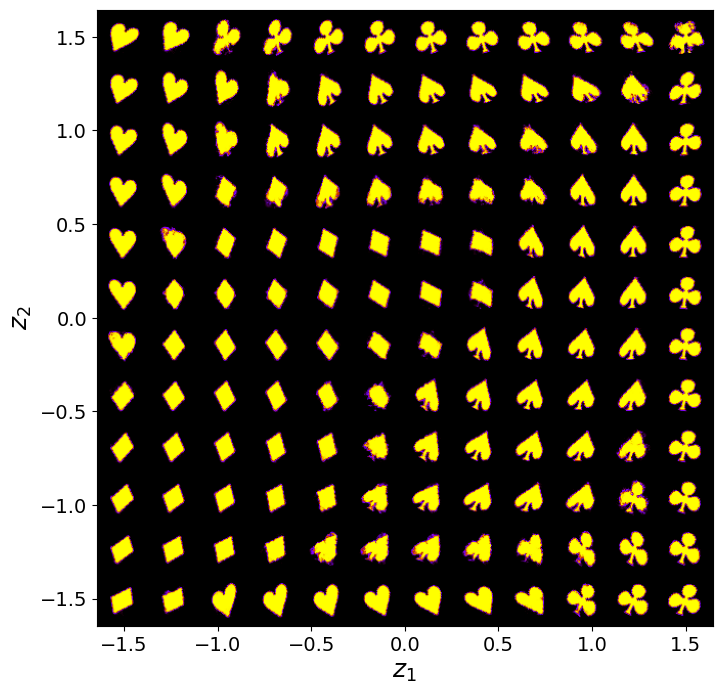

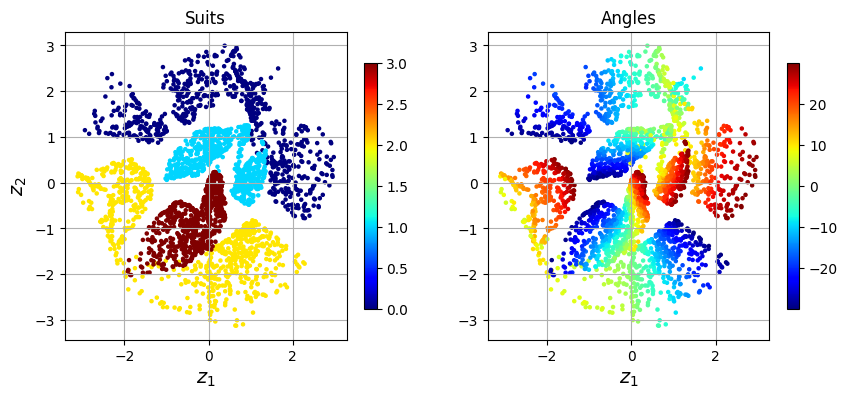

Epoch: 1251 Training loss: 81.7048
Epoch: 1252 Training loss: 81.7309
Epoch: 1253 Training loss: 82.0714
Epoch: 1254 Training loss: 81.9782
Epoch: 1255 Training loss: 81.6028
Epoch: 1256 Training loss: 81.6205
Epoch: 1257 Training loss: 81.6072
Epoch: 1258 Training loss: 81.8780
Epoch: 1259 Training loss: 81.7527
Epoch: 1260 Training loss: 81.6161
Epoch: 1261 Training loss: 81.5256
Epoch: 1262 Training loss: 81.5851
Epoch: 1263 Training loss: 81.6082
Epoch: 1264 Training loss: 81.6217
Epoch: 1265 Training loss: 82.0449
Epoch: 1266 Training loss: 81.7745
Epoch: 1267 Training loss: 81.7906
Epoch: 1268 Training loss: 82.0694
Epoch: 1269 Training loss: 82.1245
Epoch: 1270 Training loss: 81.6737
Epoch: 1271 Training loss: 81.5877
Epoch: 1272 Training loss: 81.7864
Epoch: 1273 Training loss: 81.7039
Epoch: 1274 Training loss: 81.7225
Epoch: 1275 Training loss: 81.6724
Epoch: 1276 Training loss: 81.4970
Epoch: 1277 Training loss: 81.8334
Epoch: 1278 Training loss: 81.7966
Epoch: 1279 Training

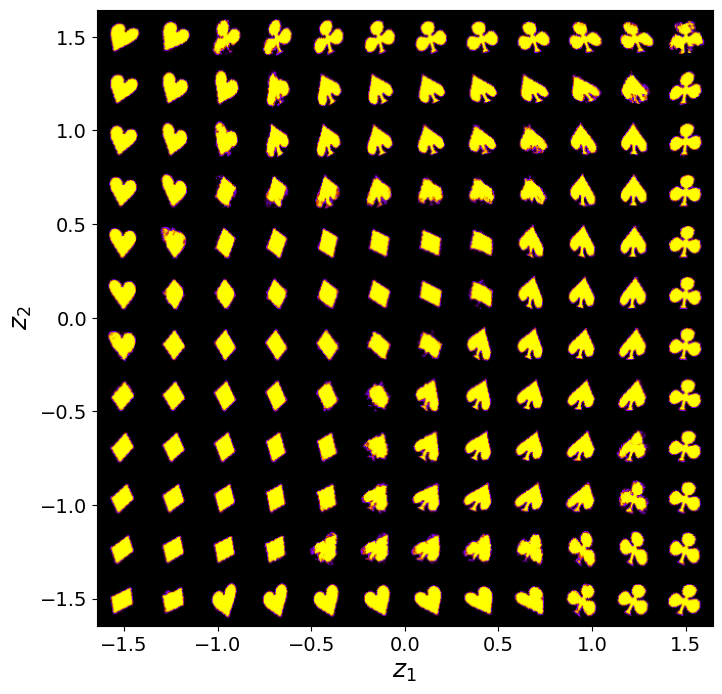

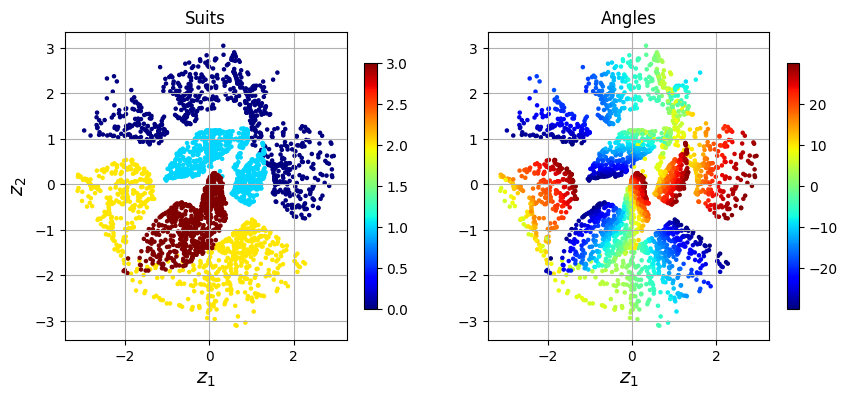

Epoch: 1301 Training loss: 81.6313
Epoch: 1302 Training loss: 81.5387
Epoch: 1303 Training loss: 81.4966
Epoch: 1304 Training loss: 81.5610
Epoch: 1305 Training loss: 81.7747
Epoch: 1306 Training loss: 81.6003
Epoch: 1307 Training loss: 81.5019
Epoch: 1308 Training loss: 81.6189
Epoch: 1309 Training loss: 81.7870
Epoch: 1310 Training loss: 81.8211
Epoch: 1311 Training loss: 81.5982
Epoch: 1312 Training loss: 81.6239
Epoch: 1313 Training loss: 81.4078
Epoch: 1314 Training loss: 81.7394
Epoch: 1315 Training loss: 81.5282
Epoch: 1316 Training loss: 81.5026
Epoch: 1317 Training loss: 81.5735
Epoch: 1318 Training loss: 81.5349
Epoch: 1319 Training loss: 81.7567
Epoch: 1320 Training loss: 81.7726
Epoch: 1321 Training loss: 81.8301
Epoch: 1322 Training loss: 81.6660
Epoch: 1323 Training loss: 81.6271
Epoch: 1324 Training loss: 81.6722
Epoch: 1325 Training loss: 81.5924
Epoch: 1326 Training loss: 81.8905
Epoch: 1327 Training loss: 82.0065
Epoch: 1328 Training loss: 81.7512
Epoch: 1329 Training

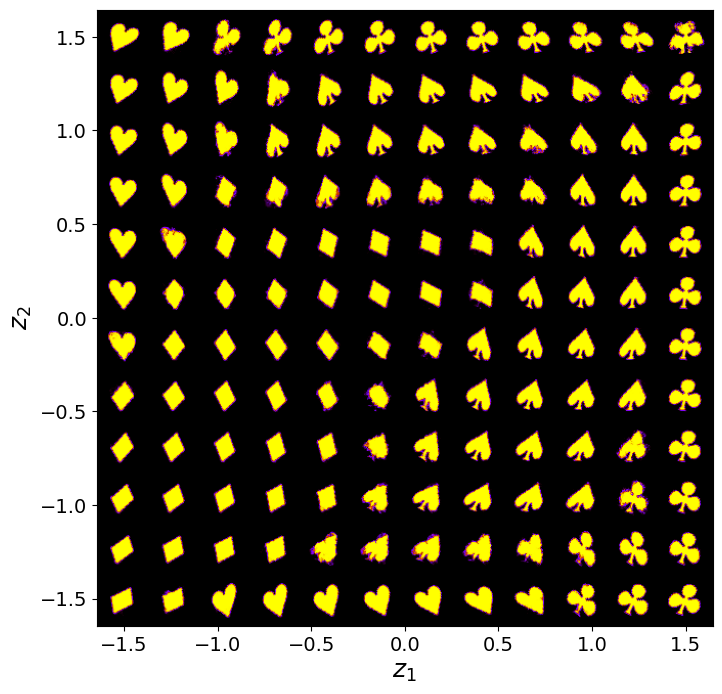

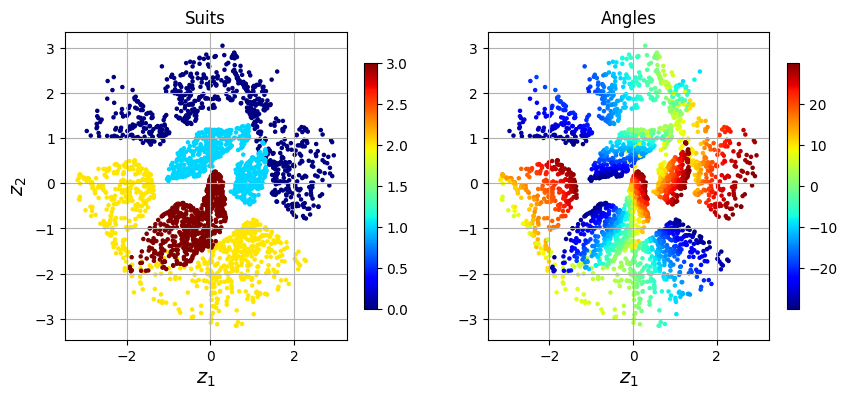

Epoch: 1351 Training loss: 81.8376
Epoch: 1352 Training loss: 81.7205
Epoch: 1353 Training loss: 82.2642
Epoch: 1354 Training loss: 81.7450
Epoch: 1355 Training loss: 81.4494
Epoch: 1356 Training loss: 81.4217
Epoch: 1357 Training loss: 81.4201
Epoch: 1358 Training loss: 81.3477
Epoch: 1359 Training loss: 81.7731
Epoch: 1360 Training loss: 81.7068
Epoch: 1361 Training loss: 81.5092
Epoch: 1362 Training loss: 81.9515
Epoch: 1363 Training loss: 81.6295
Epoch: 1364 Training loss: 81.4949
Epoch: 1365 Training loss: 81.8136
Epoch: 1366 Training loss: 81.7827
Epoch: 1367 Training loss: 81.6077
Epoch: 1368 Training loss: 81.5508
Epoch: 1369 Training loss: 81.4976
Epoch: 1370 Training loss: 81.5703
Epoch: 1371 Training loss: 81.5226
Epoch: 1372 Training loss: 81.5167
Epoch: 1373 Training loss: 81.4976
Epoch: 1374 Training loss: 81.4620
Epoch: 1375 Training loss: 81.4532
Epoch: 1376 Training loss: 81.4356
Epoch: 1377 Training loss: 81.4185
Epoch: 1378 Training loss: 81.5183
Epoch: 1379 Training

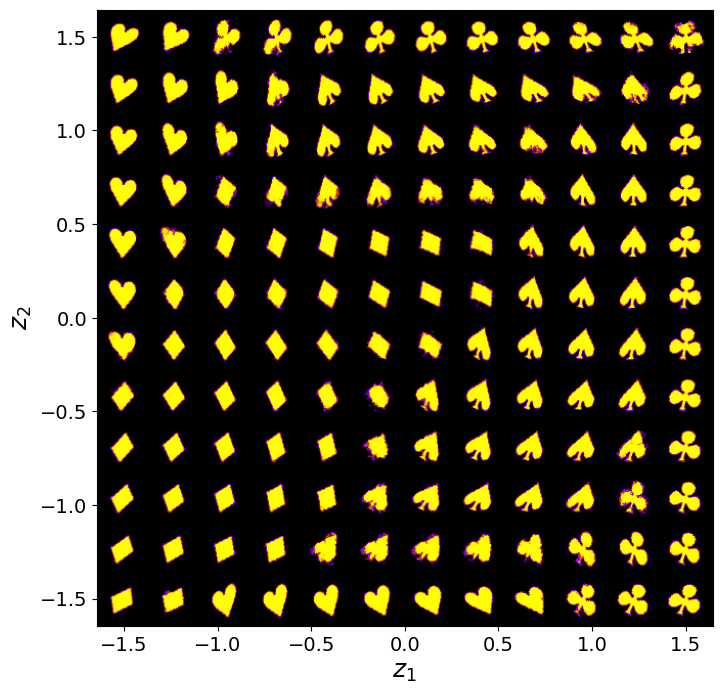

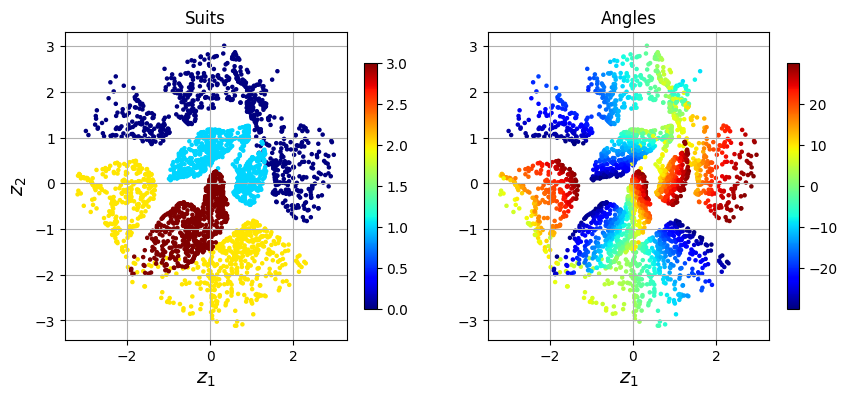

Epoch: 1401 Training loss: 81.2337
Epoch: 1402 Training loss: 81.5845
Epoch: 1403 Training loss: 81.7891
Epoch: 1404 Training loss: 82.0160
Epoch: 1405 Training loss: 81.9696
Epoch: 1406 Training loss: 81.7956
Epoch: 1407 Training loss: 81.5931
Epoch: 1408 Training loss: 81.6410
Epoch: 1409 Training loss: 81.7406
Epoch: 1410 Training loss: 81.6891
Epoch: 1411 Training loss: 81.5111
Epoch: 1412 Training loss: 81.3026
Epoch: 1413 Training loss: 81.5521
Epoch: 1414 Training loss: 81.2564
Epoch: 1415 Training loss: 81.3768
Epoch: 1416 Training loss: 81.3949
Epoch: 1417 Training loss: 81.4063
Epoch: 1418 Training loss: 81.4462
Epoch: 1419 Training loss: 81.5761
Epoch: 1420 Training loss: 81.4676
Epoch: 1421 Training loss: 81.3688
Epoch: 1422 Training loss: 81.4522
Epoch: 1423 Training loss: 81.3442
Epoch: 1424 Training loss: 81.4096
Epoch: 1425 Training loss: 81.5650
Epoch: 1426 Training loss: 81.3713
Epoch: 1427 Training loss: 82.1349
Epoch: 1428 Training loss: 81.6515
Epoch: 1429 Training

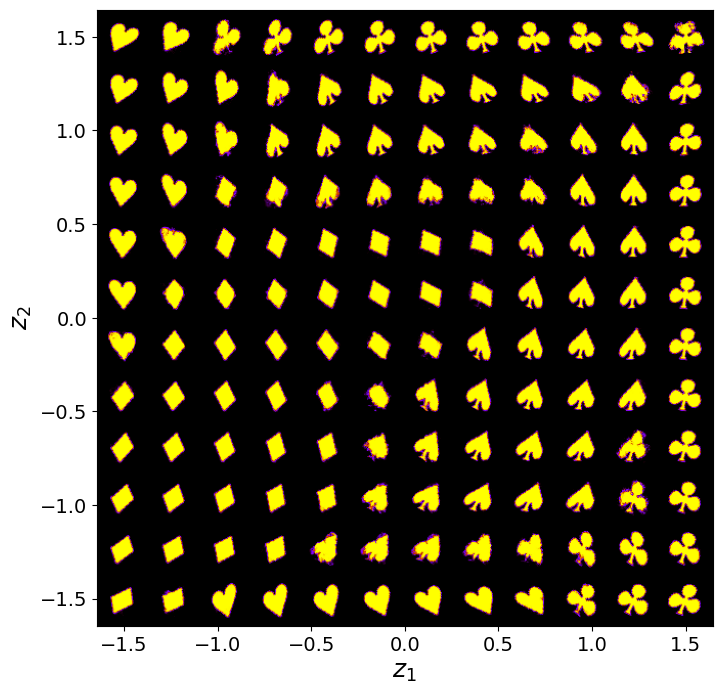

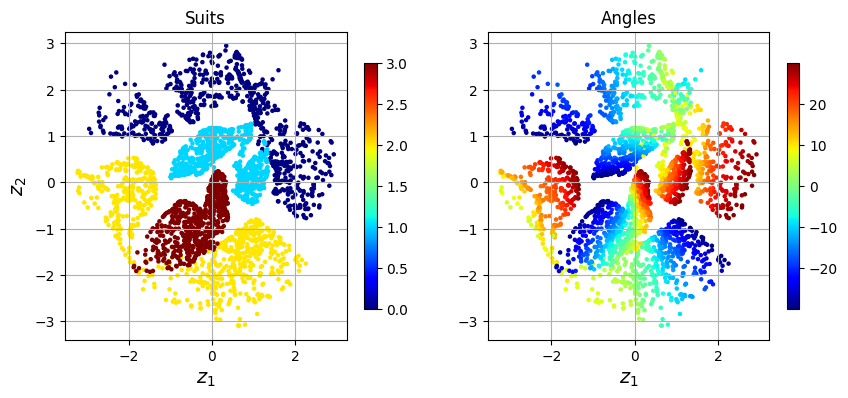

Epoch: 1451 Training loss: 81.3073
Epoch: 1452 Training loss: 81.3319
Epoch: 1453 Training loss: 81.3422
Epoch: 1454 Training loss: 81.3587
Epoch: 1455 Training loss: 81.4094
Epoch: 1456 Training loss: 81.2404
Epoch: 1457 Training loss: 81.3712
Epoch: 1458 Training loss: 81.3975
Epoch: 1459 Training loss: 81.5194
Epoch: 1460 Training loss: 81.4501
Epoch: 1461 Training loss: 81.6009
Epoch: 1462 Training loss: 81.3679
Epoch: 1463 Training loss: 81.3944
Epoch: 1464 Training loss: 81.4093
Epoch: 1465 Training loss: 81.3863
Epoch: 1466 Training loss: 81.4815
Epoch: 1467 Training loss: 81.4017
Epoch: 1468 Training loss: 81.3732
Epoch: 1469 Training loss: 81.4817
Epoch: 1470 Training loss: 81.4100
Epoch: 1471 Training loss: 81.5611
Epoch: 1472 Training loss: 81.7082
Epoch: 1473 Training loss: 81.6341
Epoch: 1474 Training loss: 82.3334
Epoch: 1475 Training loss: 81.7113
Epoch: 1476 Training loss: 81.6101
Epoch: 1477 Training loss: 81.6886
Epoch: 1478 Training loss: 82.2865
Epoch: 1479 Training

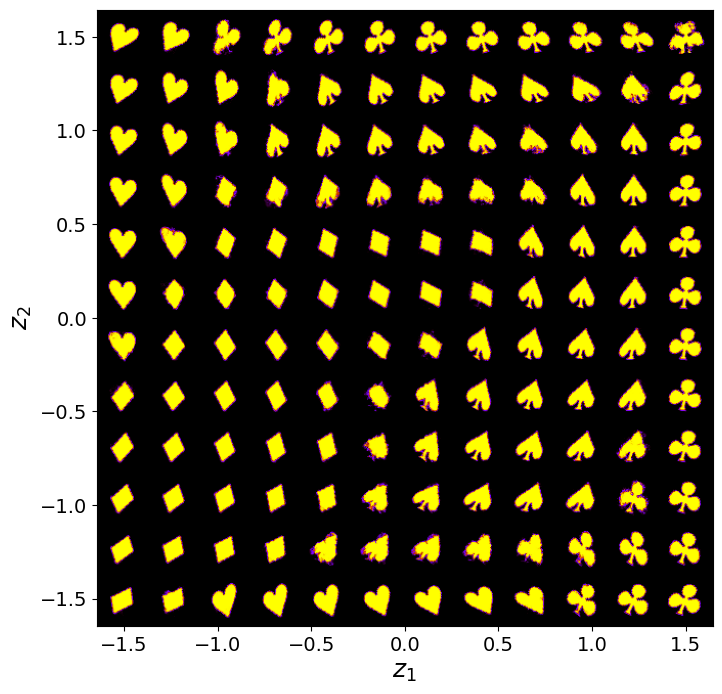

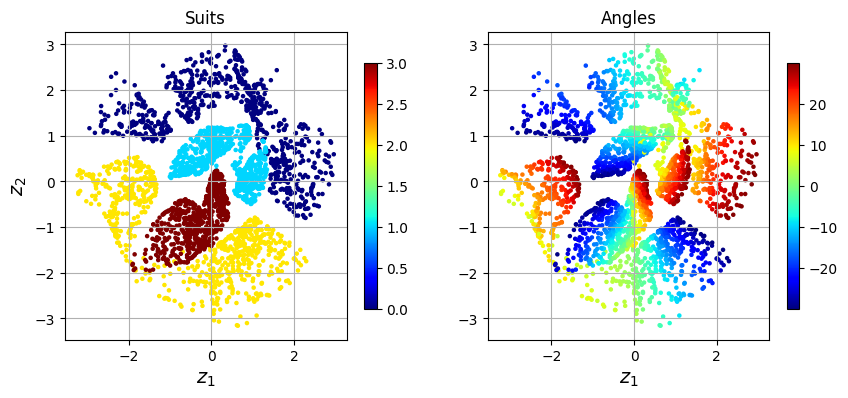

In [26]:
figs = []
for e in range(1500):
    trainer.step(dataloader, train_vae=False)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
        model.manifold2d(d=12)

        z_loc, _ = model.encode(cards_all.reshape(-1, ws* ws))

        fig,ax = plt.subplots(1,2, figsize=(10,4))

        im = ax[0].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=labels_all, cmap='jet')
        cbar = fig.colorbar(im, ax=ax[0], shrink=.8)
        im = ax[1].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=angles_all, cmap='jet')
        cbar = fig.colorbar(im, ax=ax[1], shrink=.8)

        for _ in ax:
          _.set_xlabel('$z_1$', fontsize=14)
          _.grid()

        ax[0].set_title('Suits')
        ax[1].set_title('Angles')
        ax[0].set_ylabel('$z_2$', fontsize=14)

        plt.show()
        figs.append(fig)

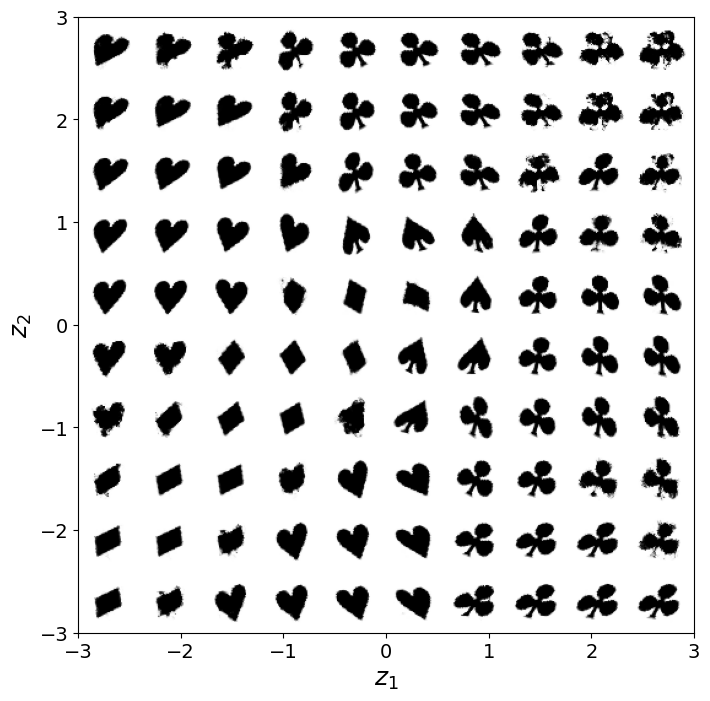

In [27]:
suits = ['♣', '♠', '♥', '♦', ]  # Card suits
z_loc, _ = model.encode(cards_train.reshape(-1, ws* ws))

mf = model.manifold2d(d=10, cmap='binary', z_coord=[-3,3,-3,3], dpi=50)

mf_np = rearrange_manifold(mf)

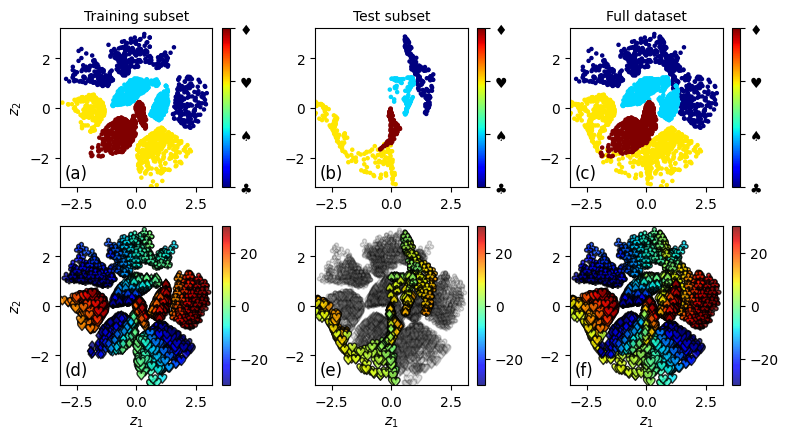

In [28]:
suit_markers = {0: '♣', 1: '♠', 2: '♥', 3: '♦'}
letters = ['a', 'b', 'c', 'd', 'e', 'f']

fig, ax = plt.subplots(2,3, figsize=(8, 4.5))

z_loc, _ = model.encode(cards_train.reshape(-1, ws* ws))

im = ax[0,0].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=labels_train, cmap='jet')
cbar = fig.colorbar(im, ax=ax[0,0])
cbar.set_ticks(np.linspace(0, 3, len(suits)))  # Set positions of labels
cbar.set_ticklabels(suits)
ax[0,0].set_title('Training subset', fontsize=10)
ax[0,1].set_title('Test subset', fontsize=10)

for suit_id, suit_marker in suit_markers.items():
  indices = np.where(labels_train == suit_id)
  scatter = ax[1,0].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),
             label=suit_marker, s=40, alpha=0.8, edgecolors='black',
             marker='$' + suit_marker + '$',
             c = angles_train[indices],
             vmin=-30,
             vmax=30,
             cmap='jet')  # Use Unicode marker as custom text

cbar = fig.colorbar(scatter, ax=ax[1,0])

for suit_id, suit_marker in suit_markers.items():
  indices = np.where(labels_train == suit_id)
  scatter = ax[1,1].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),
             label=suit_marker, s=40, alpha=0.2, edgecolors='black',
             marker='$' + suit_marker + '$',
             c = 'gray',
             )  # Use Unicode marker as custom text


z_loc, _ = model.encode(cards_test.reshape(-1, ws* ws))

im = ax[0,1].scatter(z_loc[:, -2], z_loc[:, -1], s=5, c=labels_test, cmap='jet')
cbar = fig.colorbar(im, ax=ax[0,1])
cbar.set_ticks(np.linspace(0, 3, len(suits)))  # Set positions of labels
cbar.set_ticklabels(suits)

for suit_id, suit_marker in suit_markers.items():
  indices = np.where(labels_test == suit_id)
  scatter = ax[1,1].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),
             label=suit_marker, s=40, alpha=0.8, edgecolors='black',
             marker='$' + suit_marker + '$',
             c = angles_test[indices],
             vmin=-30,
             vmax=30,
             cmap='jet')  # Use Unicode marker as custom text

cbar = fig.colorbar(scatter, ax=ax[1,1])

ax[0,2].set_title('Full dataset', fontsize=10)


z_loc, _ = model.encode(cards_all.reshape(-1, ws* ws))

im = ax[0,2].scatter(z_loc[:, -2], z_loc[:, -1],
                   c=labels_all,
                   cmap='jet',
                   s=5, )

cbar = fig.colorbar(im, ax=ax[0,2])
cbar.set_ticks(np.linspace(0, 3, len(suits)))  # Set positions of labels
cbar.set_ticklabels(suits)

for suit_id, suit_marker in suit_markers.items():
  indices = np.where(labels_all == suit_id)
  scatter = ax[1,2].scatter(z_loc[indices, -2].numpy(), z_loc[indices, -1].numpy(),
             label=suit_marker, s=40, alpha=0.8, edgecolors='black',
             marker='$' + suit_marker + '$',
             c = angles_all[indices],
             vmin=-30,
             vmax=30,
             cmap='jet')  # Use Unicode marker as custom text

cbar = fig.colorbar(scatter, ax=ax[1,2])

for _ in ax.flatten():
  _.set_xlim(-3.2, 3.2)
  _.set_ylim(-3.2, 3.2)

ax[0,0].set_ylabel('$z_2$', fontsize=10)
ax[1,0].set_ylabel('$z_2$', fontsize=10)
ax[1,0].set_xlabel('$z_1$', fontsize=10)
ax[1,1].set_xlabel('$z_1$', fontsize=10)
ax[1,2].set_xlabel('$z_1$', fontsize=10)

plt.tight_layout()

for i, ax_ in enumerate(ax.flatten()):
  ax_.text(-3, -2.8, f'({letters[i]})', fontsize=12)

#fig.savefig('VAE_latent_space_gap.jpg', dpi=300, bbox_inches='tight')